# Cluster spectra from a hiprfish imaging session
## Setup

In [1]:
import glob
import sys
import os
import gc
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import yaml
import re
from collections import defaultdict
import aicspylibczi as aplc
from skimage.registration import phase_cross_correlation
from tqdm import tqdm
from scipy.cluster import hierarchy
from scipy.spatial.distance import squareform, pdist
import umap
import math
from sklearn.cluster import AgglomerativeClustering
from scipy import stats
from sklearn import svm
from sklearn import preprocessing
from sklearn import neighbors as nb



In [3]:
cluster = '/fs/cbsuvlaminck2/'
workdir = '/workdir/bmg224/manuscripts/mgefish/code/bmg_plasmids_imaging/agglomerative_clustering'
os.chdir(cluster + workdir)
os.getcwd()

'/fs/cbsuvlaminck2/workdir/bmg224/manuscripts/mgefish/code/bmg_plasmids_imaging/agglomerative_clustering'

In [248]:
config_fn = "config_240110.yaml"  # relative path to config file from workdir

with open(config_fn, "r") as f:
    config = yaml.safe_load(f)

In [249]:
%load_ext autoreload
%autoreload 2

sys.path.append(cluster + config['pipeline_path'] + '/' + config['functions_path'])
import fn_general_use as fgu
import image_plots as ip
import segmentation_func as sf
import fn_hiprfish_classifier as fhc
import fn_spectral_images as fsi



The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [250]:
# Get filenames from directories
raw_dir = cluster + config["data_dir"] + "/*[0-9y].czi"
# raw_dir = config["data_dir"] + "/*" + config["laser_regex"]
fns = glob.glob(raw_dir)
fns_base = [os.path.split(f)[1] for f in fns]
group_names = [re.sub("_2024\w+.czi", "", s) for s in fns_base]
# print('HERE-->', shifts_fns)
group_names = np.sort(np.unique(group_names))
m_size = group_names.shape[0]
dict_group_czifns_all = defaultdict(list)
for g in group_names:
    for s in fns:
        if g in s:
            dict_group_czifns_all[g].append(s)
dict_group_czifns_all = {g: sorted(s) for g, s in dict_group_czifns_all.items()}
dict_group_czifns_all

{'2024_01_10_bmgshort_slide_bmg_fov_01': ['/fs/cbsuvlaminck2//workdir/Data/bmg224/2024/brc_imaging/2024_01_10_bmgshort/2024_01_10_bmgshort_slide_bmg_fov_01_2024_01_10__18_07_40.czi',
  '/fs/cbsuvlaminck2//workdir/Data/bmg224/2024/brc_imaging/2024_01_10_bmgshort/2024_01_10_bmgshort_slide_bmg_fov_01_2024_01_10__18_10_48.czi',
  '/fs/cbsuvlaminck2//workdir/Data/bmg224/2024/brc_imaging/2024_01_10_bmgshort/2024_01_10_bmgshort_slide_bmg_fov_01_2024_01_10__18_13_55.czi',
  '/fs/cbsuvlaminck2//workdir/Data/bmg224/2024/brc_imaging/2024_01_10_bmgshort/2024_01_10_bmgshort_slide_bmg_fov_01_2024_01_10__18_17_03.czi',
  '/fs/cbsuvlaminck2//workdir/Data/bmg224/2024/brc_imaging/2024_01_10_bmgshort/2024_01_10_bmgshort_slide_bmg_fov_01_2024_01_10__18_17_03_airy.czi',
  '/fs/cbsuvlaminck2//workdir/Data/bmg224/2024/brc_imaging/2024_01_10_bmgshort/2024_01_10_bmgshort_slide_bmg_fov_01_2024_01_10__18_30_12.czi'],
 '2024_01_10_bmgshort_slide_bmg_fov_02': ['/fs/cbsuvlaminck2//workdir/Data/bmg224/2024/brc_imagi

In [251]:
dict_group_czifns = {k: [v[0], v[1], v[2]] for k, v in dict_group_czifns_all.items() if len(v) > 1} 
dict_group_czifns

{'2024_01_10_bmgshort_slide_bmg_fov_01': ['/fs/cbsuvlaminck2//workdir/Data/bmg224/2024/brc_imaging/2024_01_10_bmgshort/2024_01_10_bmgshort_slide_bmg_fov_01_2024_01_10__18_07_40.czi',
  '/fs/cbsuvlaminck2//workdir/Data/bmg224/2024/brc_imaging/2024_01_10_bmgshort/2024_01_10_bmgshort_slide_bmg_fov_01_2024_01_10__18_10_48.czi',
  '/fs/cbsuvlaminck2//workdir/Data/bmg224/2024/brc_imaging/2024_01_10_bmgshort/2024_01_10_bmgshort_slide_bmg_fov_01_2024_01_10__18_13_55.czi'],
 '2024_01_10_bmgshort_slide_bmg_fov_02': ['/fs/cbsuvlaminck2//workdir/Data/bmg224/2024/brc_imaging/2024_01_10_bmgshort/2024_01_10_bmgshort_slide_bmg_fov_02_2024_01_10__18_37_33.czi',
  '/fs/cbsuvlaminck2//workdir/Data/bmg224/2024/brc_imaging/2024_01_10_bmgshort/2024_01_10_bmgshort_slide_bmg_fov_02_2024_01_10__18_40_40.czi',
  '/fs/cbsuvlaminck2//workdir/Data/bmg224/2024/brc_imaging/2024_01_10_bmgshort/2024_01_10_bmgshort_slide_bmg_fov_02_2024_01_10__18_43_47.czi'],
 '2024_01_10_bmgshort_slide_bmg_fov_03': ['/fs/cbsuvlaminck2

## Load data

Get filename lists

In [252]:
stack_fns = {}
props_fns = {}
seg_fns = {}
spec_fns = {}
clust_fns = {}

bn = '{}_M_{}'

for sn in dict_group_czifns.keys():
    output_dir = config['output_dir'] + '/' + sn

    stack_dir = output_dir + '/stacks'
    props_dir = output_dir + '/props'
    segs_dir = output_dir + '/segs'
    spec_dir = output_dir + '/spectra'
    clust_dir = output_dir + '/clust'
    
    bn_ = bn.format(sn,'*')

    stack_fn = stack_dir + '/' + bn_ + '_stack.npy'
    props_fn = props_dir + '/' + bn_ + '_props.csv'
    seg_fn = segs_dir + '/' + bn_ + '_seg.npy'
    spec_fn = spec_dir + '/' + bn_ + '_spec.yaml'
    clust_fn = clust_dir + '/' + bn_ + '_clust.yaml'

    stack_fns[sn] = glob.glob(stack_fn.format('*'))
    props_fns[sn] = glob.glob(props_fn.format('*'))
    seg_fns[sn] = glob.glob(seg_fn.format('*'))
    spec_fns[sn] = glob.glob(spec_fn.format('*'))
    clust_fns[sn] = glob.glob(clust_fn.format('*'))



In [253]:
spec_fns

{'2024_01_10_bmgshort_slide_bmg_fov_01': ['../../../outputs/bmg_plasmids_imaging/2024_01_10_bmgshort/2024_01_10_bmgshort_slide_bmg_fov_01/spectra/2024_01_10_bmgshort_slide_bmg_fov_01_M_0_spec.yaml',
  '../../../outputs/bmg_plasmids_imaging/2024_01_10_bmgshort/2024_01_10_bmgshort_slide_bmg_fov_01/spectra/2024_01_10_bmgshort_slide_bmg_fov_01_M_1_spec.yaml',
  '../../../outputs/bmg_plasmids_imaging/2024_01_10_bmgshort/2024_01_10_bmgshort_slide_bmg_fov_01/spectra/2024_01_10_bmgshort_slide_bmg_fov_01_M_2_spec.yaml',
  '../../../outputs/bmg_plasmids_imaging/2024_01_10_bmgshort/2024_01_10_bmgshort_slide_bmg_fov_01/spectra/2024_01_10_bmgshort_slide_bmg_fov_01_M_3_spec.yaml'],
 '2024_01_10_bmgshort_slide_bmg_fov_02': [],
 '2024_01_10_bmgshort_slide_bmg_fov_03': [],
 '2024_01_10_bmgshort_slide_bmg_fov_04': [],
 '2024_01_10_bmgshort_slide_gfp_fov_01': [],
 '2024_01_10_bmgshort_slide_neg_fov_01': [],
 '2024_01_12_bmgshort_slide_bmg_fov_05': [],
 '2024_01_12_bmgshort_slide_bmg_fov_06': [],
 '2024_0

In [254]:
Ms = {sn:[re.findall('(?<=_M_)\d+', f)[0] for f in fns] for sn, fns in spec_fns.items()}
Ms


{'2024_01_10_bmgshort_slide_bmg_fov_01': ['0', '1', '2', '3'],
 '2024_01_10_bmgshort_slide_bmg_fov_02': [],
 '2024_01_10_bmgshort_slide_bmg_fov_03': [],
 '2024_01_10_bmgshort_slide_bmg_fov_04': [],
 '2024_01_10_bmgshort_slide_gfp_fov_01': [],
 '2024_01_10_bmgshort_slide_neg_fov_01': [],
 '2024_01_12_bmgshort_slide_bmg_fov_05': [],
 '2024_01_12_bmgshort_slide_bmg_fov_06': [],
 '2024_01_12_bmgshort_slide_gfp_fov_05': []}

Get all spectra

In [154]:
specs_arr = []
dict_sn_m_idx_lab = defaultdict(dict)
for sn, s_fns in spec_fns.items():
    # dict_sn_sni[sn] = sn_i
    print(sn)
    ms = Ms[sn]
    for s_fn, m in zip(s_fns, ms):
        # print(s_fn)
        with open(s_fn, 'r') as f:
            dict_lab_spec = yaml.unsafe_load(f)
        print(len(dict_lab_spec))
        labels = list(dict_lab_spec.keys())
        idx = np.arange(len(dict_lab_spec)) + len(specs_arr)
        dict_sn_m_idx_lab[sn][m] = dict(zip(idx,labels))
        specs_arr += [s[None,:] for s in dict_lab_spec.values()]


2024_01_10_bmgshort_slide_bmg_fov_01
5964
5426
6339
6456
2024_01_10_bmgshort_slide_bmg_fov_02
2024_01_10_bmgshort_slide_bmg_fov_03
2024_01_10_bmgshort_slide_bmg_fov_04
2024_01_10_bmgshort_slide_gfp_fov_01
2024_01_10_bmgshort_slide_neg_fov_01


In [155]:
specs_arr = [s[:,:57] for s in specs_arr]
specs_arr = np.vstack(specs_arr)
specs_arr.shape

(24185, 57)

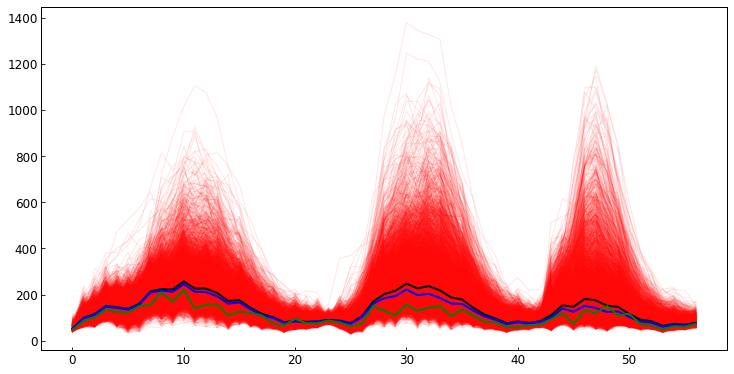

In [156]:
spec_dims = (10,5)

n = 10000  # subsample spectra
idx = np.random.choice(np.arange(specs_arr.shape[0]), size=n, replace=False)
specs_arr_rnd = specs_arr[idx,:]

specs_mean = np.mean(specs_arr, axis=0)
specs_med = np.median(specs_arr, axis=0)
specs_mode = stats.mode(specs_arr, axis=0)[0].squeeze()

fig, ax = ip.general_plot(dims=spec_dims)
fsi.plot_cell_spectra(ax, specs_arr_rnd, {'lw':1,'alpha':0.1,'color':'r'})
fsi.plot_cell_spectra(ax, specs_mean[None,:], {'lw':2,'alpha':1,'color':'k'})
fsi.plot_cell_spectra(ax, specs_med[None,:], {'lw':2,'alpha':1,'color':'b'})
fsi.plot_cell_spectra(ax, specs_mode[None,:], {'lw':2,'alpha':1,'color':'g'})
# ax.set_ylim(0,2**16)
plt.plot()
plt.show()

<AxesSubplot:>

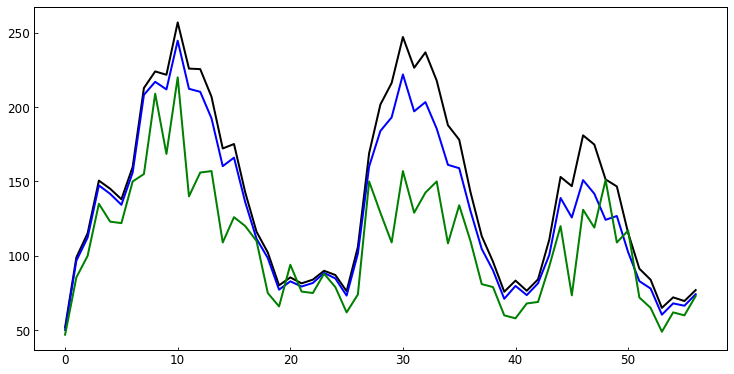

In [157]:
fig, ax = ip.general_plot(dims=spec_dims)
fsi.plot_cell_spectra(ax, specs_mean[None,:], {'lw':2,'alpha':1,'color':'k'})
fsi.plot_cell_spectra(ax, specs_med[None,:], {'lw':2,'alpha':1,'color':'b'})
fsi.plot_cell_spectra(ax, specs_mode[None,:], {'lw':2,'alpha':1,'color':'g'})

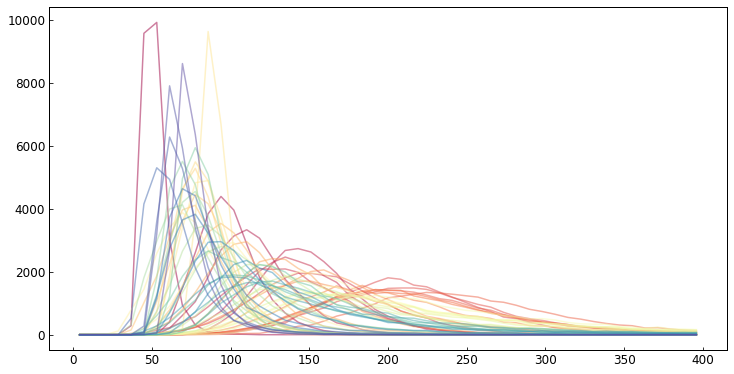

In [158]:
bins = np.linspace(0,400,50)
fig, ax = ip.general_plot(dims=spec_dims)
n_chan = specs_arr.shape[1]
colors = plt.get_cmap('Spectral')(np.linspace(0,1,n_chan))
dict_chan_col = dict(zip(np.arange(n_chan), colors))
for i in range(specs_arr.shape[1]):
    vals = specs_arr[:,i]
    h, e = np.histogram(vals, bins=bins)
    x = [(e[j]+e[j+1])/2 for j in range(len(e)-1)]
    ax.plot(x, h, color=dict_chan_col[i], alpha=0.5)

Get example image

In [121]:
sn='2023_11_22_newplasmid_sample_bmg_fov_03'
m=3

bn_ = bn.format(sn,m)

stack_fn = [fn for fn in stack_fns[sn] if bn_ in fn][0]
props_fn = [fn for fn in props_fns[sn] if bn_ in fn][0]
seg_fn = [fn for fn in seg_fns[sn] if bn_ in fn][0]
spec_fn = [fn for fn in spec_fns[sn] if bn_ in fn][0]

print(stack_fn)
print(props_fn)
print(seg_fn)
print(spec_fn)


../../../outputs/bmg_plasmids_imaging/2023_11_22_newplasmid/agglomerative_cluster/2023_11_22_newplasmid_sample_bmg_fov_03/stacks/2023_11_22_newplasmid_sample_bmg_fov_03_M_3_stack.npy
../../../outputs/bmg_plasmids_imaging/2023_11_22_newplasmid/agglomerative_cluster/2023_11_22_newplasmid_sample_bmg_fov_03/props/2023_11_22_newplasmid_sample_bmg_fov_03_M_3_props.csv
../../../outputs/bmg_plasmids_imaging/2023_11_22_newplasmid/agglomerative_cluster/2023_11_22_newplasmid_sample_bmg_fov_03/segs/2023_11_22_newplasmid_sample_bmg_fov_03_M_3_seg.npy
../../../outputs/bmg_plasmids_imaging/2023_11_22_newplasmid/agglomerative_cluster/2023_11_22_newplasmid_sample_bmg_fov_03/spectra/2023_11_22_newplasmid_sample_bmg_fov_03_M_3_spec.yaml


Props:
Index(['label', 'centroid', 'area', 'max_intensity', 'mean_intensity',
       'min_intensity', 'bbox', 'major_axis_length', 'minor_axis_length',
       'orientation', 'eccentricity', 'perimeter', 'centroid-0', 'centroid-1',
       'bbox-0', 'bbox-1', 'bbox-2', 'bbox-3'],
      dtype='object')
(2180, 18)


(<Figure size 640.636x720 with 1 Axes>, <Axes:>, [[], []])

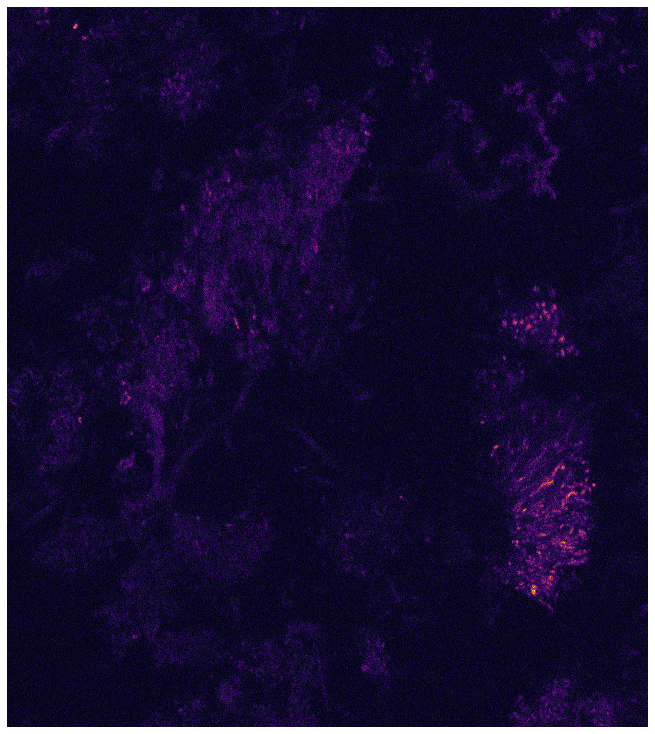

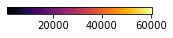

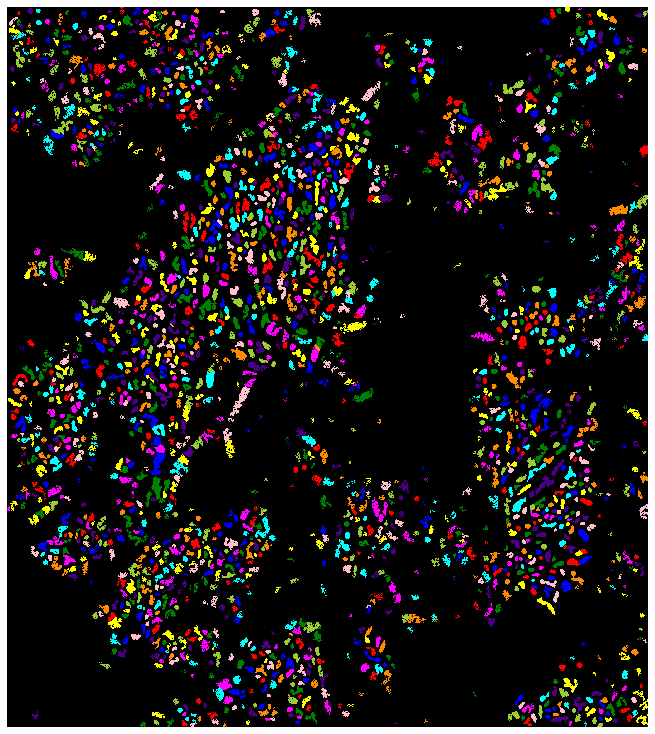

In [14]:
stack = np.load(stack_fn)
props = pd.read_csv(props_fn)
seg = np.load(seg_fn)

print('Props:')
print(props.columns)
print(props.shape)

imin=10

stack_sum = np.sum(stack, axis=2)
ip.plot_image(stack_sum, cmap='inferno', im_inches=imin)
seg_rgb = ip.seg2rgb(seg)
ip.plot_image(seg_rgb, im_inches=imin)

## Cluster spectra 

In [15]:
specs_meansub = specs_arr - specs_mean
specs_meansub[specs_meansub < 0] = 0

dict_idx_spec = {i:s for i, s in enumerate(specs_meansub)}

In [16]:
dist_mat_cond = pdist(specs_meansub, fhc.channel_cosine_intensity_allonev2)

In [17]:
dist_mat_cond.shape

(1268744751,)

In [82]:
# n_cells = len(dict_idx_spec)

# dist_mat = np.zeros((n_cells,n_cells))
# for i, s_i in tqdm(enumerate(dict_idx_spec.values())):
#     s_i_sub = s_i
#     for j, s_j in enumerate(dict_idx_spec.values()):
#         # if j > i:
#         s_j_sub = s_j
#         dist_mat[i,j] = fhc.channel_cosine_intensity_allonev2(s_i_sub, s_j_sub)

50374it [32:09, 26.11it/s]


In [18]:
dist_mat = squareform(dist_mat_cond)


In [19]:
linkage = hierarchy.linkage(dist_mat_cond, method='complete')
# condensed_dist_mat = squareform(dist_mat)
# linkage = hierarchy.linkage(condensed_dist_mat, method='complete')

In [20]:
labels = list(dict_idx_spec.keys())
len(labels)

50374

In [ ]:
fig, ax = ip.general_plot(dims=(15,15))
dn = hierarchy.dendrogram(linkage, labels=labels, truncate_mode=None)
# dn = hierarchy.dendrogram(linkage, labels=inds, truncate_mode='lastp')
# ax.axhline(t[i])
ylims = [round(l,2) for l in ax.get_ylim()]
ax.set_yticks(np.arange(ylims[0],ylims[1],0.005))
ax.grid(axis='y')
plt.show()
plt.close()

In [ ]:
spec_arr_order = []
for l in dn['ivl']:
    s = dict_idx_spec[l]
    spec_arr_order.append(s)
spec_arr_order = np.vstack(spec_arr_order)



fig = plt.figure(figsize=(15,5))
axs = {
    0: fig.add_axes([0.1,0.1,0.1,0.8]),
    1: fig.add_axes([0.2,0.1,0.7,0.8])
}
hierarchy.dendrogram(linkage, ax=axs[0], labels=labels, orientation='left', no_labels=True, truncate_mode=None)
axs[1].imshow(np.flip(spec_arr_order, axis=0), cmap='inferno', aspect='auto')
axs[1].axis('off')
axs[0].axis('off')
plt.show()
plt.close()

/home/bmg224/miniconda3/envs/hiprfish_imaging_py38/lib/python3.8/site-packages/umap/umap_.py:1780: UserWarning: using precomputed metric; inverse_transform will be unavailable
  warn("using precomputed metric; inverse_transform will be unavailable")


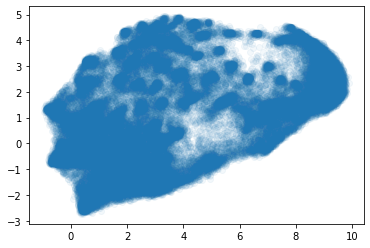

In [70]:
fit = umap.UMAP(metric='precomputed', n_neighbors=100, min_dist=0.1).fit(dist_mat)
u = fit.embedding_
plt.scatter(u[:,0], u[:,1], alpha=0.05)
plt.show()
plt.close()

In [22]:
heatmap, xedges, yedges = np.histogram2d(u[:,0], u[:,1], bins=75)

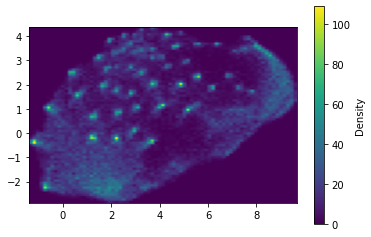

In [23]:
plt.imshow(heatmap.T, extent=[xedges.min(), xedges.max(), yedges.min(), yedges.max()], origin='lower', cmap='viridis')
plt.colorbar(label='Density')

In [30]:
idx_sni = np.zeros(dist_mat.shape[0])
sni = 1
for sn, dmil in dict_sn_m_idx_lab.items():
    for m, dil in dmil.items():
        for idx, lab in dil.items():
            idx_sni[idx] = sni
    sni += 1

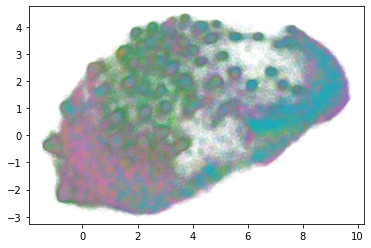

In [33]:
plt.scatter(u[:,0], u[:,1], c=idx_sni, alpha=0.05, cmap='tab10')
plt.show()
plt.close()

1.0


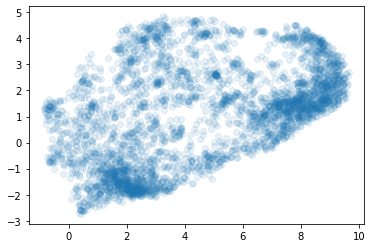

2.0


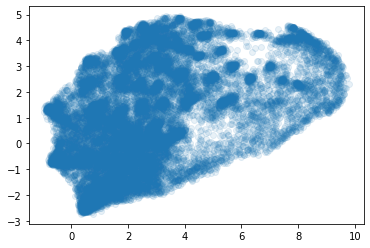

3.0


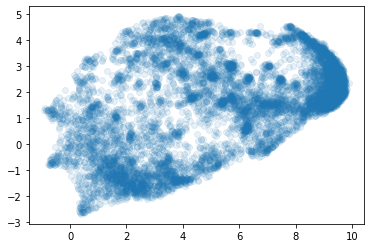

4.0


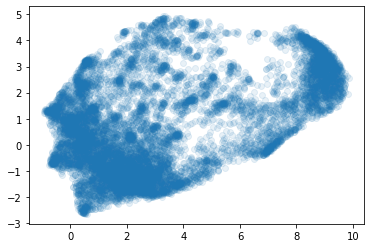

5.0


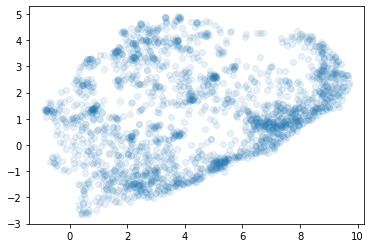

6.0


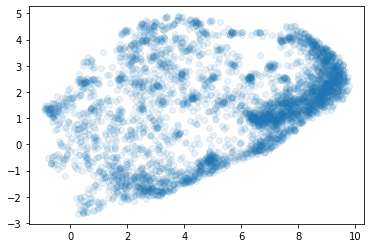

In [122]:
for sni in np.unique(idx_sni):
    print(sni)
    bool_sni = idx_sni == sni
    u_ = u[bool_sni,:]
    plt.scatter(u_[:,0], u_[:,1], alpha=0.1)
    plt.show()
    plt.close()

In [24]:
n_clust = 40
agg = AgglomerativeClustering(n_clusters=n_clust, affinity='precomputed', linkage='complete')

agg.fit(dist_mat)

clust_agg = agg.labels_

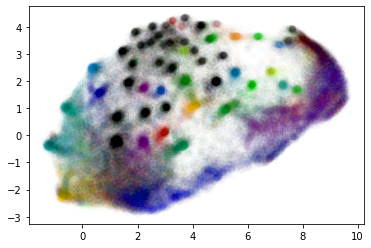

In [51]:
plt.scatter(u[:,0], u[:,1], c=clust_agg, alpha=0.01, cmap='nipy_spectral')
plt.show()
plt.close()

In [107]:
clust_agg_sn = clust_agg[list(dict_sn_m_idx_lab[sn][m].keys())]
labels_sn = np.array(list(dict_sn_m_idx_lab[sn][m].values()))
dict_lab_clust = dict(zip(labels_sn,clust_agg_sn))
len(dict_lab_clust)

3991

In [108]:
n_clust = np.max(clust_agg) + 1
colors = plt.get_cmap('nipy_spectral')(np.linspace(0,1,n_clust))
dict_clust_col = dict(zip(np.arange(n_clust), colors))

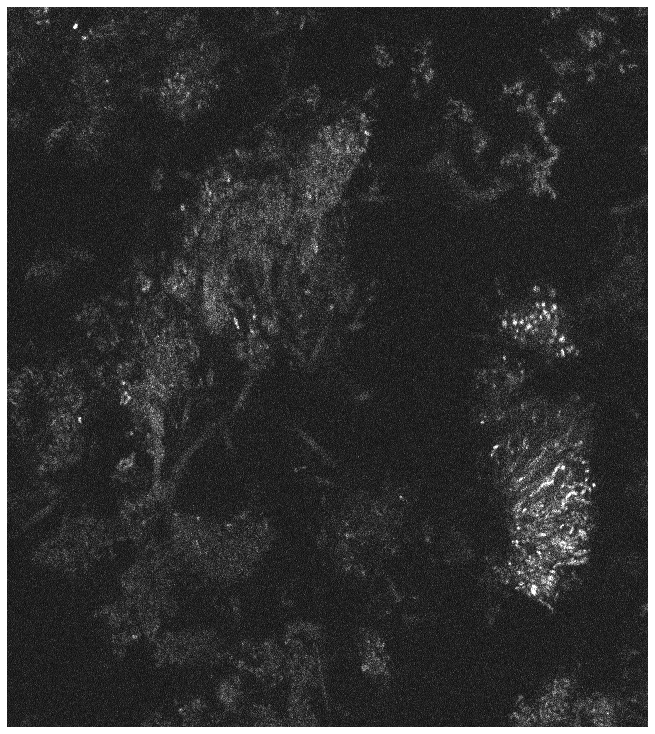

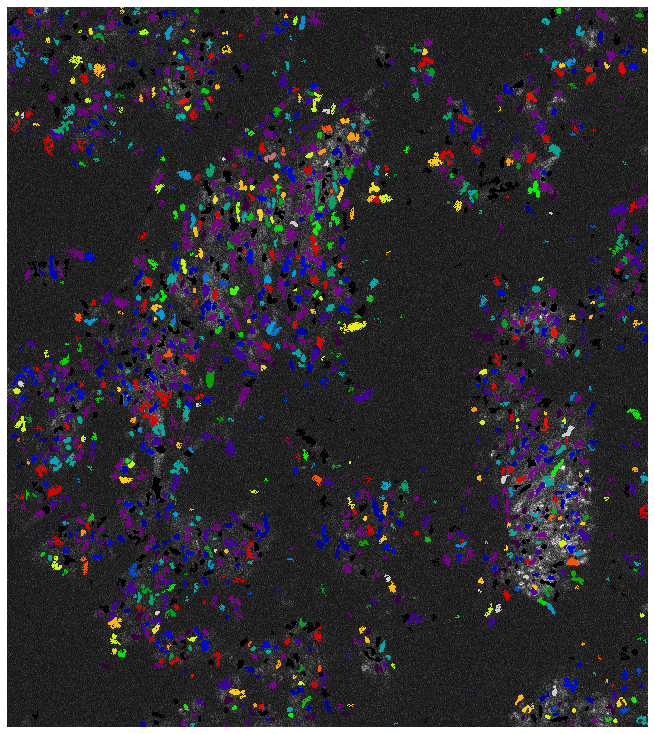

In [109]:
mx = np.max(stack_sum)*0.5
# mx = 60000
mn = np.min(stack_sum)
im_norm = np.clip(stack_sum,mn,mx)
im_norm = (im_norm - mn) / (mx - mn)
im_rgb = im_norm[:,:,None] * np.array([1,1,1])[None,:]
im_rgb = np.dstack([im_rgb, np.ones(im_rgb.shape[:2])])
fig, ax, _ = ip.plot_image(im_rgb, im_inches=10)
plt.show()
plt.close()

for i, row in props.iterrows():
    l = row.label
    if l in labels_sn:
        b = row.bbox
        b = eval(b) if isinstance(b, str) else b
        rgb_sub = im_rgb[b[0]:b[2],b[1]:b[3]]
        seg_sub = seg[b[0]:b[2],b[1]:b[3]] == l
        im_sub = im_norm[b[0]:b[2],b[1]:b[3]]
        cl = dict_lab_clust[l]
        color = np.array(dict_clust_col[cl])
        # rgb_noncell =  rgb_sub * np.dstack([~seg_sub]*3 + np.ones_like(seg_sub))
        rgb_noncell =  rgb_sub * np.dstack([~seg_sub]*4)
        # rgb_cell = (im_sub * seg_sub)[:,:,None] * color[None,:]
        rgb_cell = seg_sub[:,:,None] * color[None,:]
        im_rgb[b[0]:b[2],b[1]:b[3],:] = rgb_noncell + rgb_cell

fig, ax, cbar = ip.plot_image(im_rgb, im_inches=10)

Try hdbscan clustering on the umap

In [62]:
import hdbscan
hdb = hdbscan.HDBSCAN(min_cluster_size=5, metric='precomputed')

hdb.fit(dist_mat)

clust_hdb = hdb.labels_

np.unique(clust_hdb)

array([-1,  0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15,
       16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32,
       33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49,
       50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66])

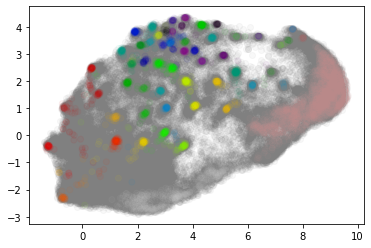

In [63]:
u_ = u[clust_hdb > -1,:]
u_i = u[clust_hdb == -1,:]


plt.scatter(u_i[:,0], u_i[:,1], color=[0.5,0.5,0.5], alpha=0.05)
plt.scatter(u_[:,0], u_[:,1], c=clust_hdb[clust_hdb > -1], alpha=0.05, cmap='nipy_spectral')
plt.show()
plt.close()

Cluster: 0


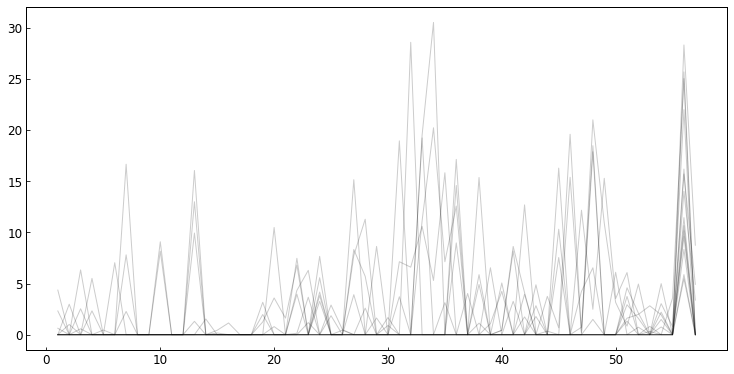

Cluster: 1


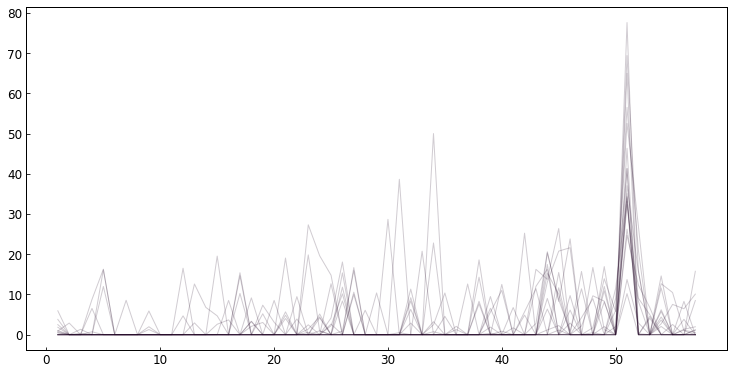

Cluster: 2


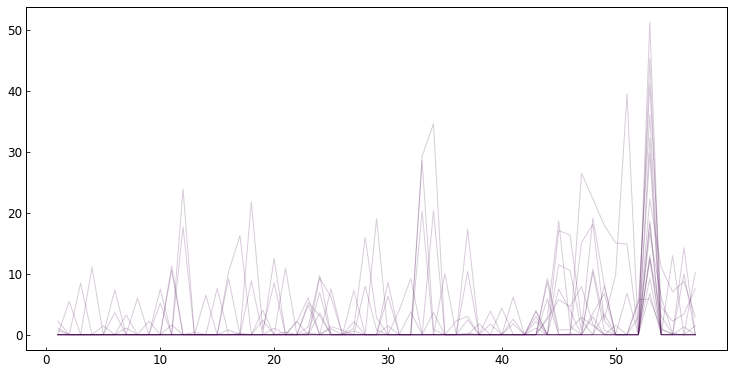

Cluster: 3


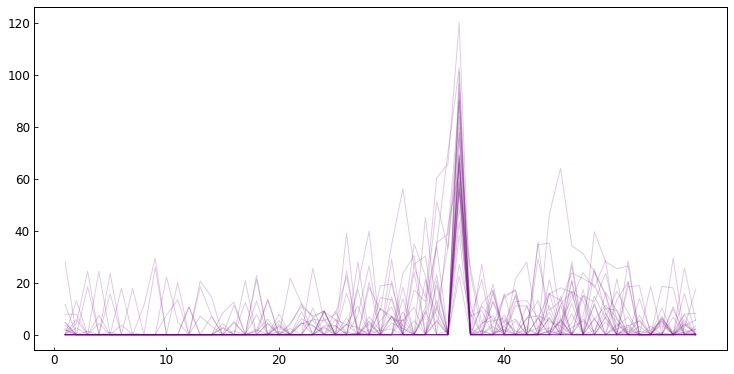

Cluster: 4


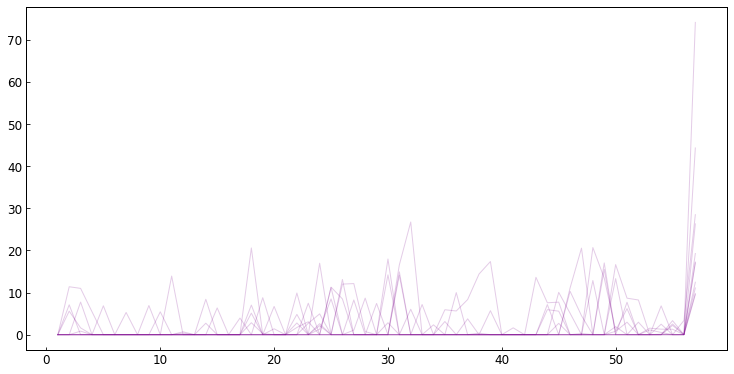

Cluster: 5


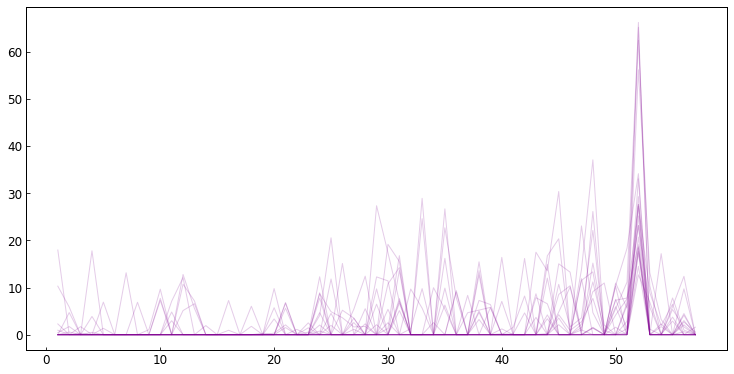

Cluster: 6


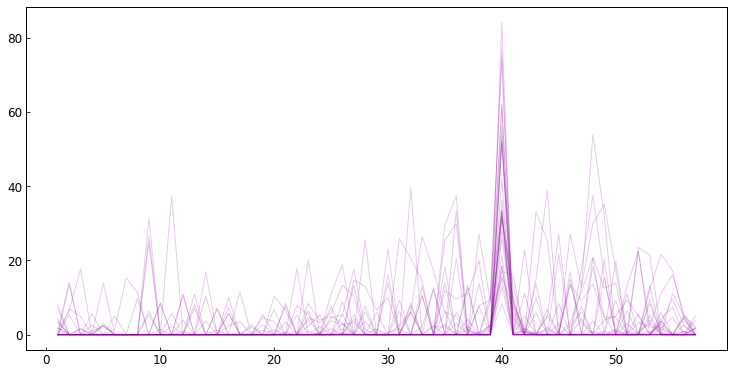

Cluster: 7


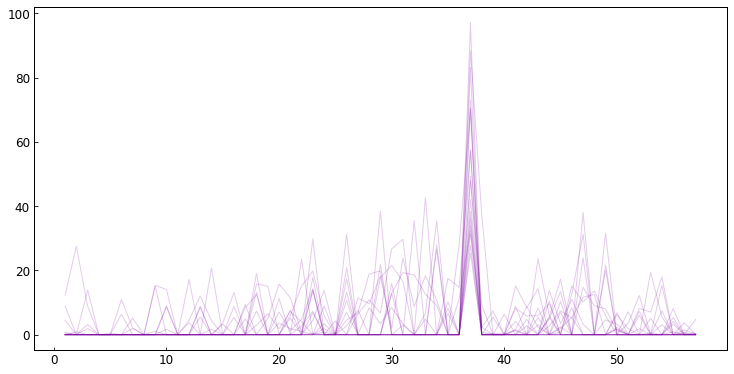

Cluster: 8


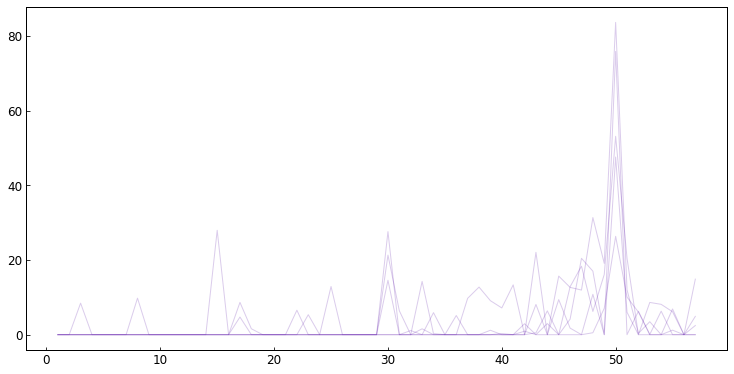

Cluster: 9


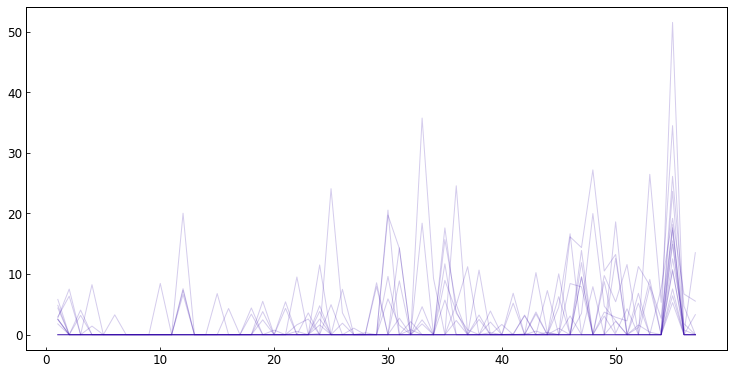

Cluster: 10


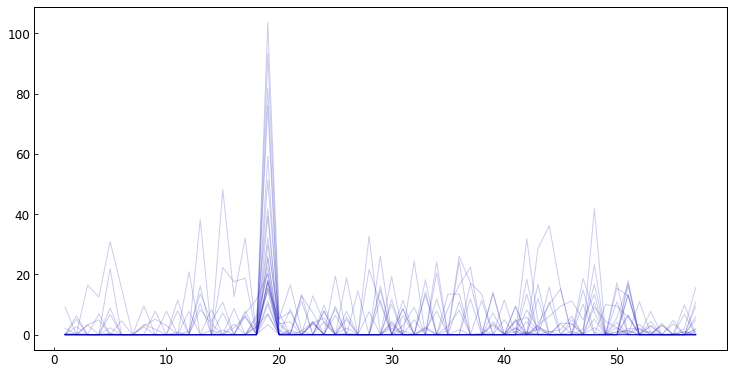

Cluster: 11


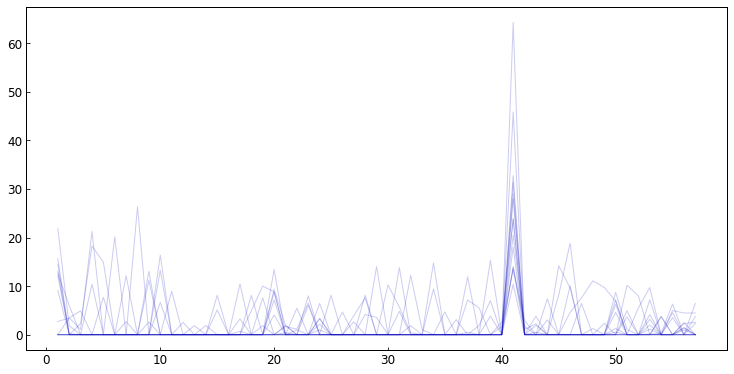

Cluster: 12


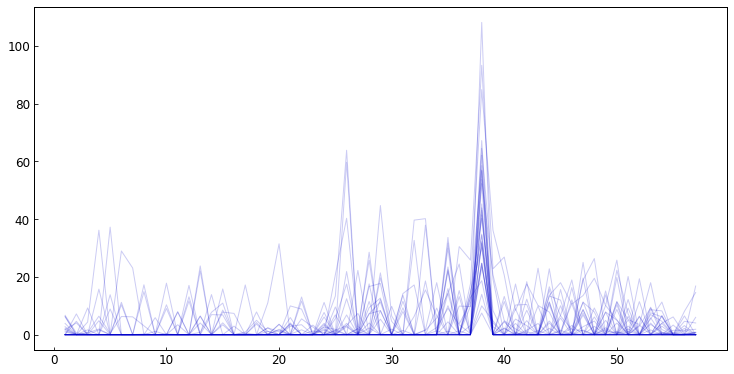

Cluster: 13


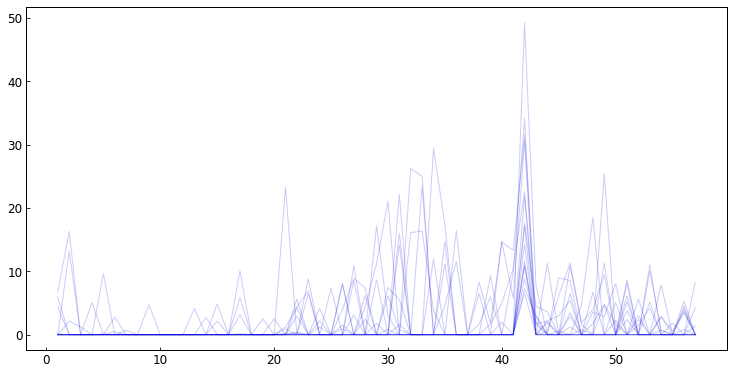

Cluster: 14


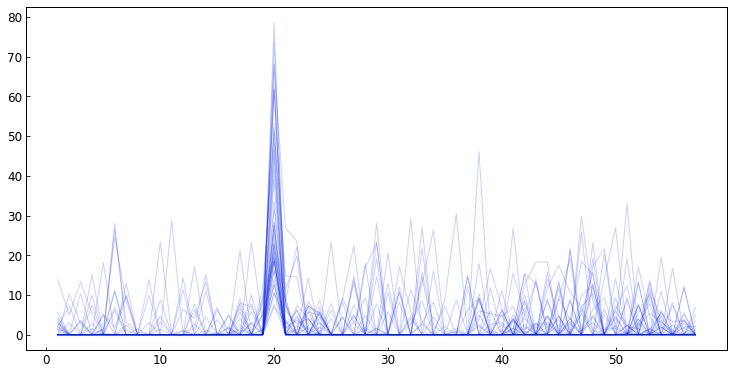

Cluster: 15


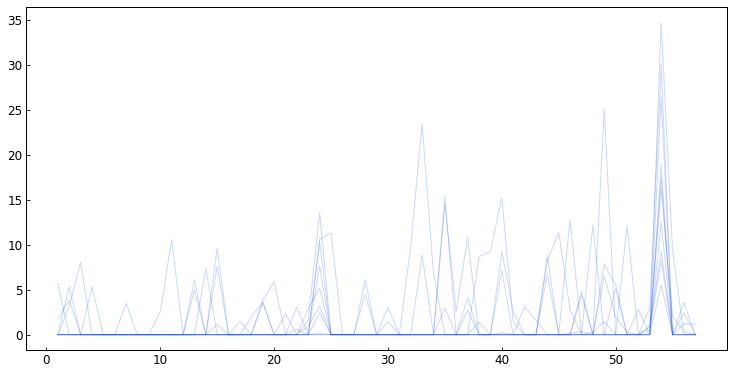

Cluster: 16


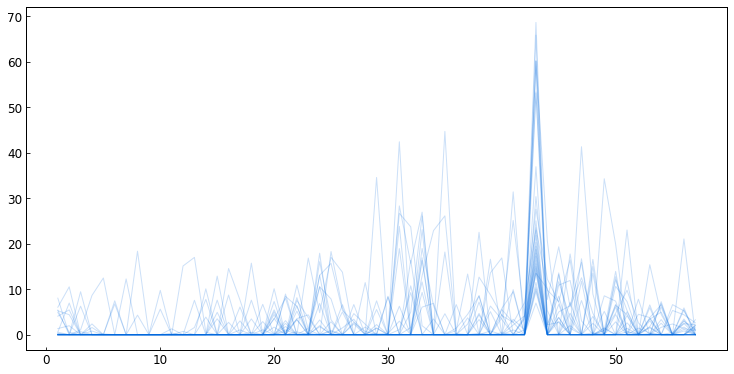

Cluster: 17


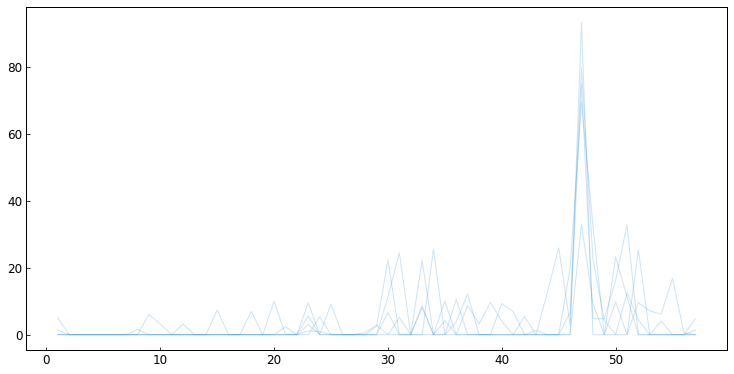

Cluster: 18


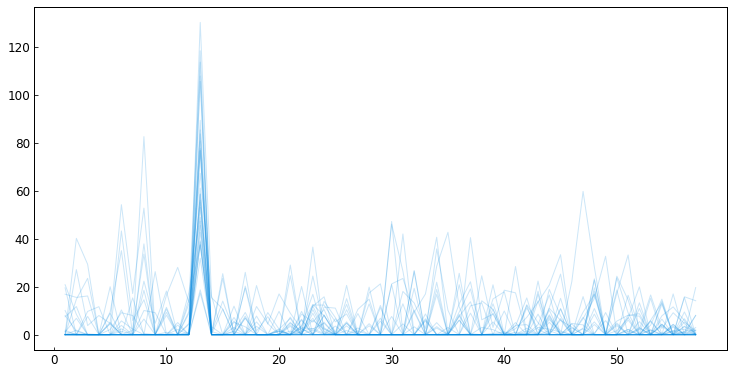

Cluster: 19


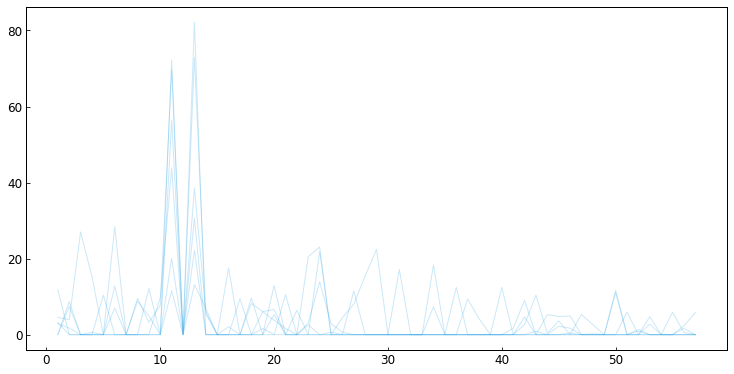

Cluster: 20


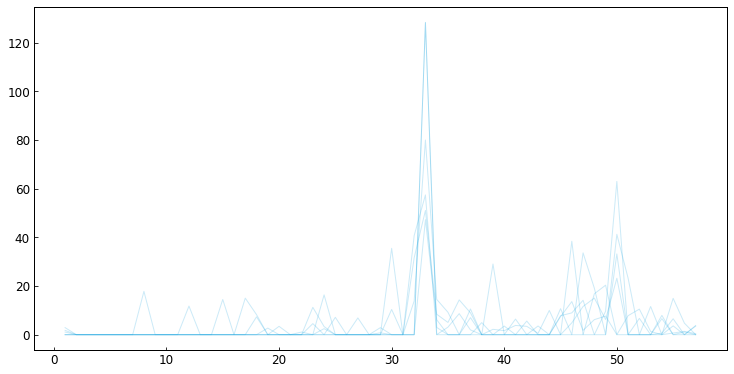

Cluster: 21


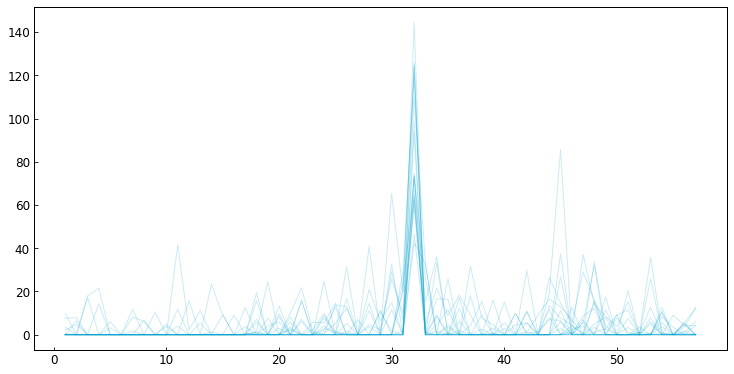

Cluster: 22


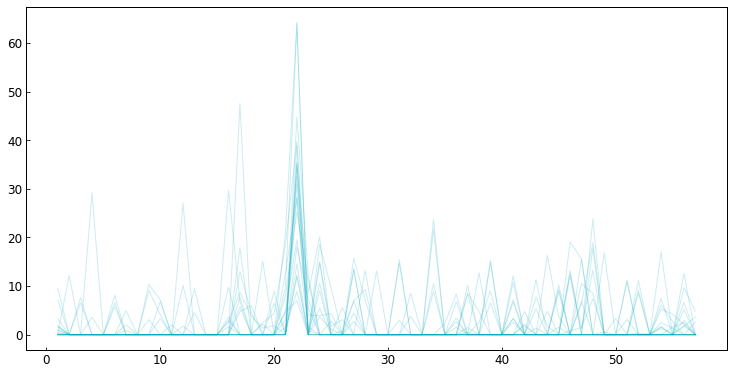

Cluster: 23


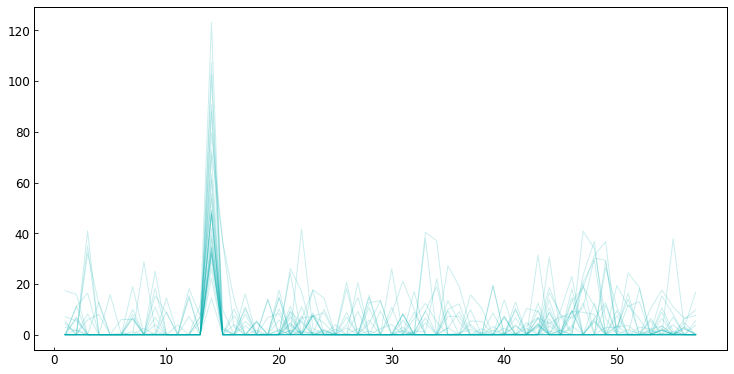

Cluster: 24


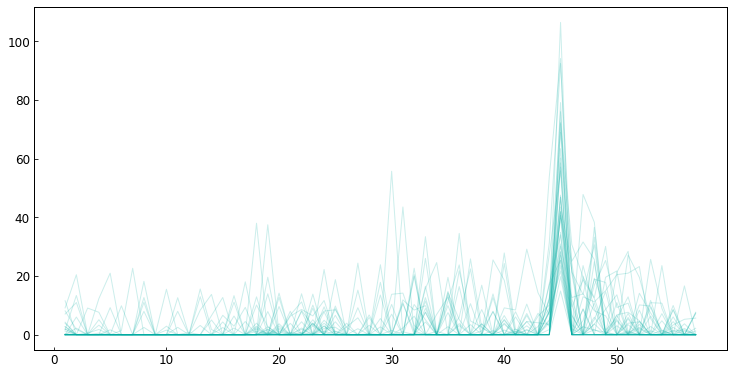

Cluster: 25


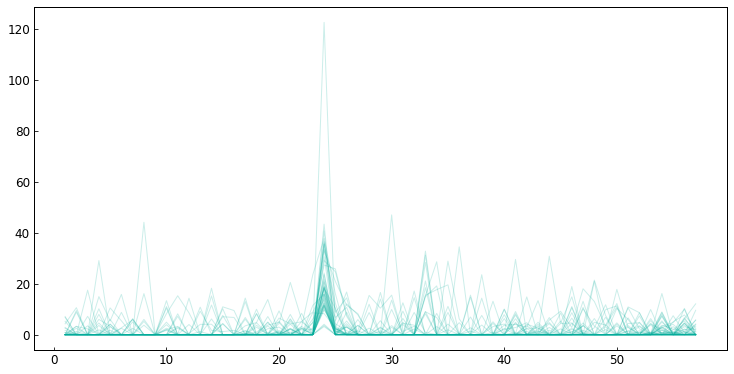

Cluster: 26


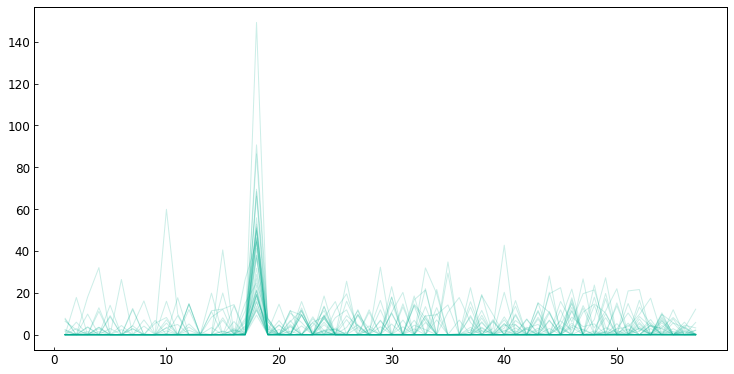

Cluster: 27


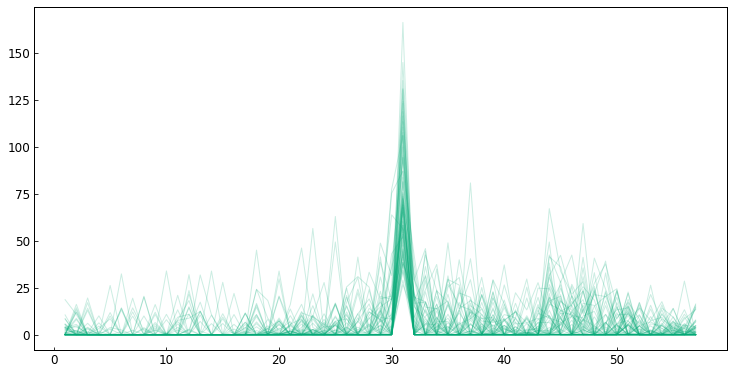

Cluster: 28


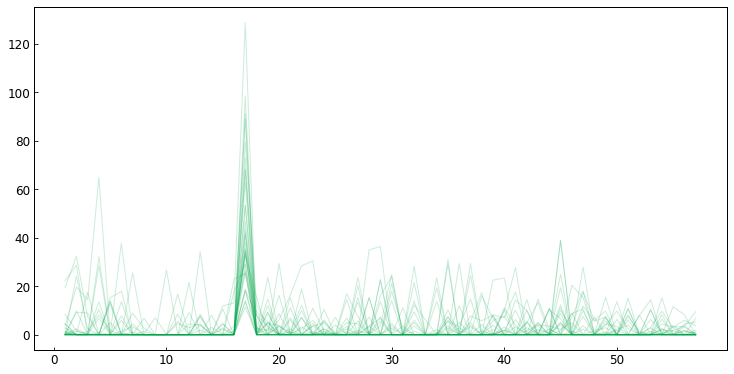

Cluster: 29


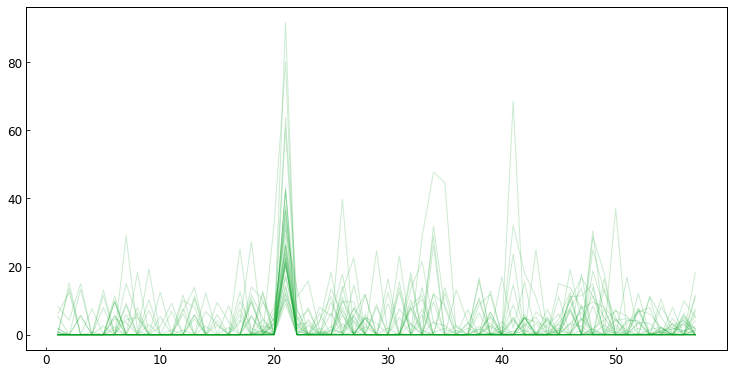

Cluster: 30


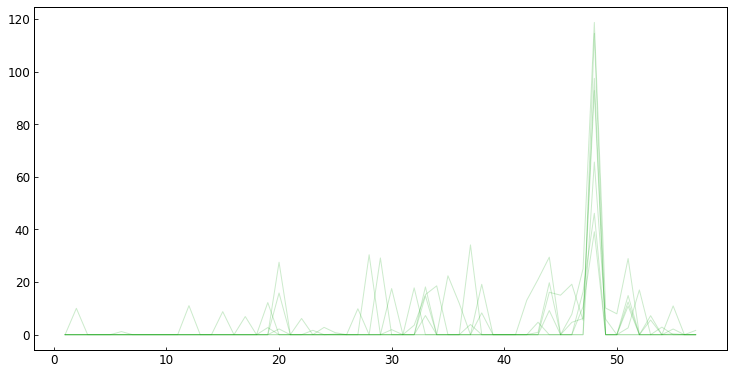

Cluster: 31


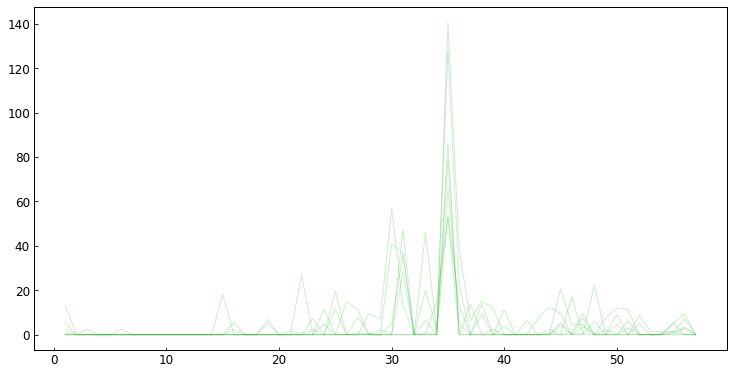

Cluster: 32


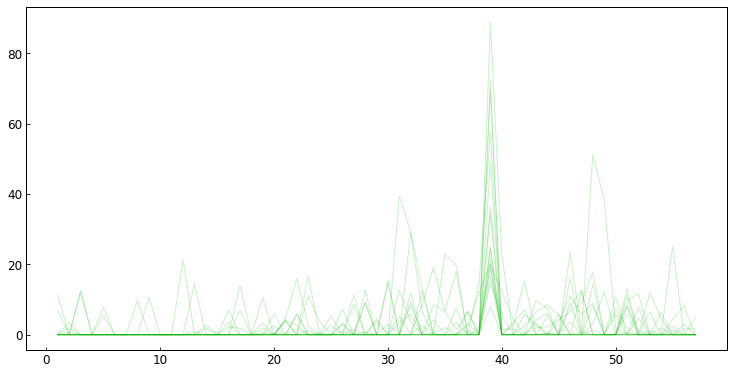

Cluster: 33


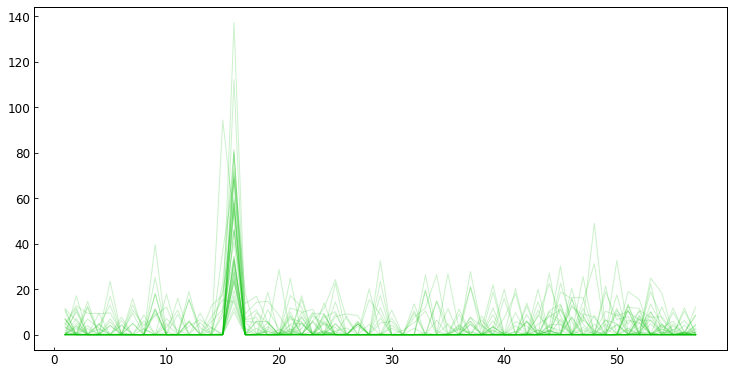

Cluster: 34


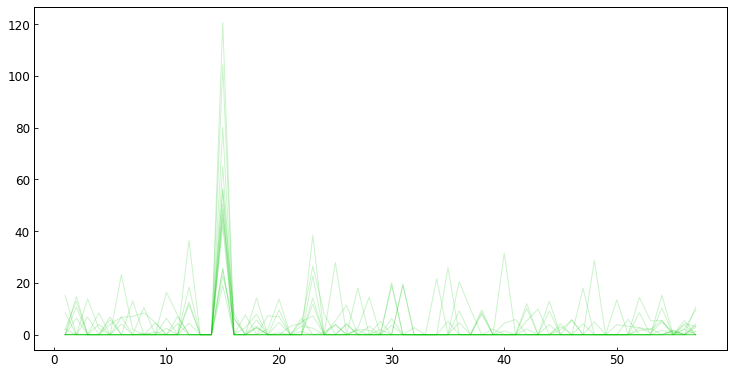

Cluster: 35


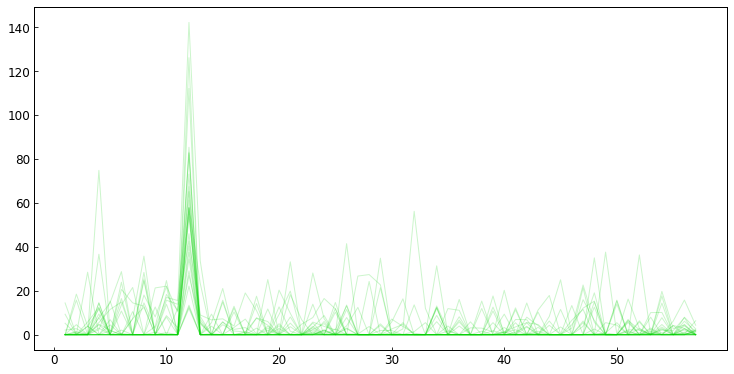

Cluster: 36


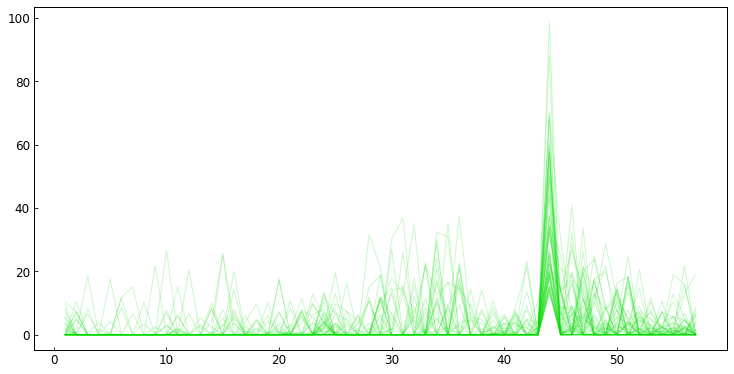

Cluster: 37


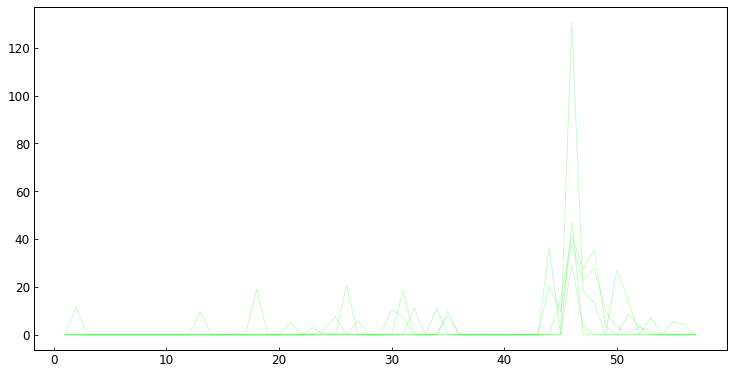

Cluster: 38


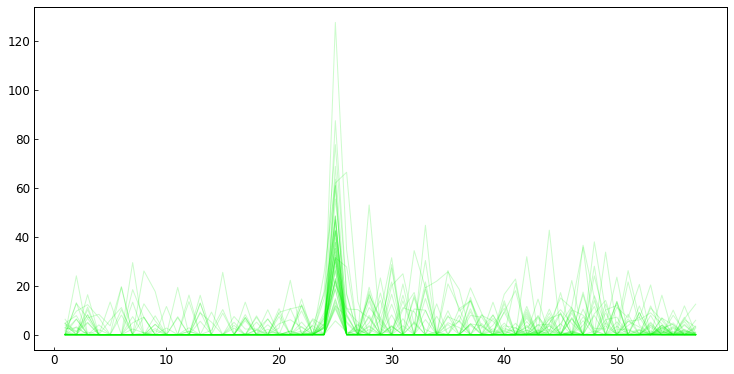

Cluster: 39


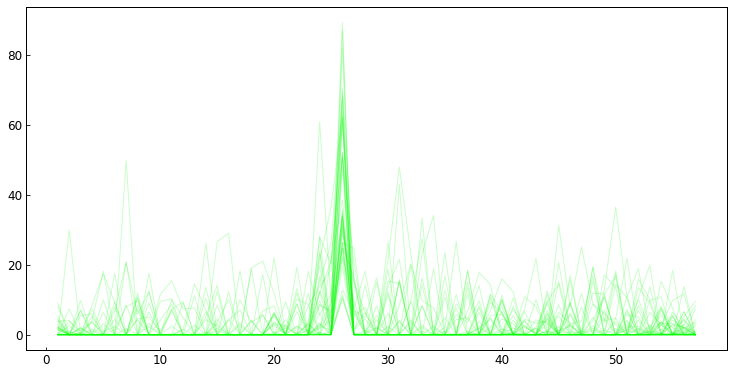

Cluster: 40


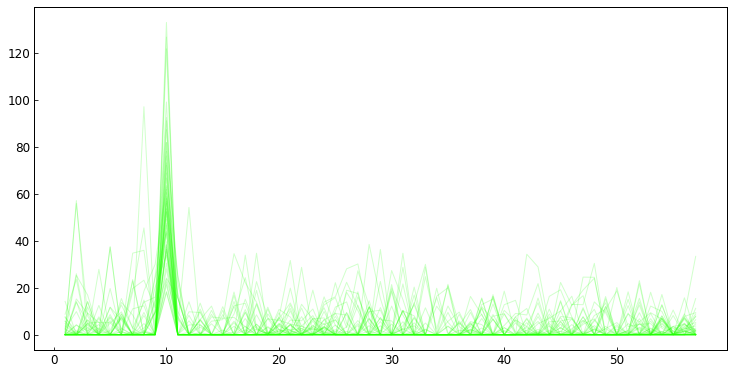

Cluster: 41


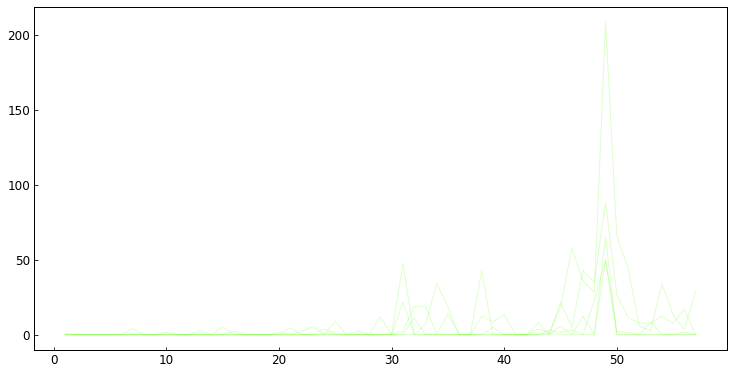

Cluster: 42


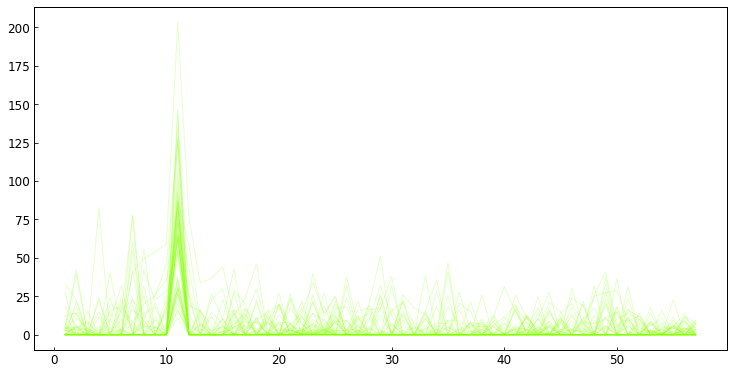

Cluster: 43


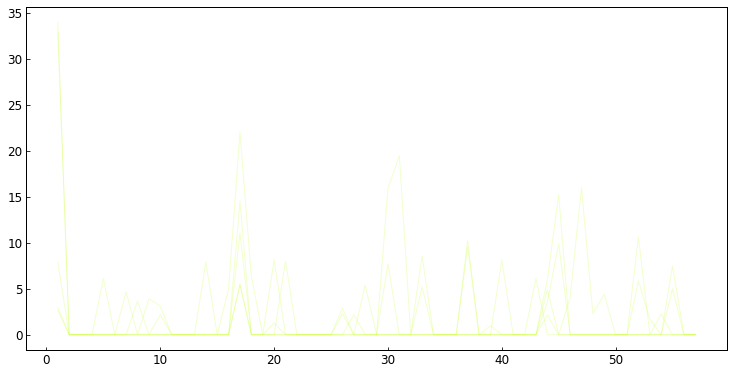

Cluster: 44


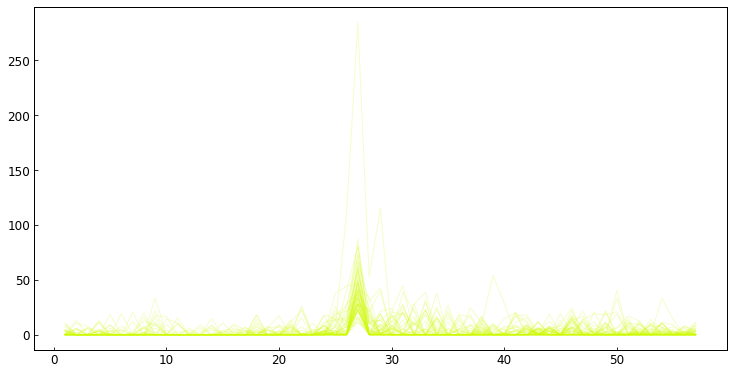

Cluster: 45


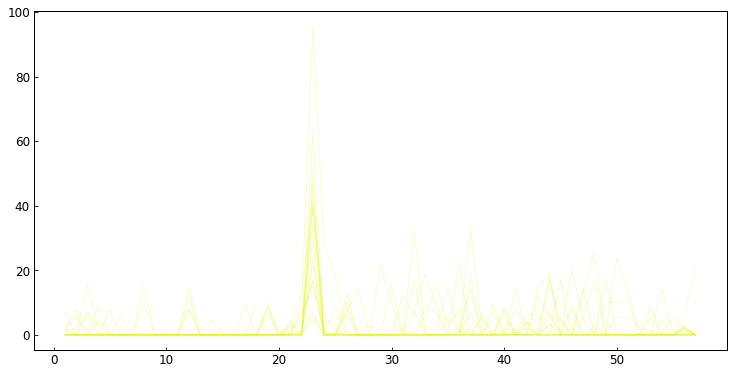

Cluster: 46


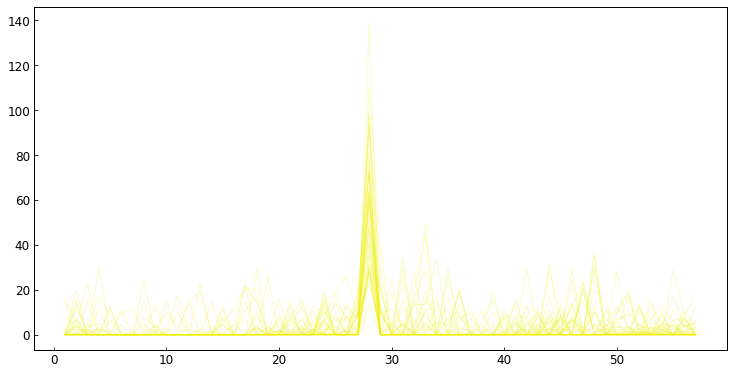

Cluster: 47


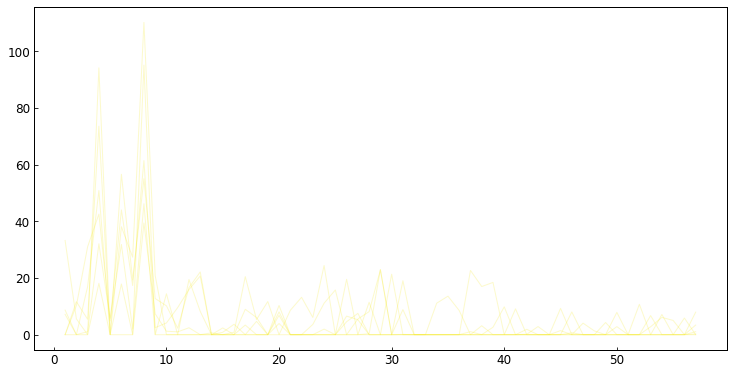

Cluster: 48


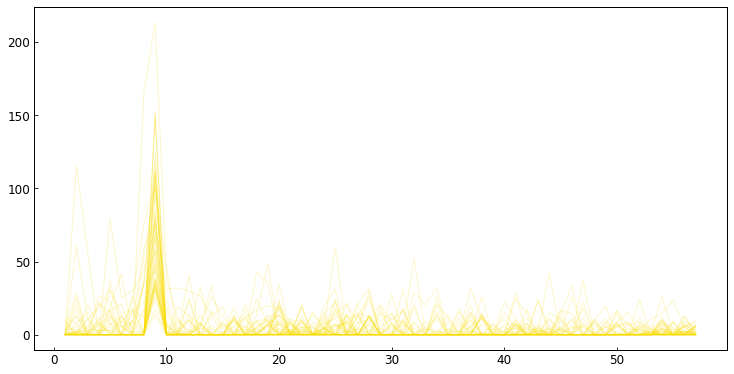

Cluster: 49


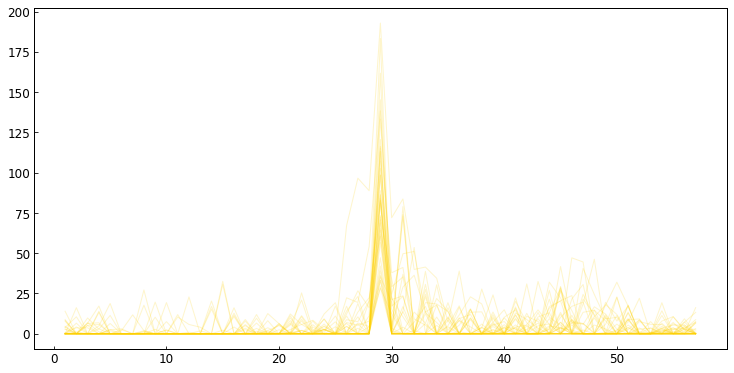

Cluster: 50


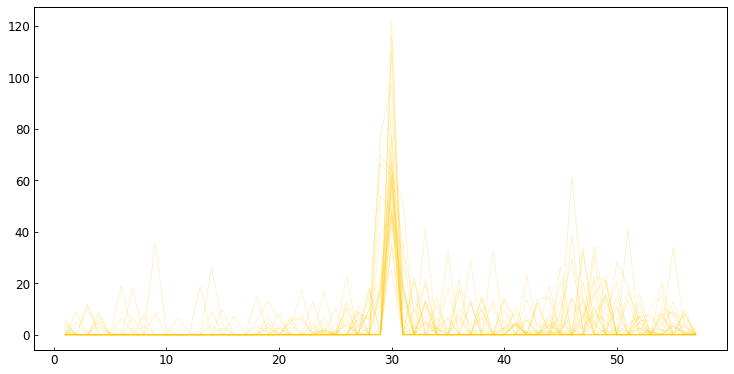

Cluster: 51


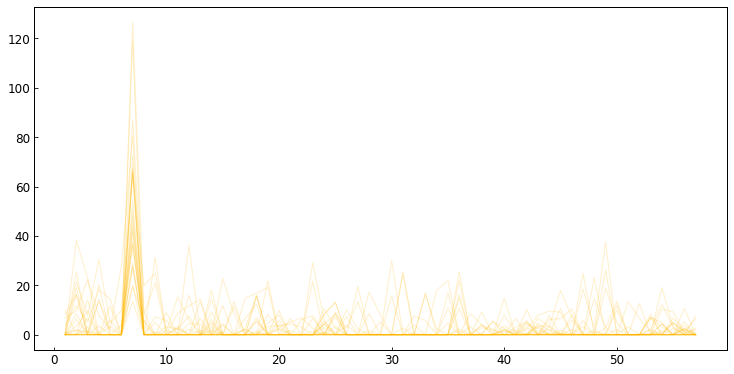

Cluster: 52


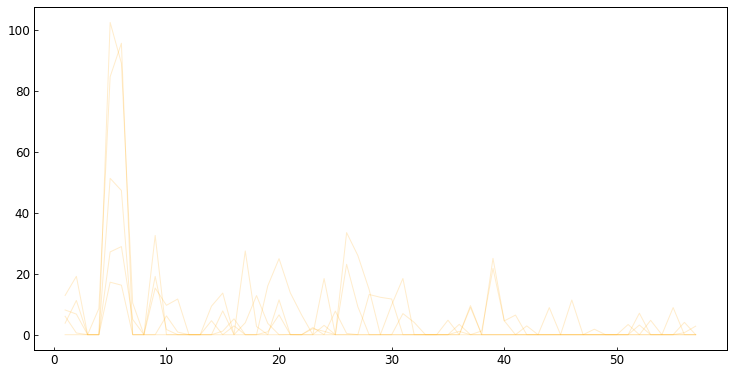

Cluster: 53


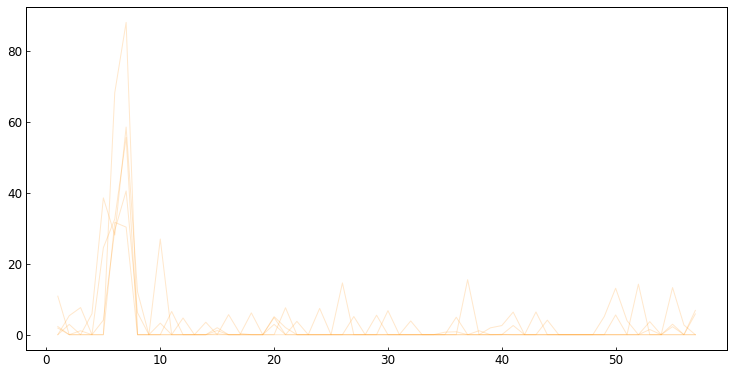

Cluster: 54


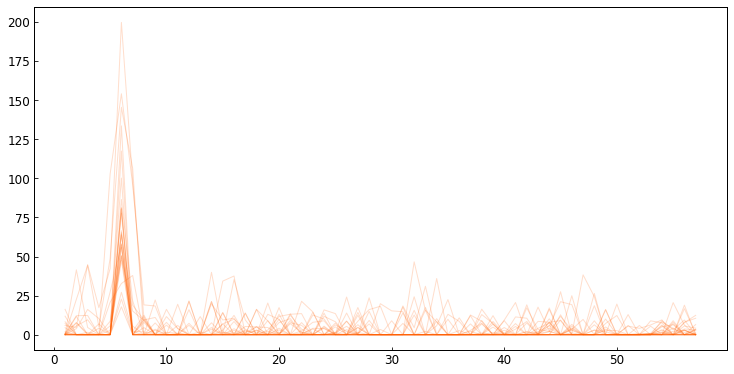

Cluster: 55


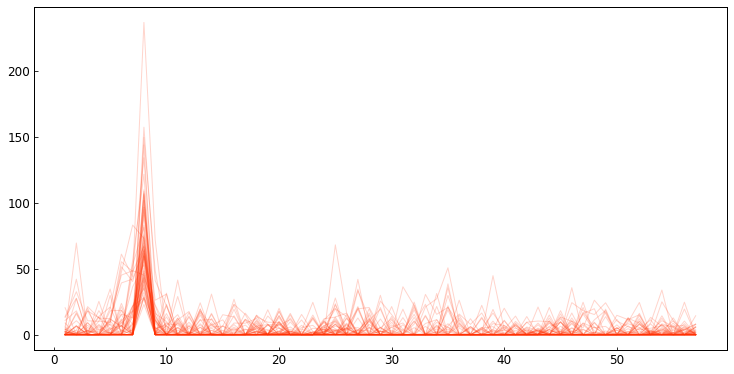

Cluster: 56


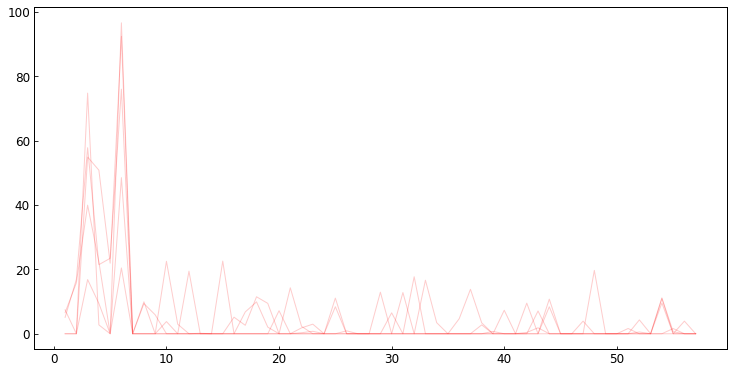

Cluster: 57


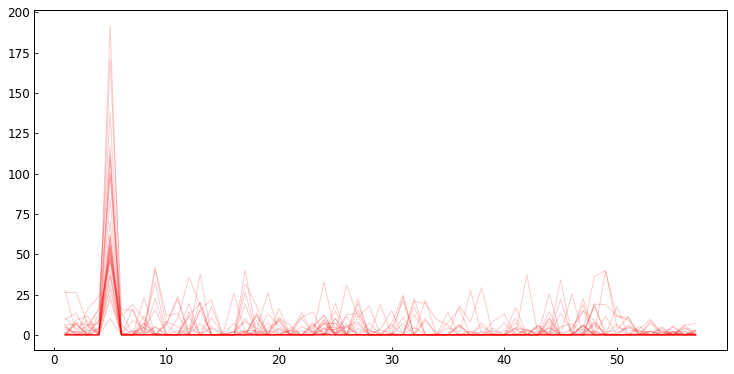

Cluster: 58


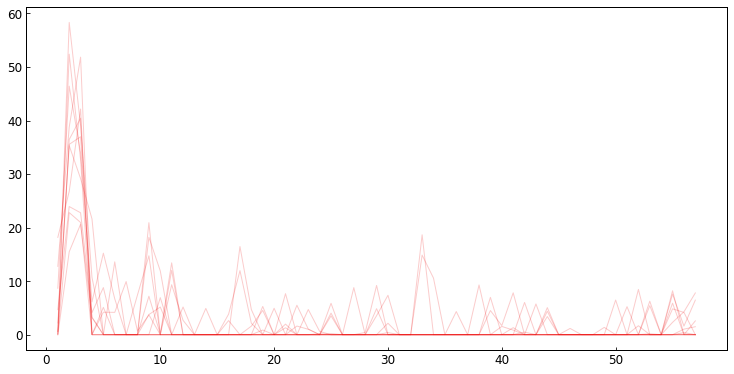

Cluster: 59


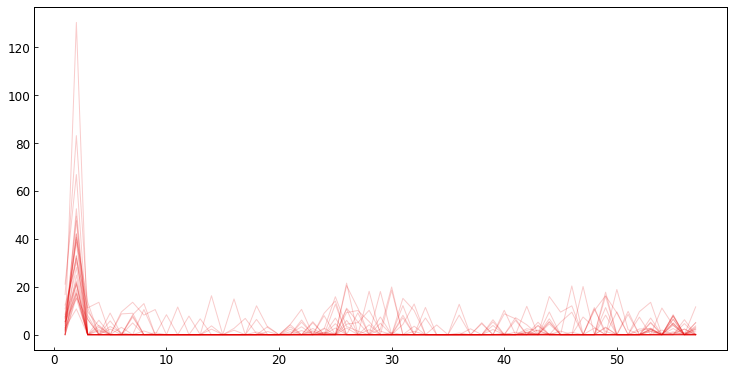

Cluster: 60


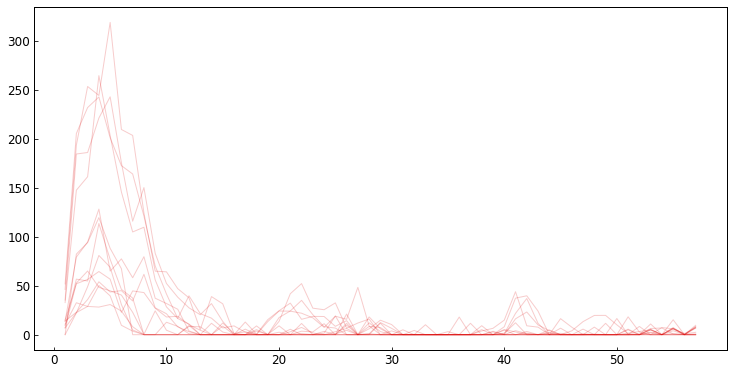

Cluster: 61


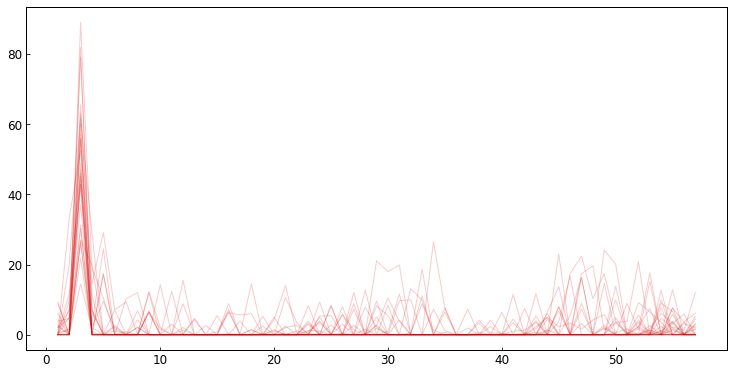

Cluster: 62


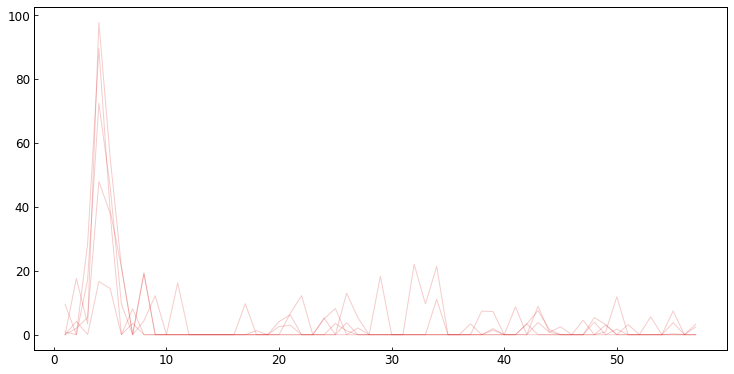

Cluster: 63


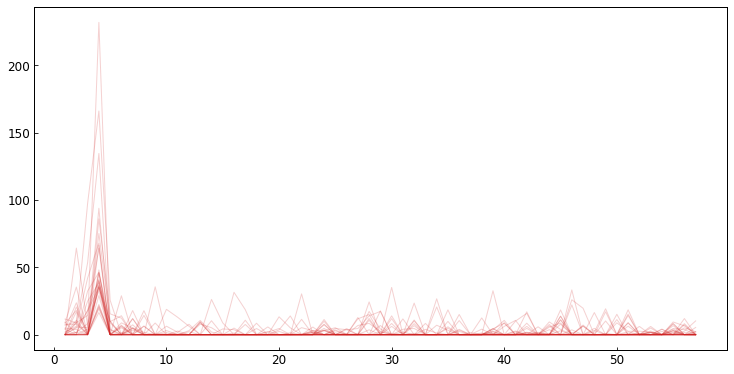

Cluster: 64


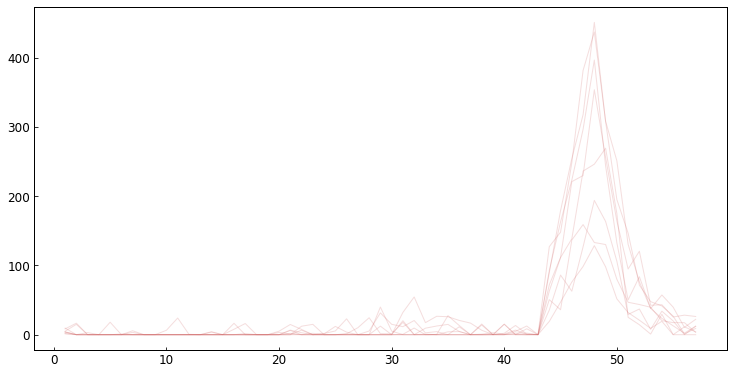

Cluster: 65


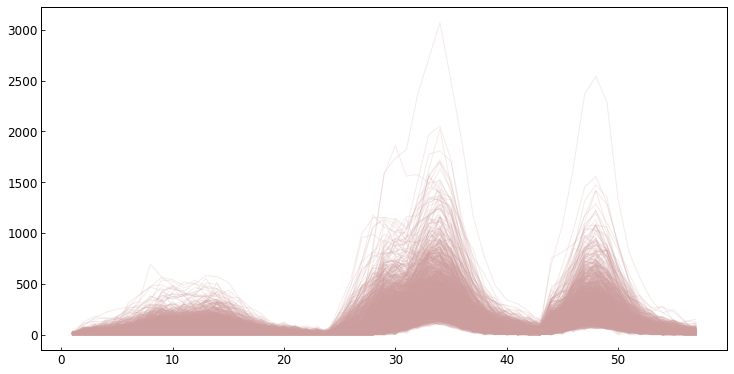

Cluster: 66


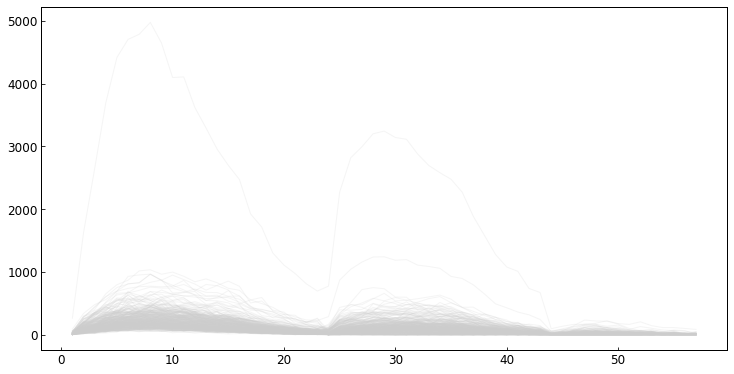

In [144]:
spec_dims = (10,5)

clust_hbd_gt = clust_hdb[clust_hdb > -1]

for c in np.unique(clust_hbd_gt):
    print('Cluster:', c)
    bool_c = clust_hdb == c
    spec_sub = specs_arr[bool_c,:]

    spec_sub_meansub = spec_sub - specs_med
    spec_sub_meansub[spec_sub_meansub < 0] = 0

    fig, ax = ip.general_plot(dims=spec_dims)
    color = dict_clust_col[c]
    fsi.plot_cell_spectra(ax, spec_sub_meansub, {'lw':1,'alpha':0.2,'color':color})
    # ax.set_ylim(0,12500)
    # ax.set_ylim(0,2**16)
    plt.plot()
    plt.show()

Cluster: 60


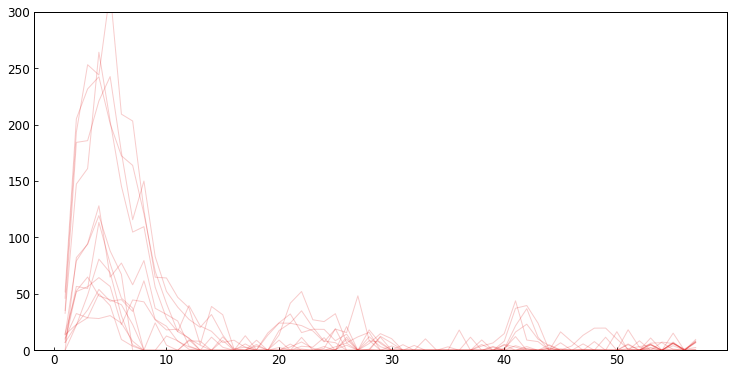

Cluster: 64


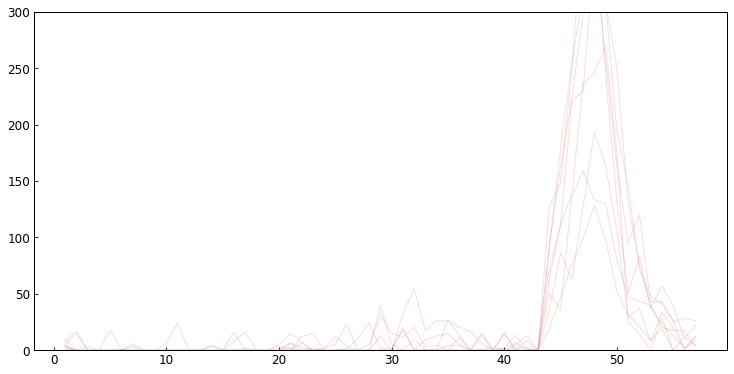

Cluster: 65


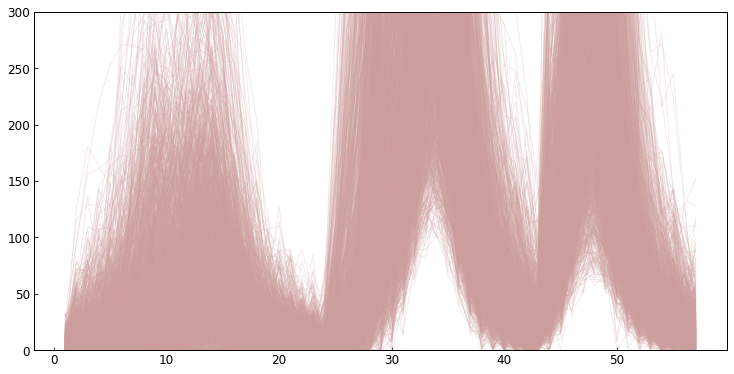

Cluster: 66


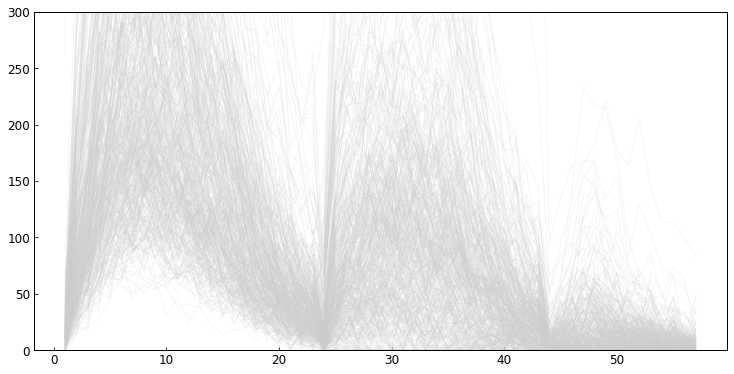

In [166]:
spec_dims = (10,5)

clust_hbd_gt = clust_hdb[clust_hdb > -1]

for c in [60,64,65,66]:
    print('Cluster:', c)
    bool_c = clust_hdb == c
    spec_sub = specs_arr[bool_c,:]

    spec_sub_meansub = spec_sub - specs_med
    spec_sub_meansub[spec_sub_meansub < 0] = 0

    fig, ax = ip.general_plot(dims=spec_dims)
    color = dict_clust_col[c]
    fsi.plot_cell_spectra(ax, spec_sub_meansub, {'lw':1,'alpha':0.2,'color':color})
    # ax.set_ylim(0,12500)
    ax.set_ylim(0,300)
    plt.plot()
    plt.show()

Cluster: 0


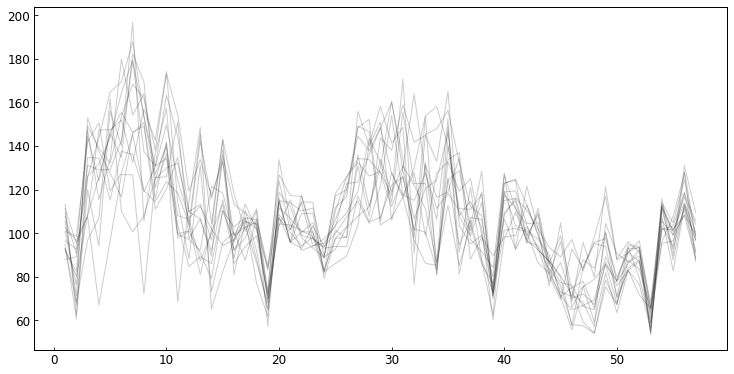

Cluster: 1


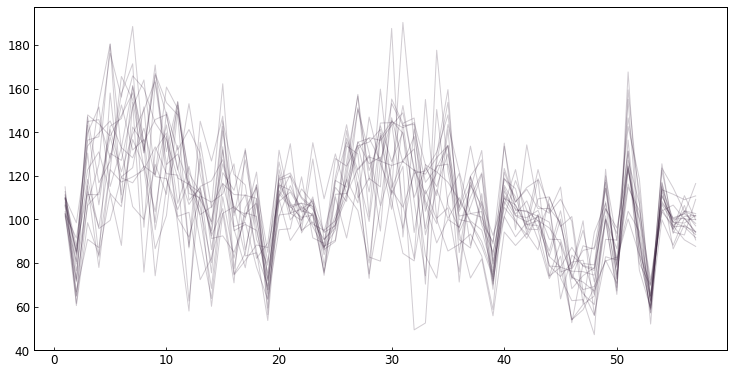

Cluster: 2


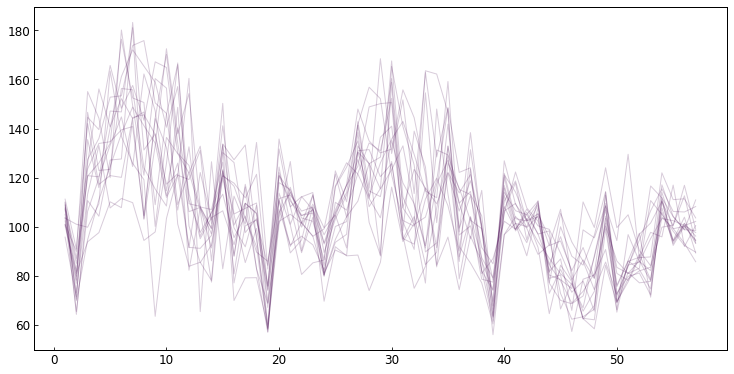

Cluster: 3


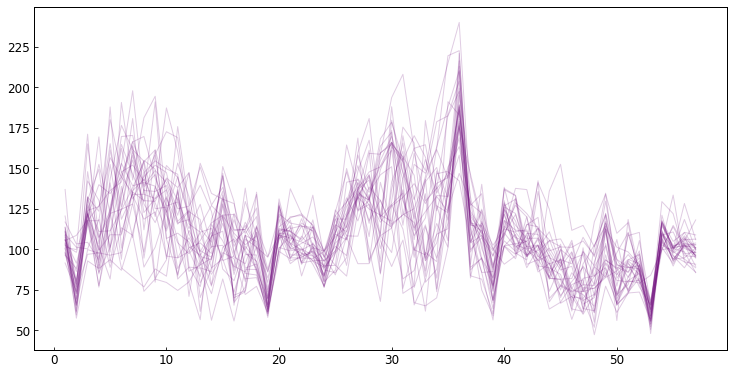

Cluster: 4


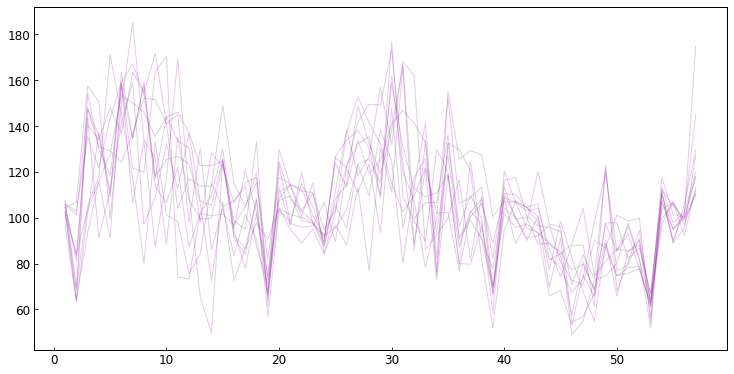

Cluster: 5


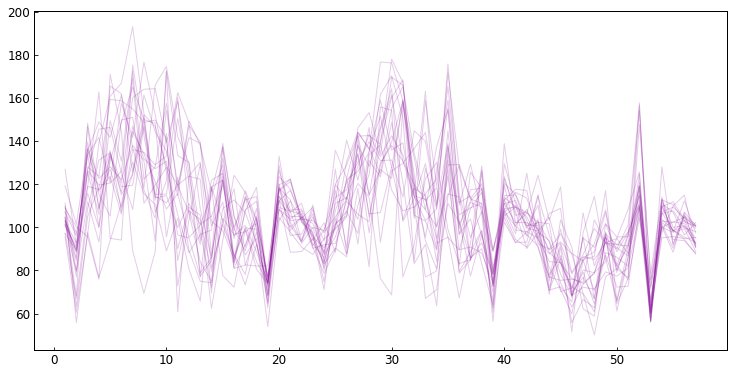

Cluster: 6


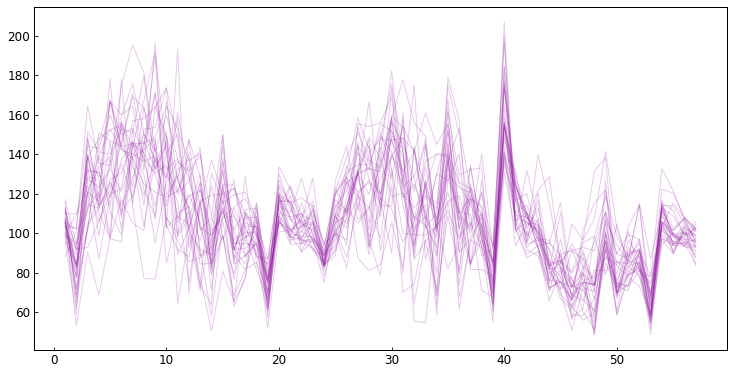

Cluster: 7


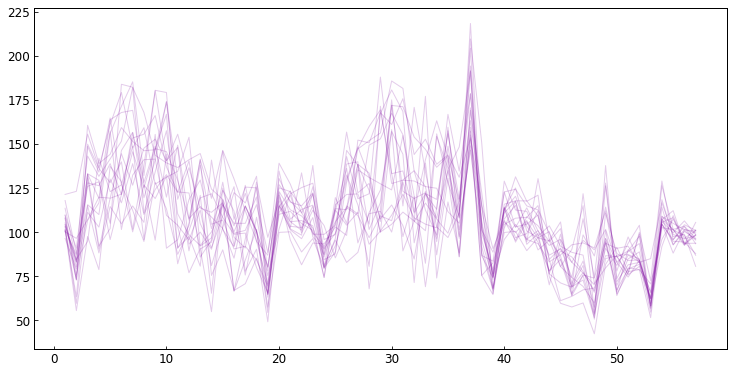

Cluster: 8


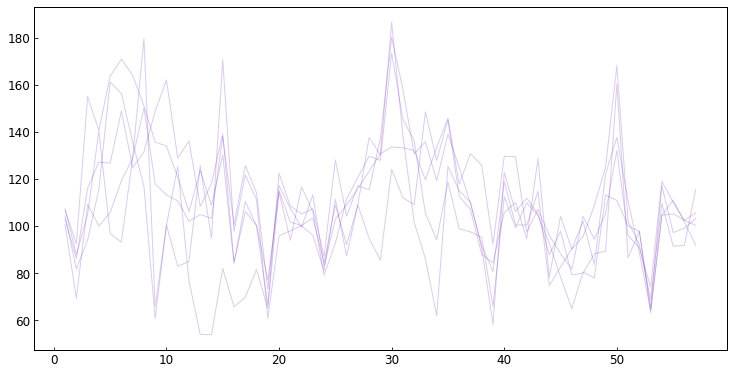

Cluster: 9


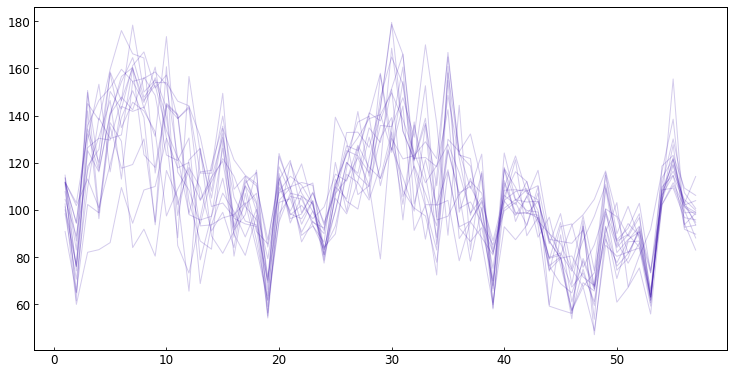

Cluster: 10


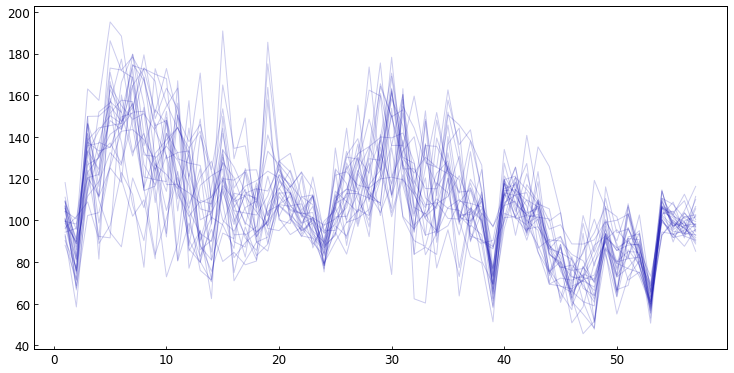

Cluster: 11


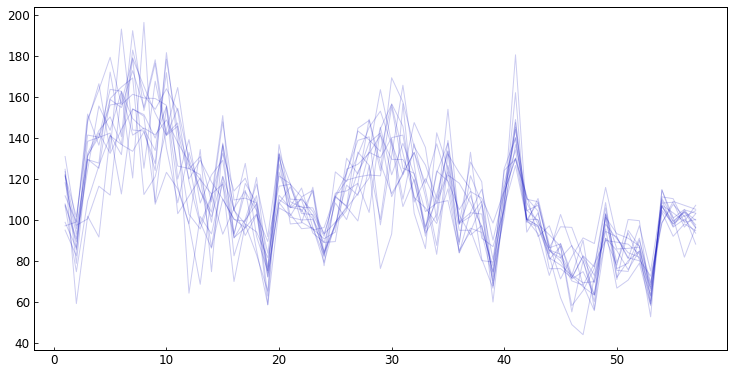

Cluster: 12


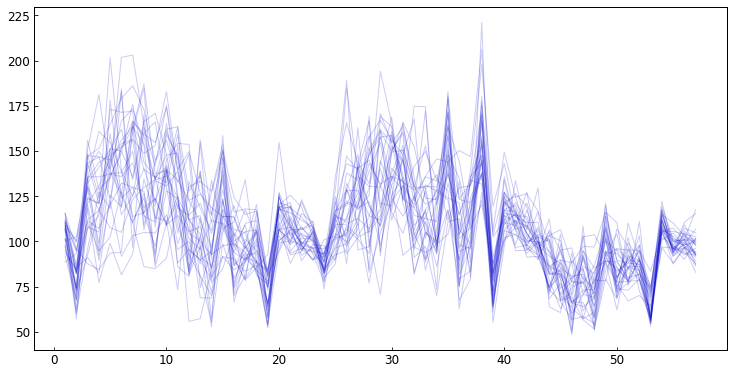

Cluster: 13


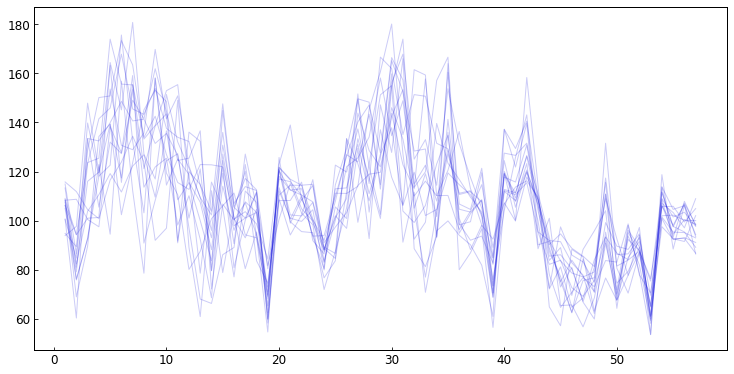

Cluster: 14


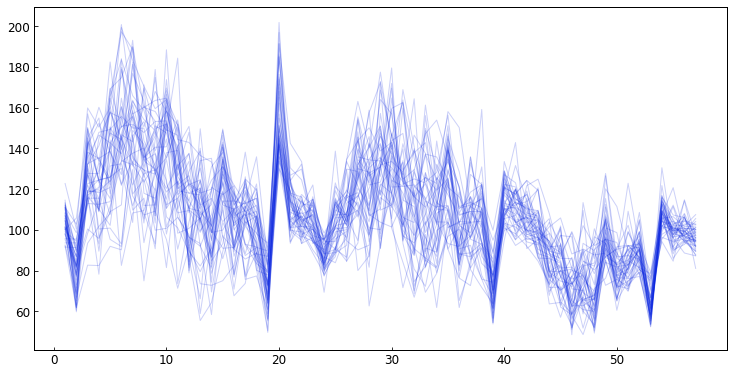

Cluster: 15


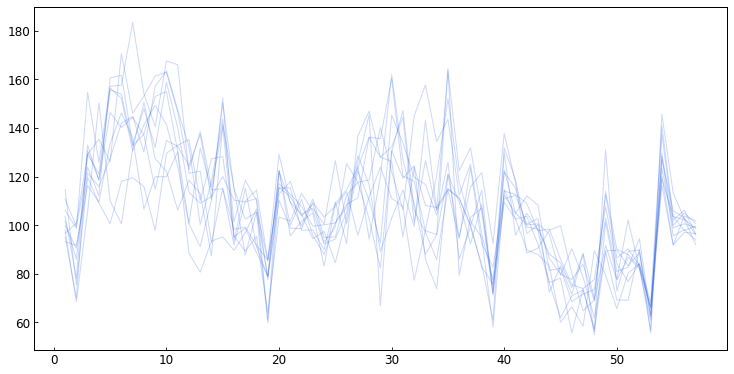

Cluster: 16


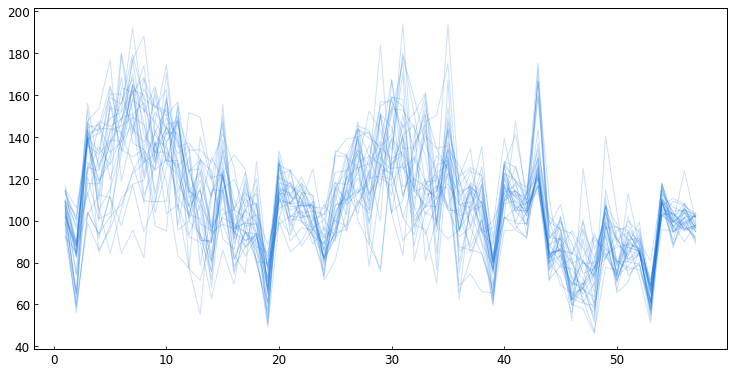

Cluster: 17


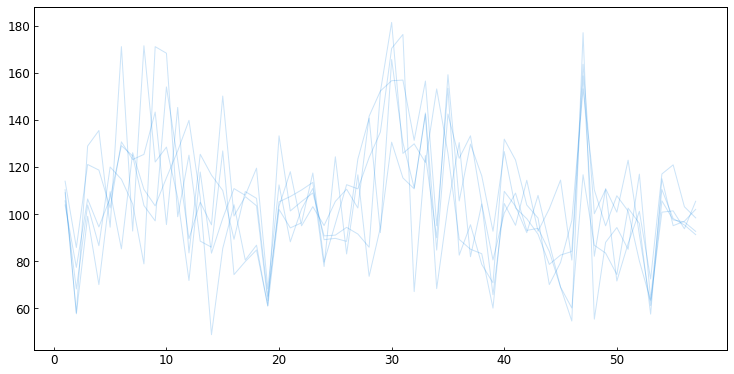

Cluster: 18


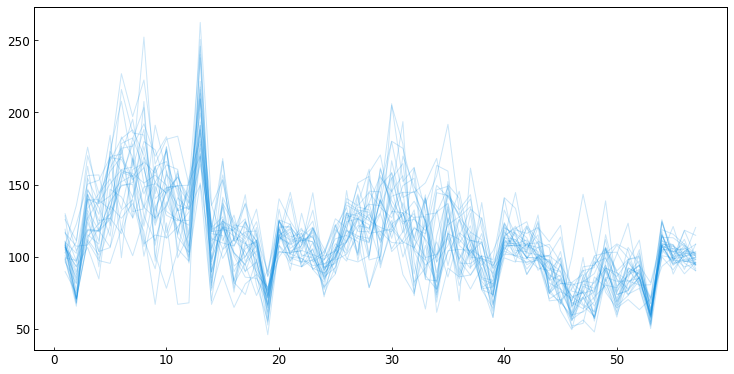

Cluster: 19


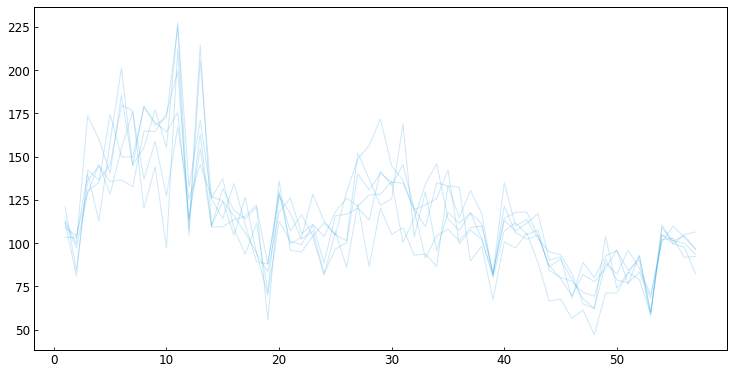

Cluster: 20


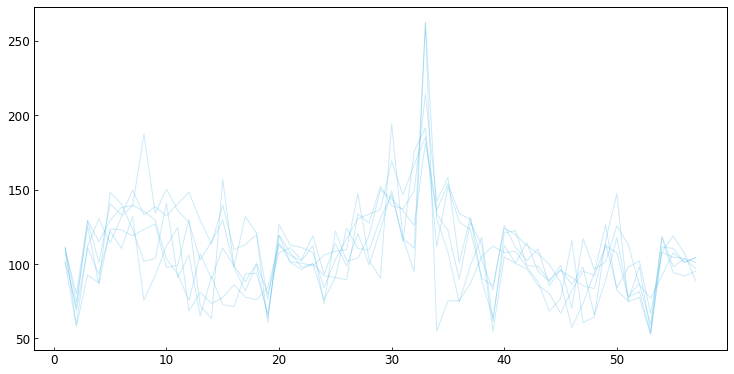

Cluster: 21


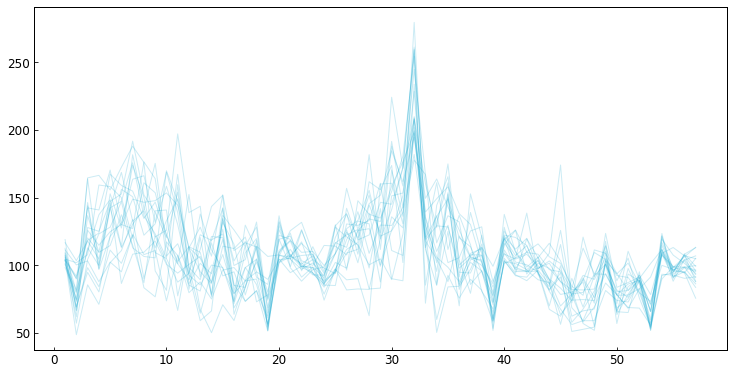

Cluster: 22


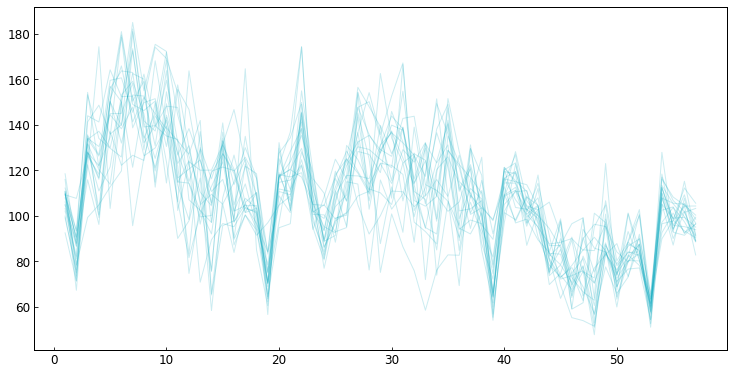

Cluster: 23


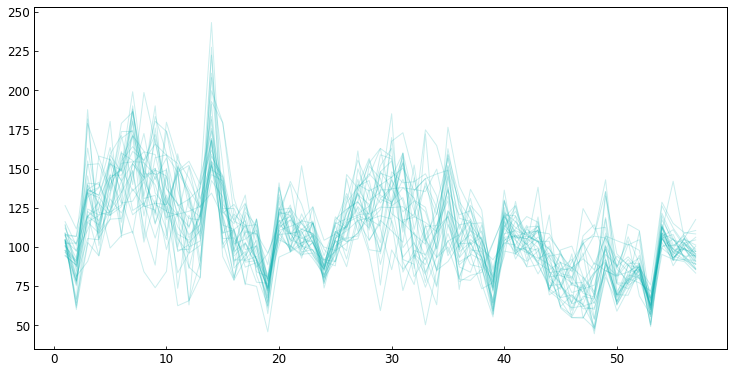

Cluster: 24


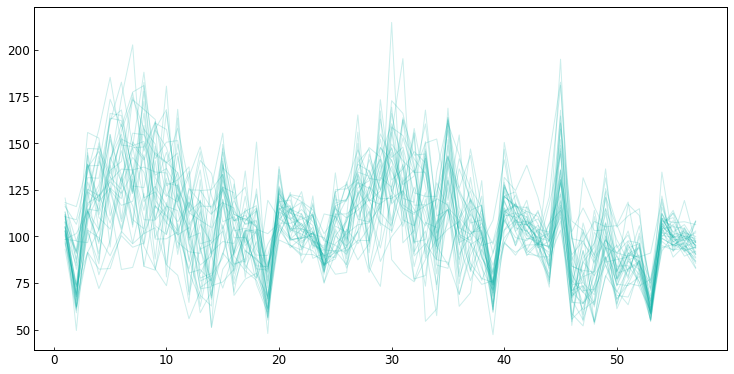

Cluster: 25


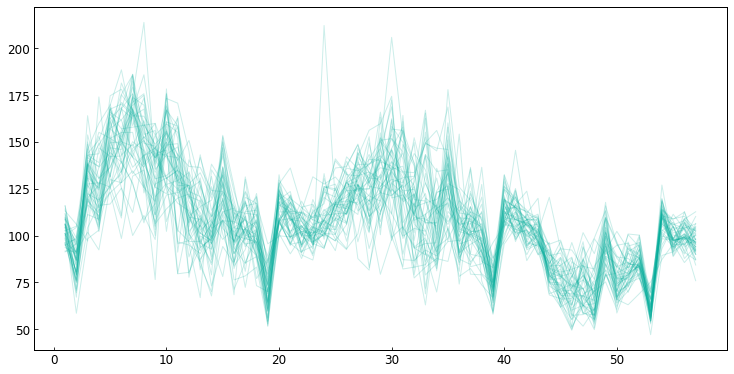

Cluster: 26


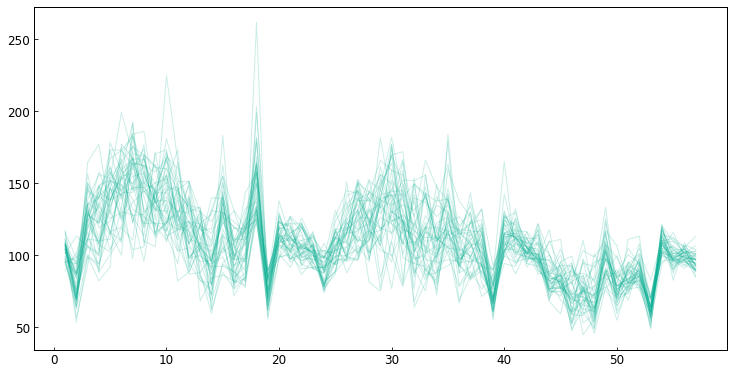

Cluster: 27


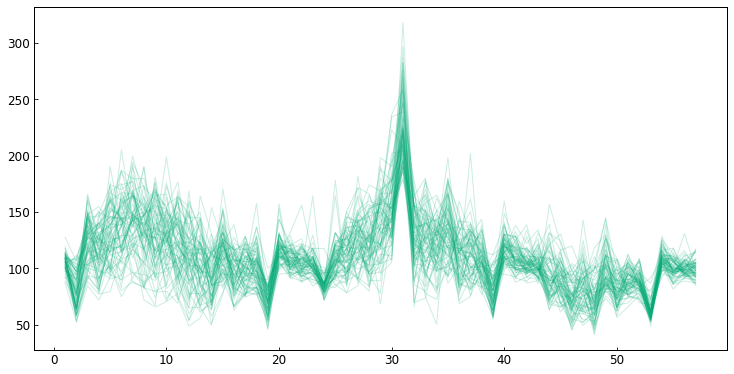

Cluster: 28


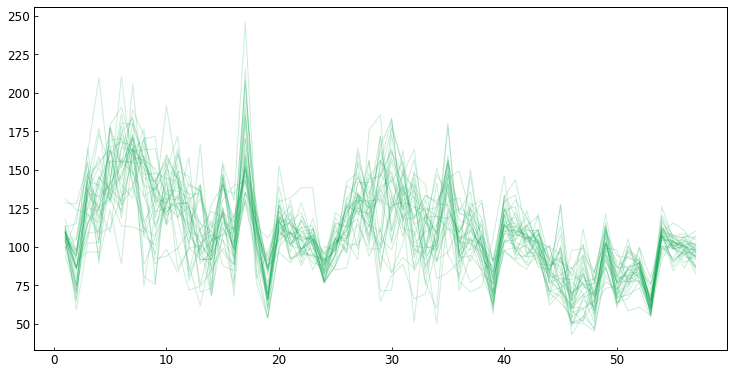

Cluster: 29


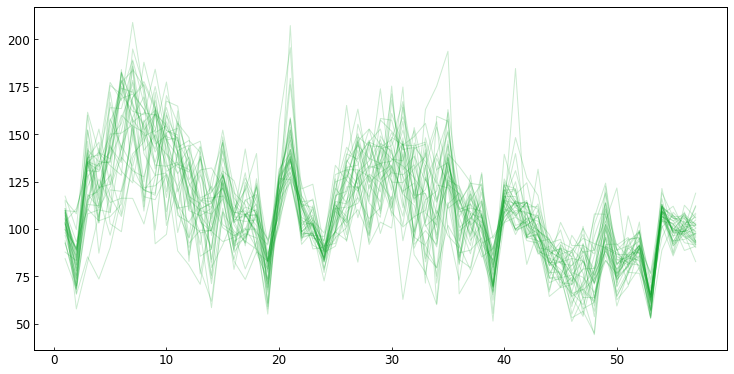

Cluster: 30


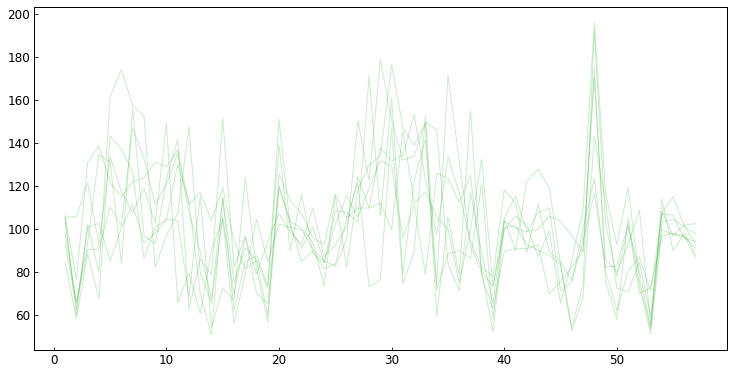

Cluster: 31


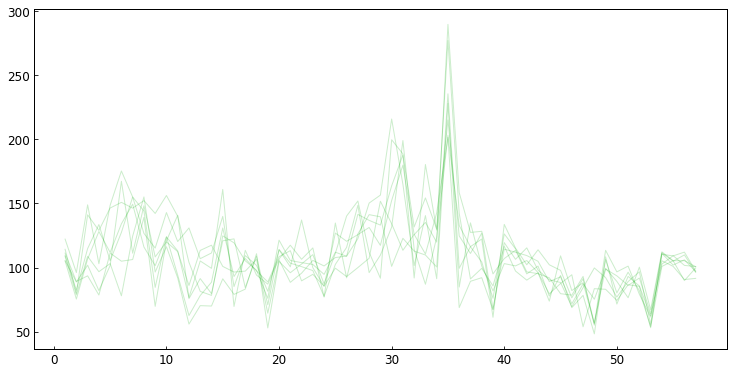

Cluster: 32


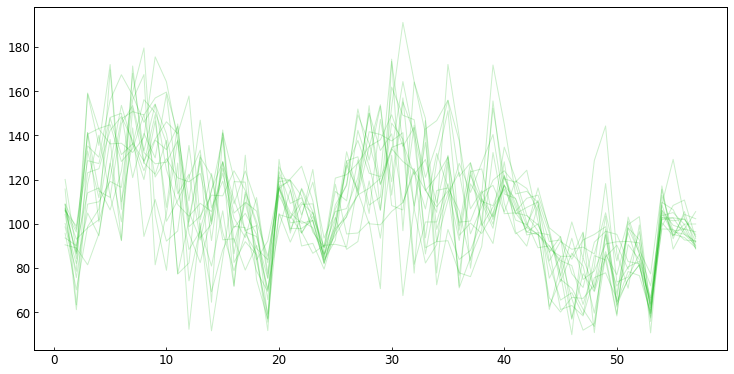

Cluster: 33


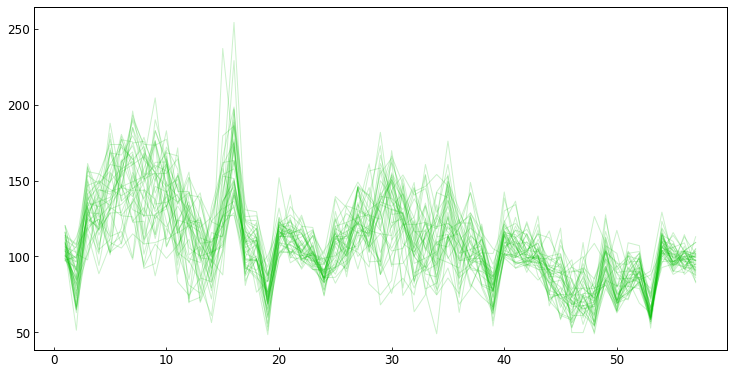

Cluster: 34


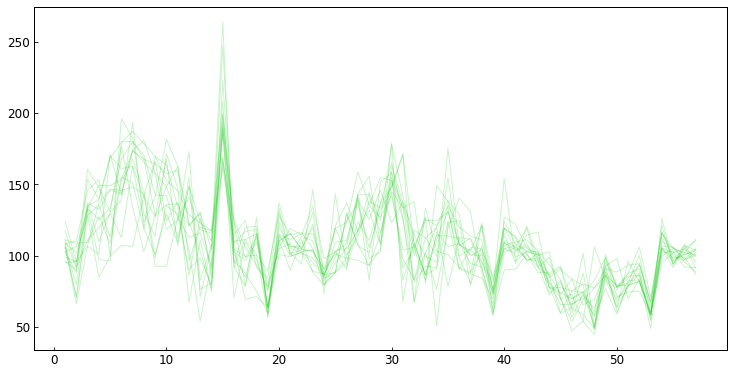

Cluster: 35


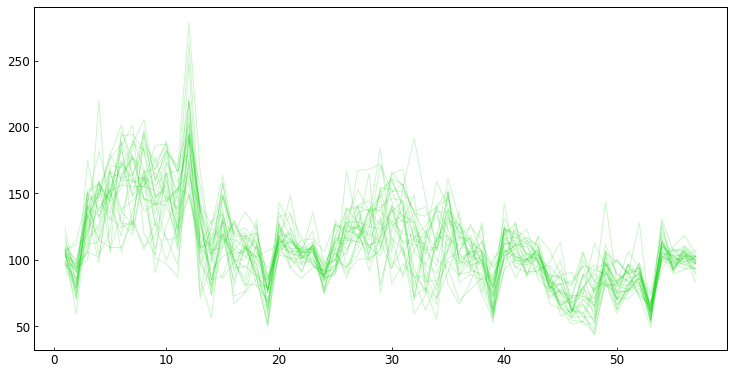

Cluster: 36


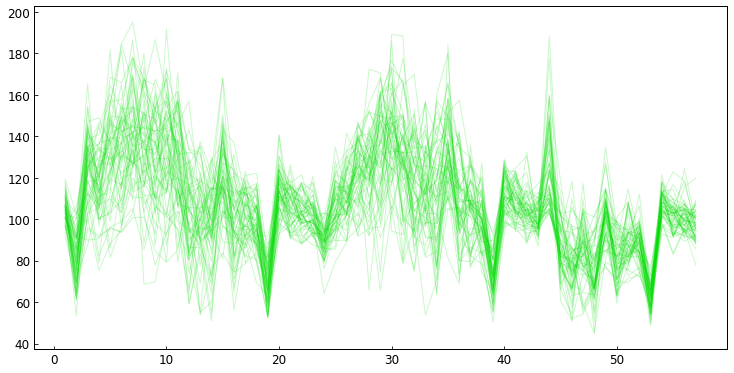

Cluster: 37


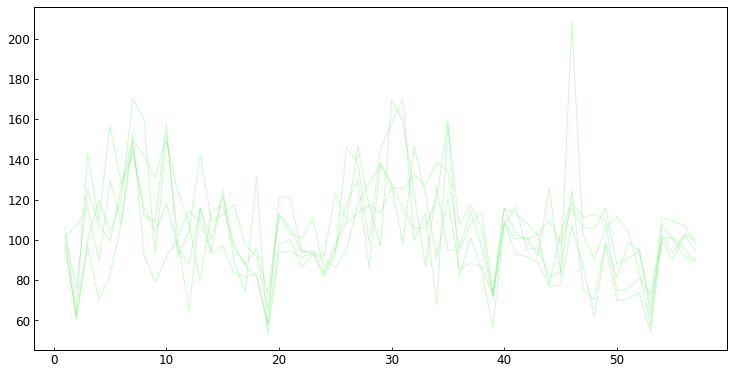

Cluster: 38


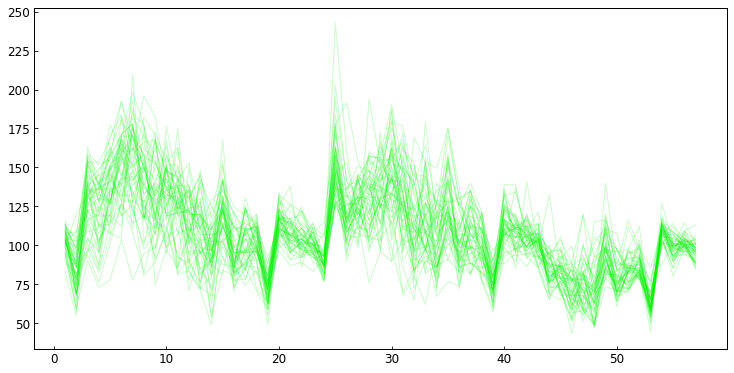

Cluster: 39


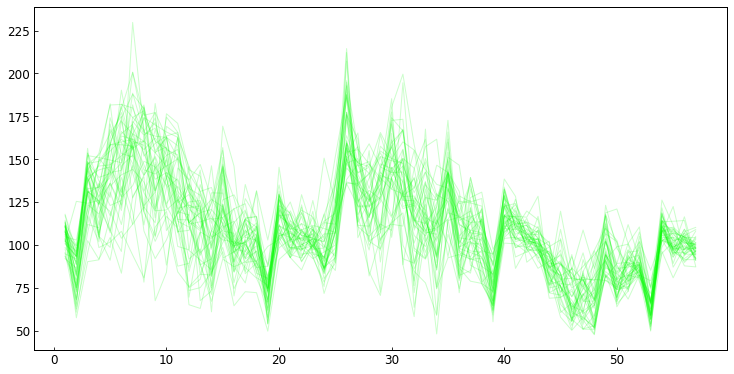

Cluster: 40


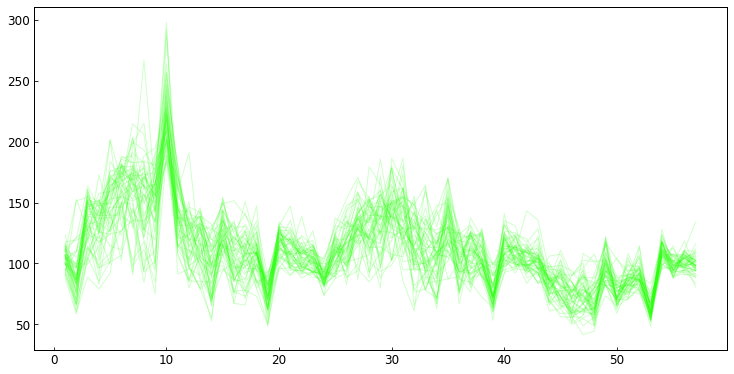

Cluster: 41


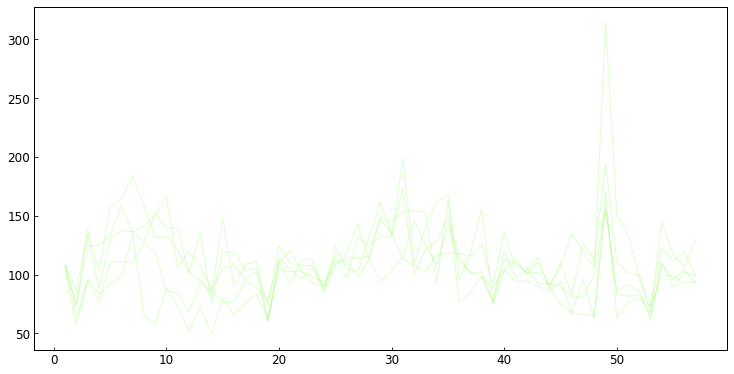

Cluster: 42


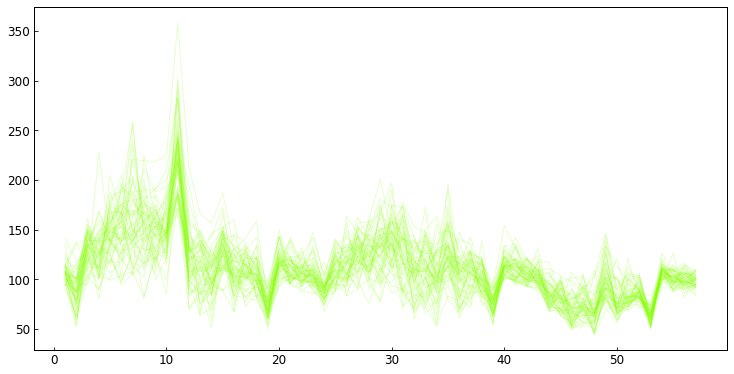

Cluster: 43


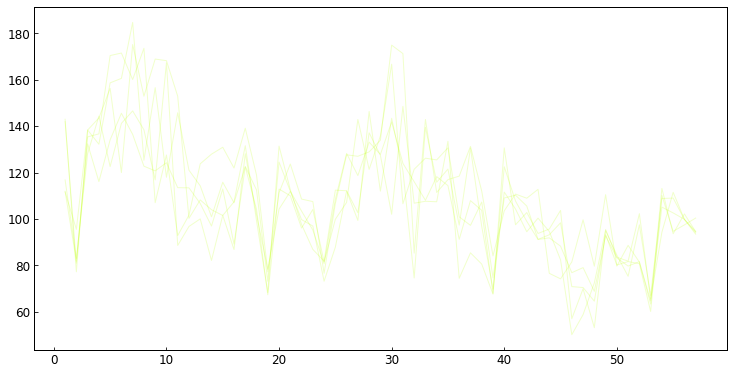

Cluster: 44


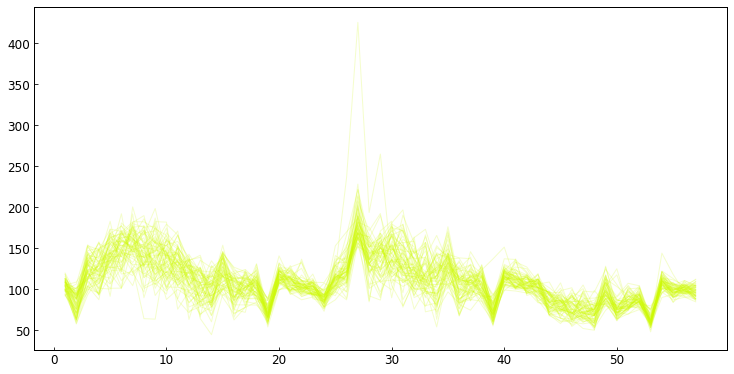

Cluster: 45


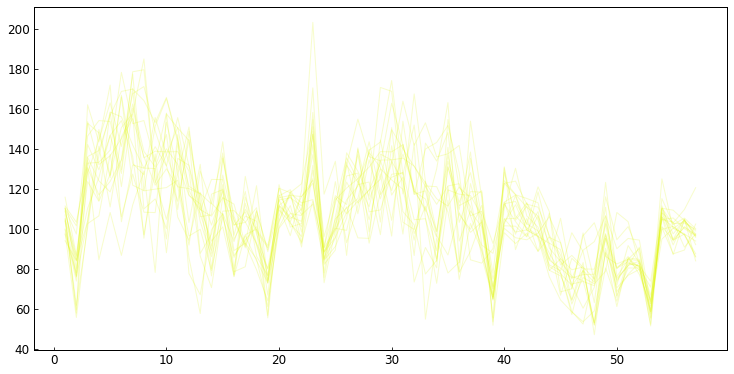

Cluster: 46


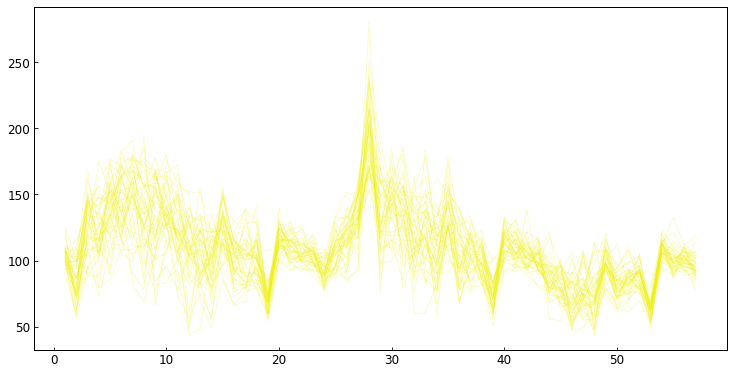

Cluster: 47


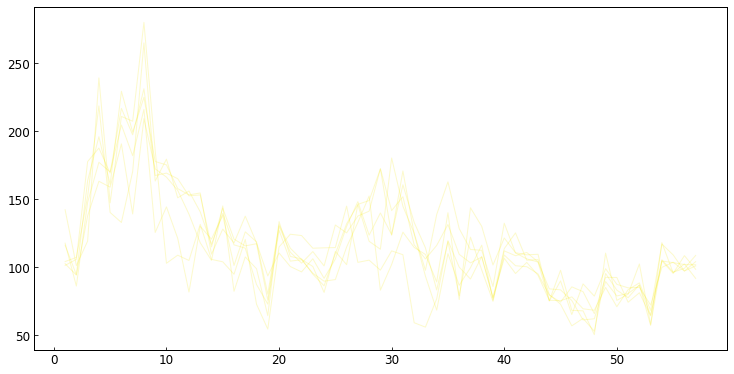

Cluster: 48


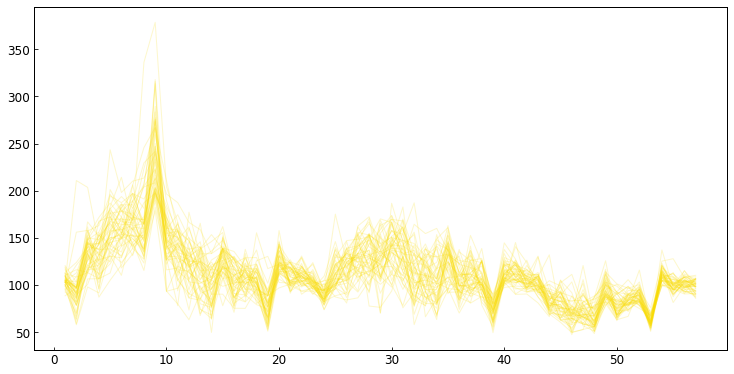

Cluster: 49


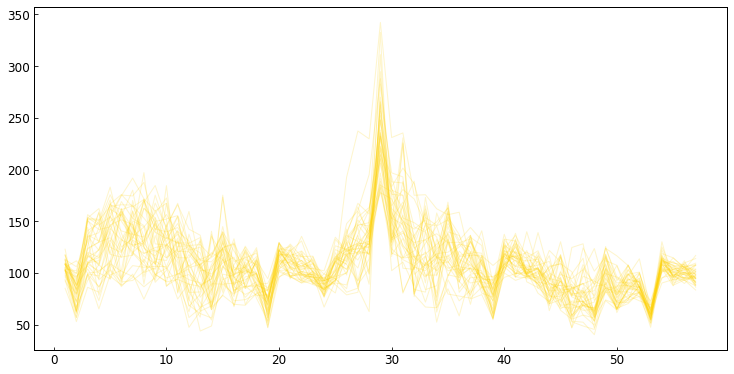

Cluster: 50


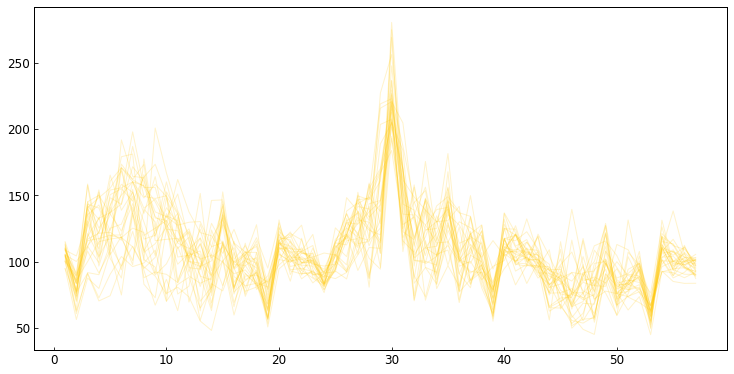

Cluster: 51


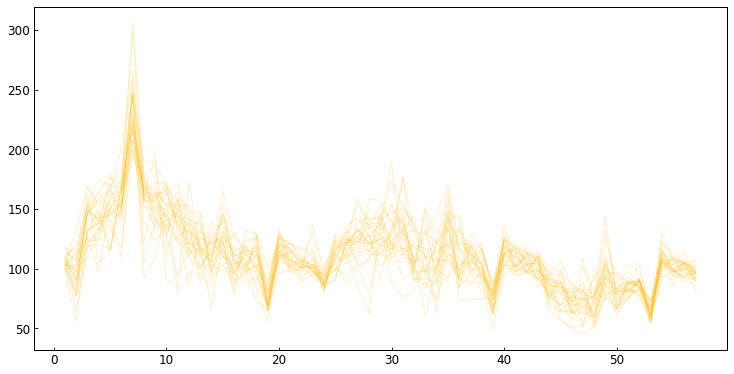

Cluster: 52


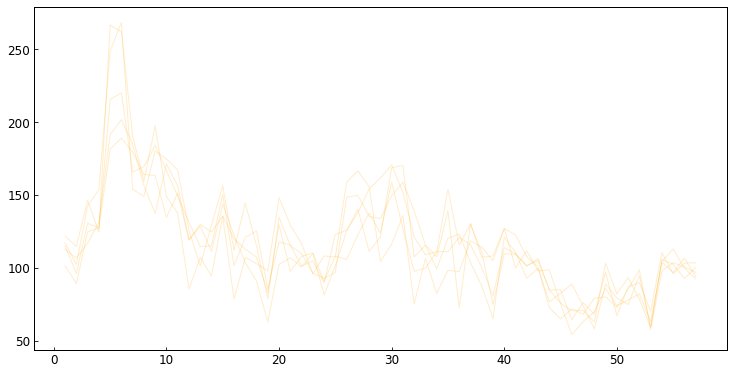

Cluster: 53


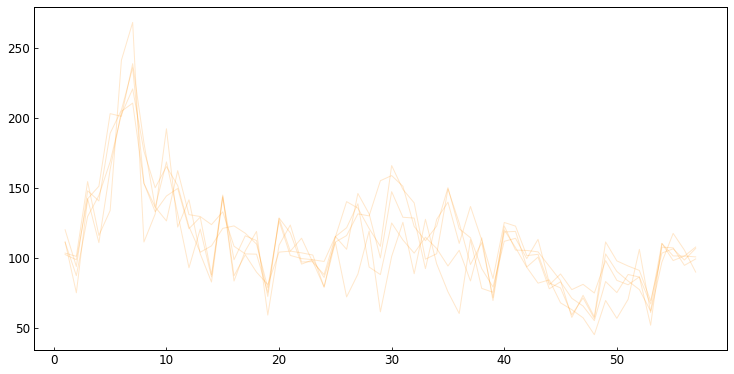

Cluster: 54


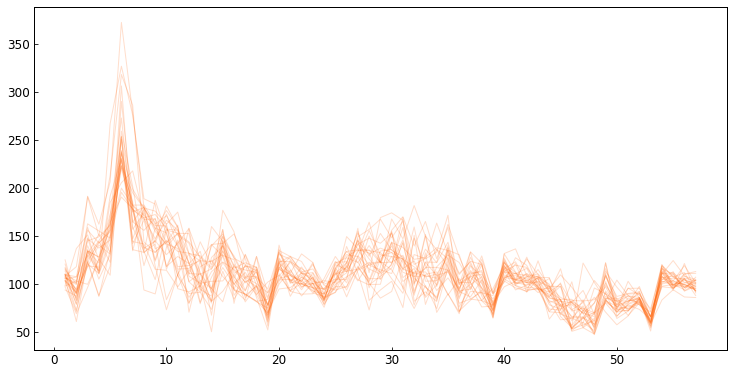

Cluster: 55


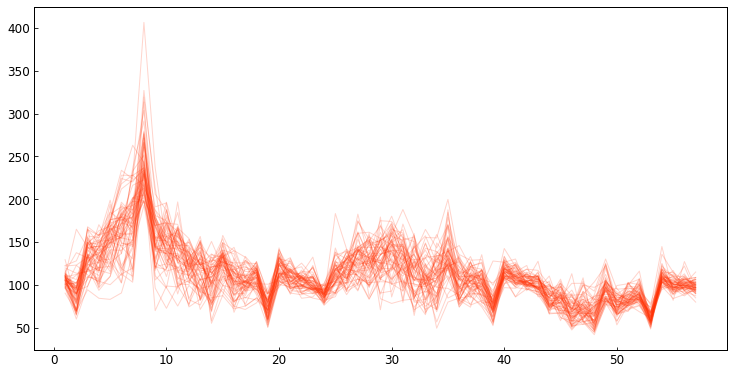

Cluster: 56


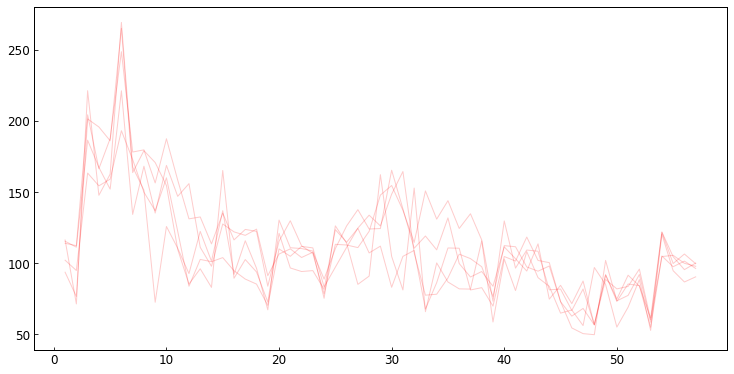

Cluster: 57


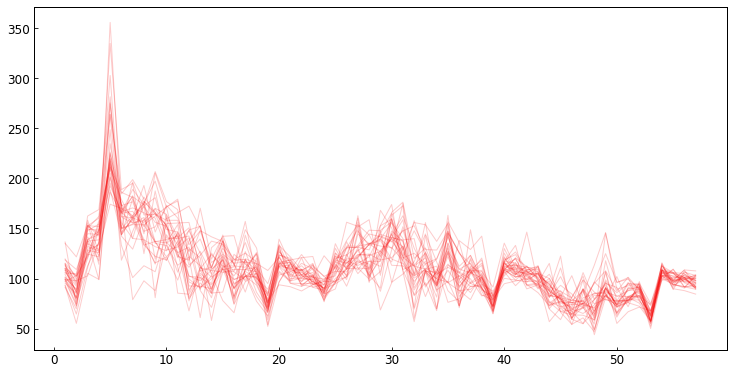

Cluster: 58


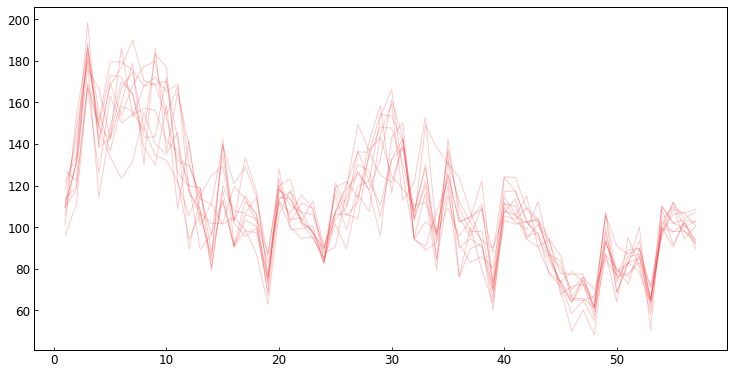

Cluster: 59


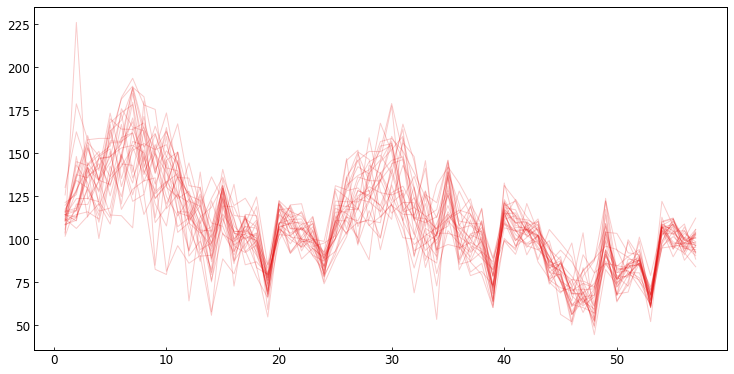

Cluster: 60


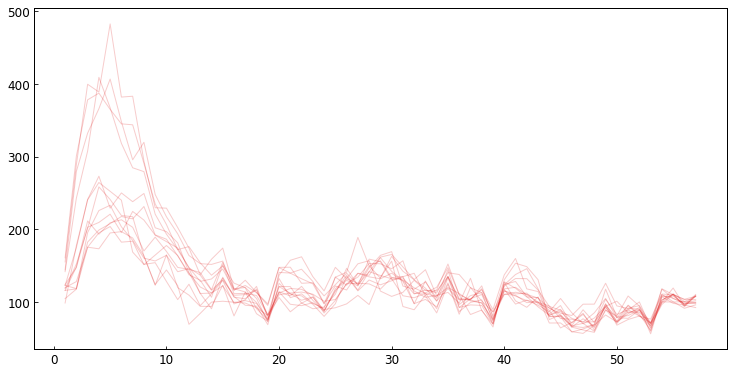

Cluster: 61


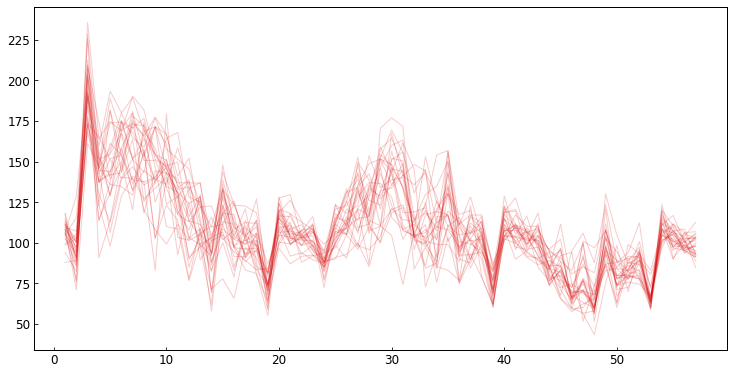

Cluster: 62


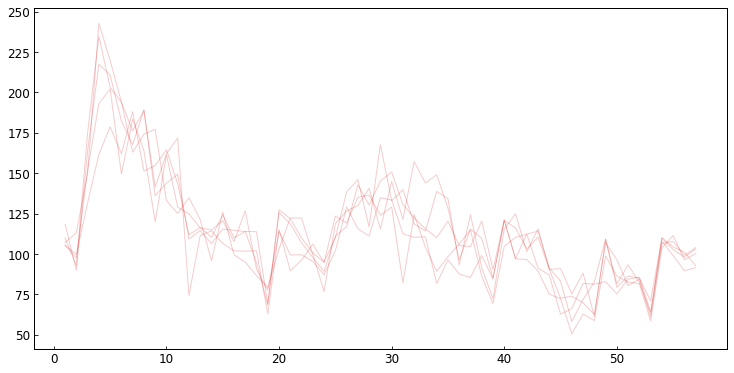

Cluster: 63


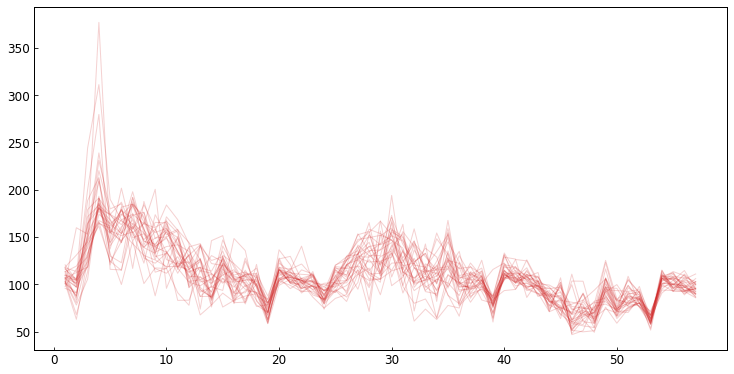

Cluster: 64


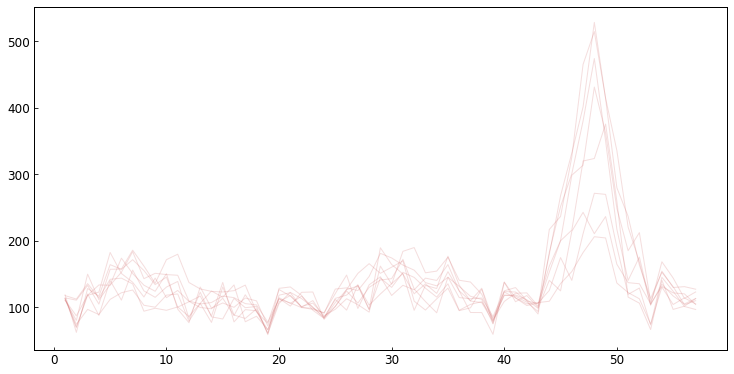

Cluster: 65


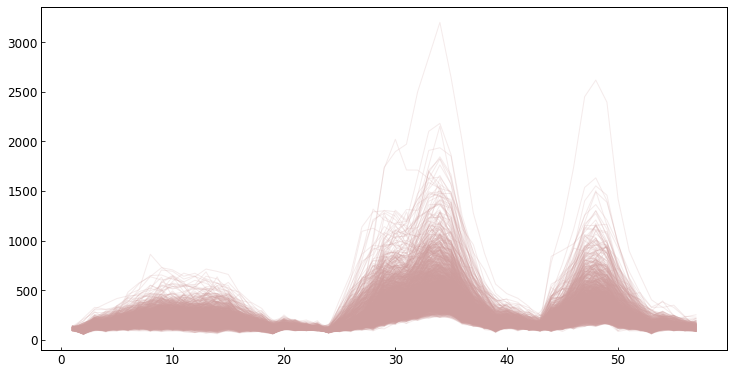

Cluster: 66


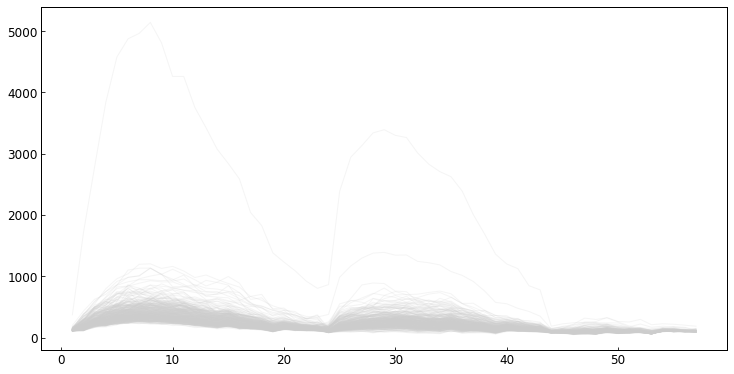

In [164]:
spec_dims = (10,5)

clust_hbd_gt = clust_hdb[clust_hdb > -1]

for c in np.unique(clust_hbd_gt):
    print('Cluster:', c)
    bool_c = clust_hdb == c
    spec_sub = specs_arr[bool_c,:]

    # spec_sub_meansub = spec_sub - specs_med
    # spec_sub_meansub[spec_sub_meansub < 0] = 0

    fig, ax = ip.general_plot(dims=spec_dims)
    color = dict_clust_col[c]
    fsi.plot_cell_spectra(ax, spec_sub, {'lw':1,'alpha':0.2,'color':color})
    # ax.set_ylim(0,12500)
    # ax.set_ylim(0,2**16)
    plt.plot()
    plt.show()

In [117]:
sn='2023_11_22_newplasmid_sample_bmg_fov_03'
m='3'

clust_hdb_sn = clust_hdb[list(dict_sn_m_idx_lab[sn][m].keys())]
labels_hdb_sn = np.array(list(dict_sn_m_idx_lab[sn][m].values()))
len(clust_hdb_sn)

2180

In [118]:

labels_sub = np.array(labels_hdb_sn)[clust_hdb_sn > -1]
clust_hdb_sub = clust_hdb_sn[clust_hdb_sn > -1]
dict_lab_clust = dict(zip(labels_sub,clust_hdb_sub))
n_clust = np.max(clust_hdb) + 1
colors = plt.get_cmap('nipy_spectral')(np.linspace(0,1,n_clust))
dict_clust_col = dict(zip(np.arange(n_clust), colors))

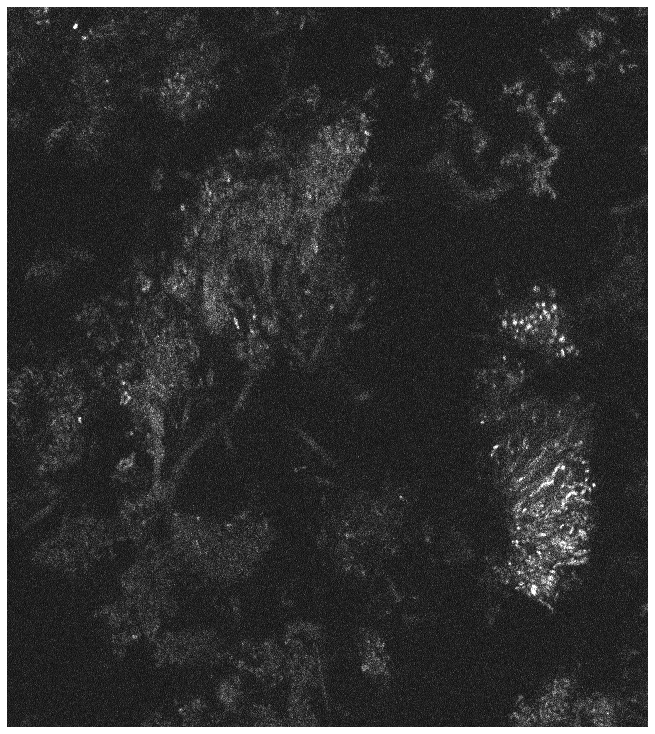

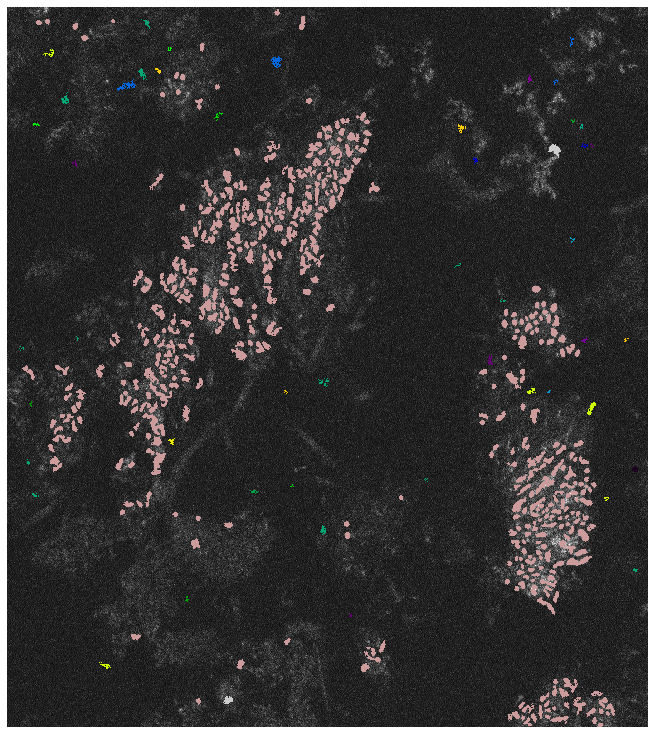

In [119]:
mx = np.max(stack_sum)*0.5
# mx = 60000
mn = np.min(stack_sum)
im_norm = np.clip(stack_sum,mn,mx)
im_norm = (im_norm - mn) / (mx - mn)
im_rgb = im_norm[:,:,None] * np.array([1,1,1])[None,:]
im_rgb = np.dstack([im_rgb, np.ones(im_rgb.shape[:2])])
fig, ax, _ = ip.plot_image(im_rgb, im_inches=10)
plt.show()
plt.close()

for i, row in props.iterrows():
    l = row.label
    if l in labels_sub:
        b = row.bbox
        b = eval(b) if isinstance(b, str) else b
        rgb_sub = im_rgb[b[0]:b[2],b[1]:b[3]]
        seg_sub = seg[b[0]:b[2],b[1]:b[3]] == l
        im_sub = im_norm[b[0]:b[2],b[1]:b[3]]
        cl = dict_lab_clust[l]
        color = np.array(dict_clust_col[cl])
        # rgb_noncell =  rgb_sub * np.dstack([~seg_sub]*3 + np.ones_like(seg_sub))
        rgb_noncell =  rgb_sub * np.dstack([~seg_sub]*4)
        # rgb_cell = (im_sub * seg_sub)[:,:,None] * color[None,:]
        rgb_cell = seg_sub[:,:,None] * color[None,:]
        im_rgb[b[0]:b[2],b[1]:b[3],:] = rgb_noncell + rgb_cell

fig, ax, cbar = ip.plot_image(im_rgb, im_inches=10)

In [120]:
Ms[sn]



['3', '0', '1', '2']

In [ ]:
spec_dims = (10,5)

for c in np.unique(clust_hdb_sub):
    print('Cluster:', c)
    bool_c = clust_hdb_sub == c
    labels_sub = np.array(labels)[bool_c]
    spec_sub = []
    for l in labels_sub:
        s = dict_lab_specmean[l]
        spec_sub.append(s)
    spec_sub = np.vstack(spec_sub)
    fig, ax = ip.general_plot(dims=spec_dims)
    color = dict_clust_col[c]
    fsi.plot_cell_spectra(ax, spec_sub, {'lw':1,'alpha':0.2,'color':color})
    # ax.set_ylim(0,12500)
    # ax.set_ylim(0,2**16)
    plt.plot()
    plt.show()

## Compare reference spectra with measured spectra

In [387]:
def sum_normalize_ref(ref_spec):
    ref_sum_norm = []
    for r in ref_spec:
        r_ = r - np.min(r, axis=1)[:, None]
        ref_sum_norm.append(r_ / np.sum(r_, axis=1)[:, None])
    return [np.mean(r, axis=0) for r in ref_sum_norm]


def get_reference_spectra(barcodes, bc_len):
    ref_dir = "/workdir/bmg224/manuscripts/mgefish/data/unused/fig_5/HiPRFISH_reference_spectra"
    fmt = "08_18_2018_enc_{}_avgint.csv"
    # if bc_len == 5:
    barcodes_str = [str(bc).zfill(5) for bc in barcodes]
    # barcodes_str = [str(bc).zfill(7) for bc in barcodes]
    # barcodes_10bit = [bc[0] + '0' + bc[1:4] + '00' + bc[4:] for bc in barcodes_str]
    barcodes_10bit = [bc[0] + "0" + bc[1] + "0000" + bc[2:] for bc in barcodes_str]
    barcodes_b10 = [int(str(bc), 2) for bc in barcodes_10bit]
    st = 32
    en = 32 + 57
    ref_avgint_cols = [i for i in range(st, en)]

    ref_spec = []
    for bc in barcodes_b10:
        fn = cluster + "/" + ref_dir + "/" + fmt.format(bc)
        ref = pd.read_csv(fn, header=None)
        ref = ref[ref_avgint_cols].values
        ref_spec.append(ref)
    return ref_spec


# Get reference spectra
probe_design_dir = "/workdir/bmg224/manuscripts/mgefish/data/HiPRFISH_probe_design"
probe_design_fn = probe_design_dir + "/welch2016_5b_no_633_distant_welch.csv"
# probe_design_fn = probe_design_dir + "/welch2016_5b_no_633_channel.csv"
probe_design = pd.read_csv(probe_design_fn)
barcodes = probe_design["code"].unique()
barcode_length = len(str(np.max(barcodes)))
ref_spec = get_reference_spectra(barcodes, barcode_length)
sci_names = [
    probe_design.loc[probe_design["code"] == bc, "sci_name"].unique()[0]
    for bc in barcodes
]
weights_sum_norm = sum_normalize_ref(ref_spec)

FileNotFoundError: [Errno 2] No such file or directory: '/workdir/bmg224/manuscripts/mgefish/data/HiPRFISH_probe_design/welch2016_5b_no_633_distant_welch.csv'

In [221]:
barcodes_fill = [str(bc).zfill(5) for bc in barcodes]
dict_bc_sciname = dict(zip(barcodes_fill, sci_names))

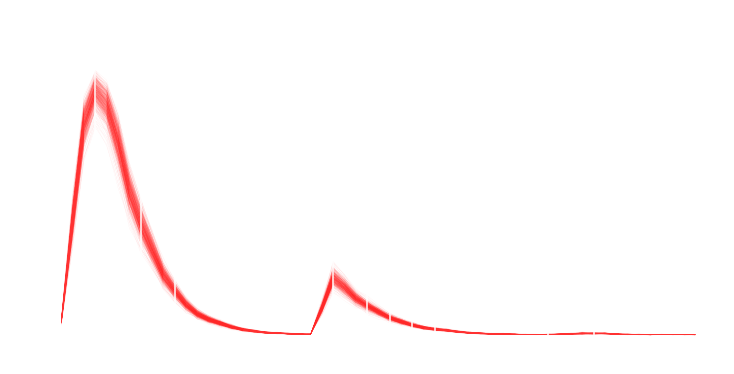

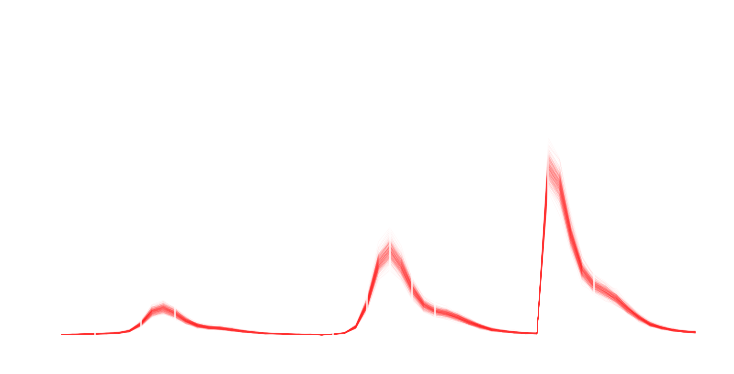

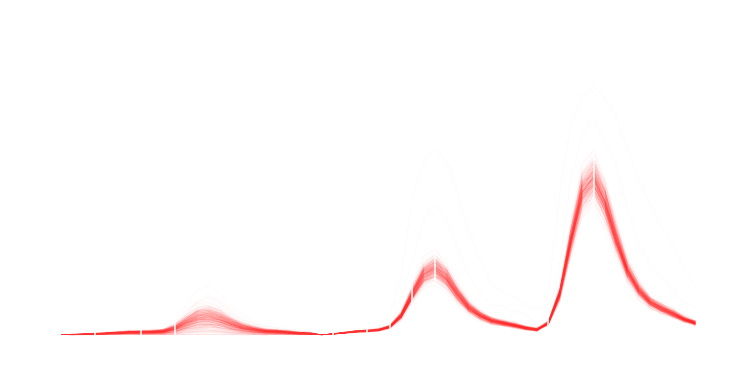

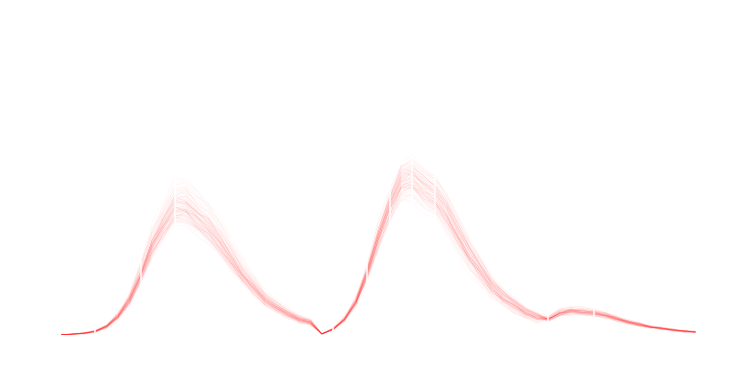

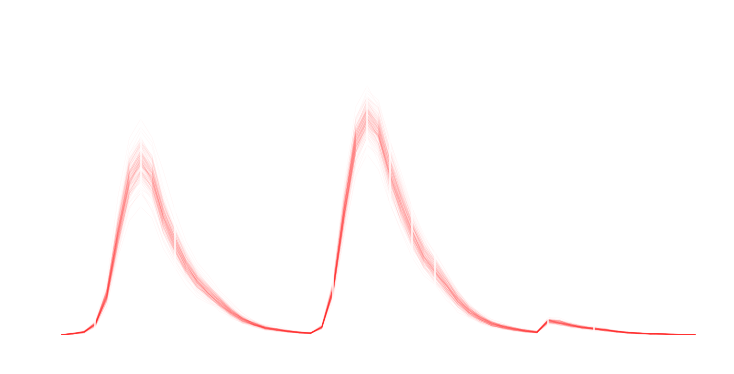

...

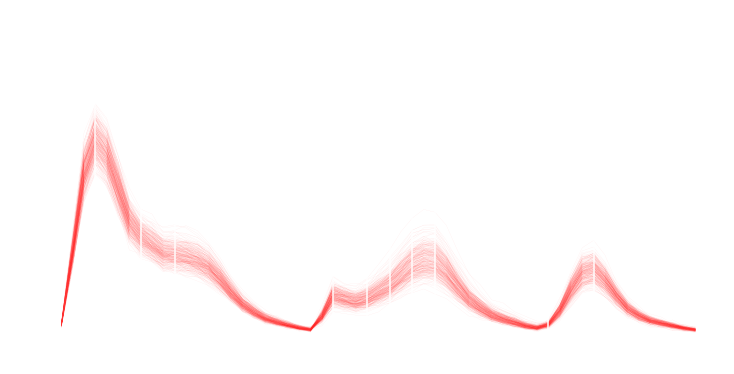

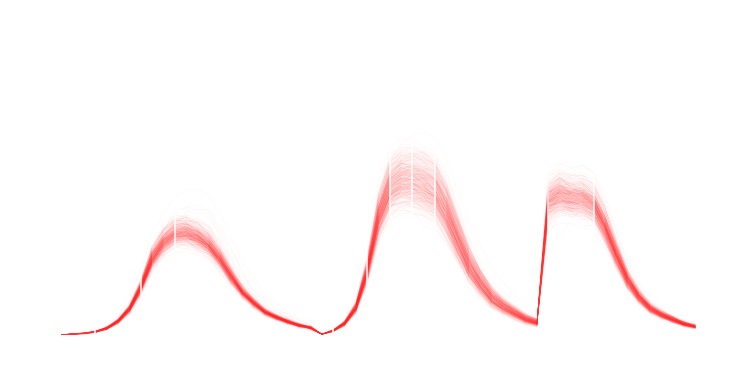

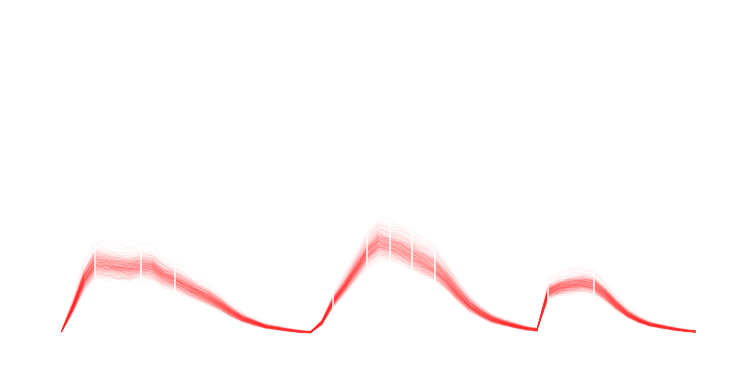

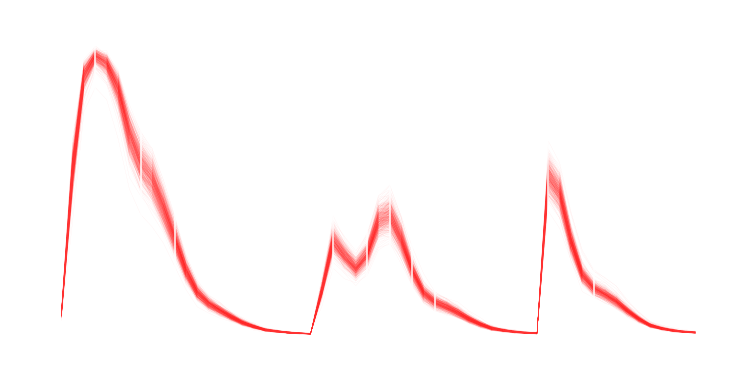

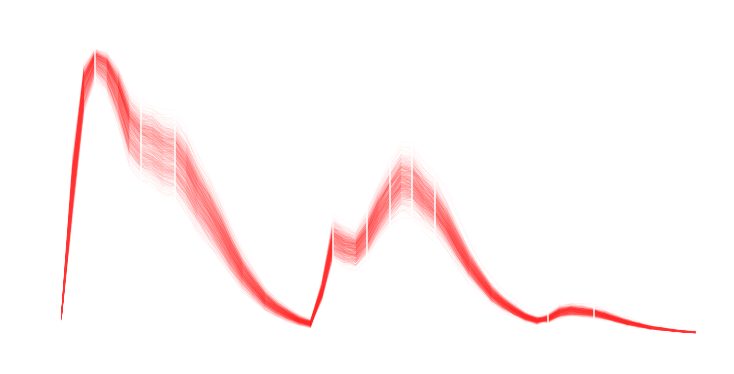

In [222]:
xs = [3, 7, 10, 24, 27, 29, 31, 33, 43, 47]
spec_dims = (10,5)

for s, name in zip(ref_spec, sci_names):
    fig, ax = ip.general_plot(dims=spec_dims, col='w')
    fsi.plot_cell_spectra(ax, s, {'lw':0.2,'alpha':0.1,'color':'r'})
    ax.set_title(name,color='w')
    for x in xs:
        ax.plot([x,x], [0,1],'w')

In [66]:
ref_spec_arr = np.vstack([s for s in ref_spec])
ref_spec_arr.shape

(8127, 57)

In [67]:
ref_spec_arr_mean = np.vstack([np.mean(s, axis=0) for s in ref_spec])
ref_spec_arr_mean.shape

(19, 57)

In [69]:
n_cells = len(dict_idx_spec)

dist_mat_refmean = np.zeros((ref_spec_arr_mean.shape[0], n_cells))
for i, s_i in tqdm(enumerate(ref_spec_arr_mean)):
    s_i_sub = s_i
    for j, s_j in enumerate(dict_idx_spec.values()):
        # if j > i:
        s_j_sub = s_j
        dist_mat_refmean[i,j] = fhc.channel_cosine_intensity_allonev2(s_i_sub, s_j_sub)


19it [00:01, 18.91it/s]


In [71]:
u_ref = fit.transform(dist_mat_refmean)

/home/bmg224/miniconda3/envs/hiprfish_imaging_py38/lib/python3.8/site-packages/umap/umap_.py:2830: UserWarning: Transforming new data with precomputed metric. We are assuming the input data is a matrix of distances from the new points to the points in the training set. If the input matrix is sparse, it should contain distances from the new points to their nearest neighbours or approximate nearest neighbours in the training set.
  warn(


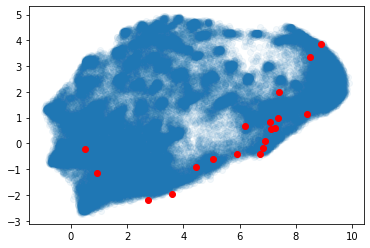

In [72]:
plt.scatter(u[:,0], u[:,1], alpha=0.05)
plt.scatter(u_ref[:,0], u_ref[:,1], alpha=1, color='r')
plt.show()
plt.close()

Try scaling the reference spectra down

In [84]:
mn = np.min(ref_spec_arr_mean, axis=1)
mx = np.max(ref_spec_arr_mean, axis=1)
ref_spec_arr_mean_norm = (ref_spec_arr_mean.T - mn) / (mx - mn)
ref_spec_arr_mean_norm_scale = ref_spec_arr_mean_norm.T * 0.01
ref_spec_arr_mean_norm_scale.shape

(19, 57)

19it [00:01, 17.88it/s]
/home/bmg224/miniconda3/envs/hiprfish_imaging_py38/lib/python3.8/site-packages/umap/umap_.py:2830: UserWarning: Transforming new data with precomputed metric. We are assuming the input data is a matrix of distances from the new points to the points in the training set. If the input matrix is sparse, it should contain distances from the new points to their nearest neighbours or approximate nearest neighbours in the training set.
  warn(


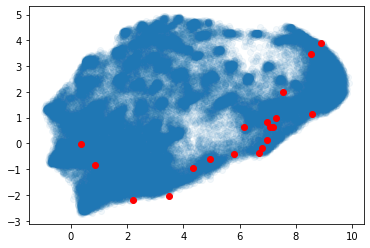

In [85]:
n_cells = len(dict_idx_spec)

dist_mat_refmean_scale = np.zeros((ref_spec_arr_mean_norm_scale.shape[0], n_cells))
for i, s_i in tqdm(enumerate(ref_spec_arr_mean_norm_scale)):
    s_i_sub = s_i
    for j, s_j in enumerate(dict_idx_spec.values()):
        # if j > i:
        s_j_sub = s_j
        dist_mat_refmean_scale[i,j] = fhc.channel_cosine_intensity_allonev2(s_i_sub, s_j_sub)

u_ref = fit.transform(dist_mat_refmean_scale)
plt.scatter(u[:,0], u[:,1], alpha=0.05)
plt.scatter(u_ref[:,0], u_ref[:,1], alpha=1, color='r')
plt.show()
plt.close()

## Filter spectra better

Keep all spectra that have two channels > 75 after subtracting the mean spectrum

In [ ]:
thresh_int = 75

bool_int_all = specs_meansub > thresh_int
bool_int_counts = np.sum(bool_int_all, axis=1)
bool_int = bool_int_counts > 1
print(specs_meansub.shape[0])
print(sum(bool_int))

50374
11353


Run clustering on high intensity spectra

In [ ]:
specs_high = specs_meansub[bool_int,:]

In [ ]:
dist_mat_high_cond = pdist(specs_high, fhc.channel_cosine_intensity_allonev2)
dist_mat_high_cond.shape

(64439628,)

In [ ]:
dist_mat_high = squareform(dist_mat_high_cond)

In [ ]:
linkage = hierarchy.linkage(dist_mat_high_cond, method='complete')


/home/bmg224/miniconda3/envs/hiprfish_imaging_py38/lib/python3.8/site-packages/umap/umap_.py:1780: UserWarning: using precomputed metric; inverse_transform will be unavailable
  warn("using precomputed metric; inverse_transform will be unavailable")


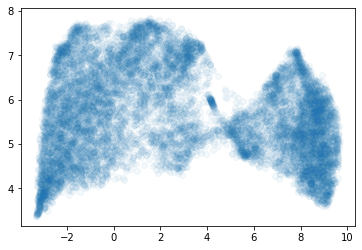

In [ ]:
fit = umap.UMAP(metric='precomputed', n_neighbors=100, min_dist=0.1).fit(dist_mat_high)
u = fit.embedding_
plt.scatter(u[:,0], u[:,1], alpha=0.05)
plt.show()
plt.close()

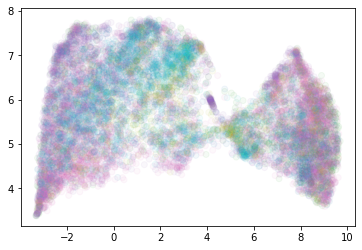

In [ ]:
idx_sni_high = idx_sni[bool_int]
plt.scatter(u[:,0], u[:,1], c=idx_sni_high, alpha=0.05, cmap='tab10')
plt.show()
plt.close()

1.0


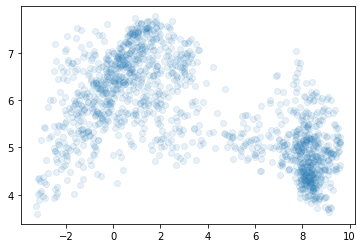

2.0


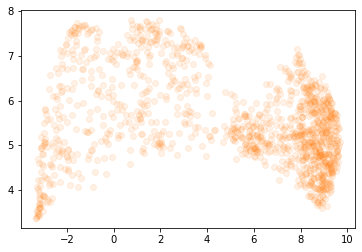

3.0


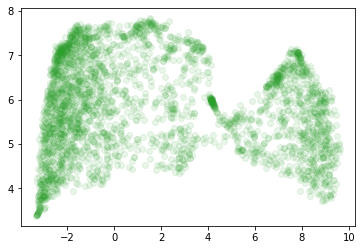

4.0


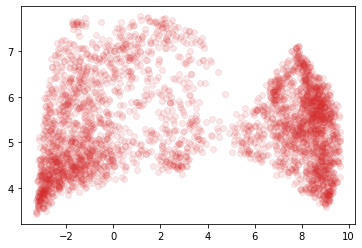

5.0


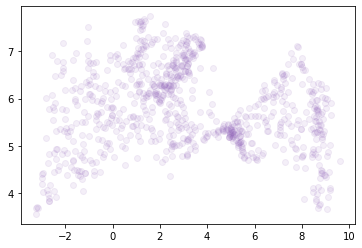

6.0


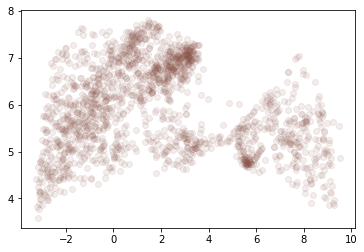

In [ ]:
for sni, col in zip(np.unique(idx_sni_high), plt.get_cmap('tab10').colors):
    print(sni)
    bool_sni = idx_sni_high == sni
    u_ = u[bool_sni,:]
    plt.scatter(u_[:,0], u_[:,1], alpha=0.1, color=col)
    plt.show()
    plt.close()

In [178]:
dict_idxhigh_spec = dict(zip(np.arange(dist_mat_high.shape[0]), specs_high))

19it [00:00, 102.39it/s]
/home/bmg224/miniconda3/envs/hiprfish_imaging_py38/lib/python3.8/site-packages/umap/umap_.py:2830: UserWarning: Transforming new data with precomputed metric. We are assuming the input data is a matrix of distances from the new points to the points in the training set. If the input matrix is sparse, it should contain distances from the new points to their nearest neighbours or approximate nearest neighbours in the training set.
  warn(


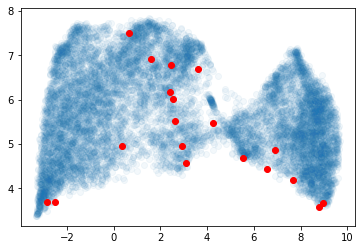

In [199]:
n_cells = dist_mat_high.shape[0]
dist_mat_refmean_scale = np.zeros((ref_spec_arr_mean.shape[0], n_cells))
for i, s_i in tqdm(enumerate(ref_spec_arr_mean)):
    s_i_sub = s_i
    for j, s_j in enumerate(dict_idxhigh_spec.values()):
        # if j in idx_high:
        s_j_sub = s_j
        dist_mat_refmean_scale[i,j] = fhc.channel_cosine_intensity_allonev2(s_i_sub, s_j_sub)

u_ref_mean_scale = fit.transform(dist_mat_refmean_scale)
plt.scatter(u[:,0], u[:,1], alpha=0.05)
plt.scatter(u_ref_mean_scale[:,0], u_ref_mean_scale[:,1], alpha=1, color='r')
plt.show()
plt.close()

In [201]:
n_cells = dist_mat_high.shape[0]
dist_mat_ref = np.zeros((ref_spec_arr.shape[0], n_cells))
for i, s_i in tqdm(enumerate(ref_spec_arr)):
    s_i_sub = s_i
    for j, s_j in enumerate(dict_idxhigh_spec.values()):
        # if j in idx_high:
        s_j_sub = s_j
        dist_mat_ref[i,j] = fhc.channel_cosine_intensity_allonev2(s_i_sub, s_j_sub)



8127it [01:19, 101.98it/s]
/home/bmg224/miniconda3/envs/hiprfish_imaging_py38/lib/python3.8/site-packages/umap/umap_.py:2830: UserWarning: Transforming new data with precomputed metric. We are assuming the input data is a matrix of distances from the new points to the points in the training set. If the input matrix is sparse, it should contain distances from the new points to their nearest neighbours or approximate nearest neighbours in the training set.
  warn(


In [202]:
u_ref = fit.transform(dist_mat_ref)


/home/bmg224/miniconda3/envs/hiprfish_imaging_py38/lib/python3.8/site-packages/umap/umap_.py:2830: UserWarning: Transforming new data with precomputed metric. We are assuming the input data is a matrix of distances from the new points to the points in the training set. If the input matrix is sparse, it should contain distances from the new points to their nearest neighbours or approximate nearest neighbours in the training set.
  warn(


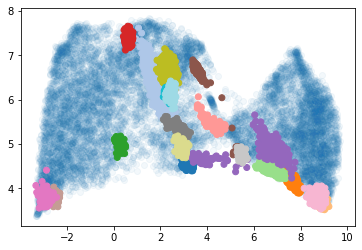

In [203]:
ref_spec_idxs = []
for i,s in enumerate(ref_spec):
    ref_spec_idxs += [i]*s.shape[0]

plt.scatter(u[:,0], u[:,1], alpha=0.05)
plt.scatter(u_ref[:,0], u_ref[:,1], alpha=1, c=ref_spec_idxs, cmap='tab20')
plt.show()
plt.close()

In [194]:
n_clust = 19
agg = AgglomerativeClustering(n_clusters=n_clust, affinity='precomputed', linkage='complete')

agg.fit(dist_mat_high)

clust_agg = agg.labels_

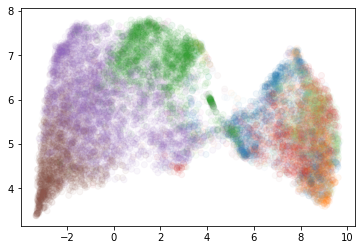

In [196]:
plt.scatter(u[:,0], u[:,1], c=clust_agg, alpha=0.05, cmap='tab20')
plt.show()
plt.close()

## Classify with training dataset from Hao's code
### Train classifier
Get trainign dataset

In [19]:
config_hipr_fn = 'config_hipr.yaml'
with open(config_hipr_fn, 'r') as f:
    config_hipr = yaml.safe_load(f)

In [20]:
train_obj = fhc.Training_Data(config=config_hipr, version='5bit')

In [21]:
training_data, training_data_neg = train_obj.get_training_data()

Calculating FRET efficiency...
Building training data...


Train umap transform

In [22]:
params = fhc.get_5b_params()

In [23]:
umap_transform = umap.UMAP(n_neighbors = 25, metric = fhc.channel_cosine_intensity_5b_v2).fit(training_data[:,0:60], y = training_data[:,60])

/home/bmg224/miniconda3/envs/hiprfish_imaging_py38/lib/python3.8/site-packages/umap/umap_.py:1772: UserWarning: custom distance metric does not return gradient; inverse_transform will be unavailable. To enable using inverse_transform method, define a distance function that returns a tuple of (distance [float], gradient [np.array])
  warn(


/home/bmg224/miniconda3/envs/hiprfish_imaging_py38/lib/python3.8/site-packages/sklearn/utils/validation.py:72: FutureWarning: Beginning in version 0.22, arrays of bytes/strings will be converted to decimal numbers if dtype='numeric'. It is recommended that you convert the array to a float dtype before using it in scikit-learn, for example by using your_array = your_array.astype(np.float64).
  return f(**kwargs)


In [24]:
barcodes = np.unique(training_data[:,60]).tolist()

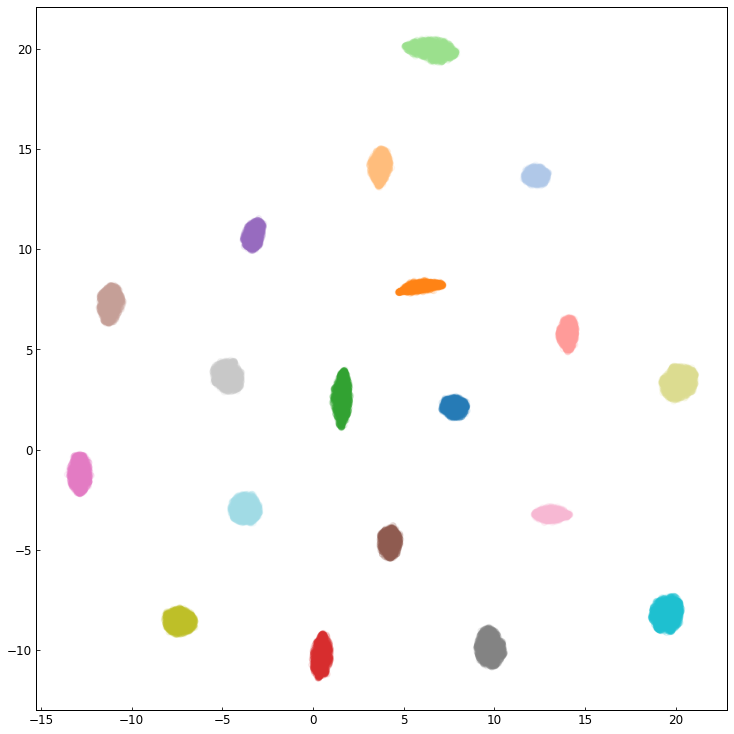

In [25]:
u_ref = umap_transform.embedding_

cmap='tab20'
dict_bc_idx = dict(zip(barcodes, np.arange(len(barcodes))))
ref_idx = [dict_bc_idx[bc] for bc in training_data[:,60]]
dict_bc_col = dict(zip(barcodes, plt.get_cmap(cmap).colors))

fig, ax = ip.general_plot(dims=(10,10))
ax.scatter(u_ref[:,0], u_ref[:,1], c=ref_idx, alpha=0.1, cmap='tab20')
plt.show()
plt.close()


In [26]:
u_neg = umap_transform.transform(training_data_neg[:,0:60])

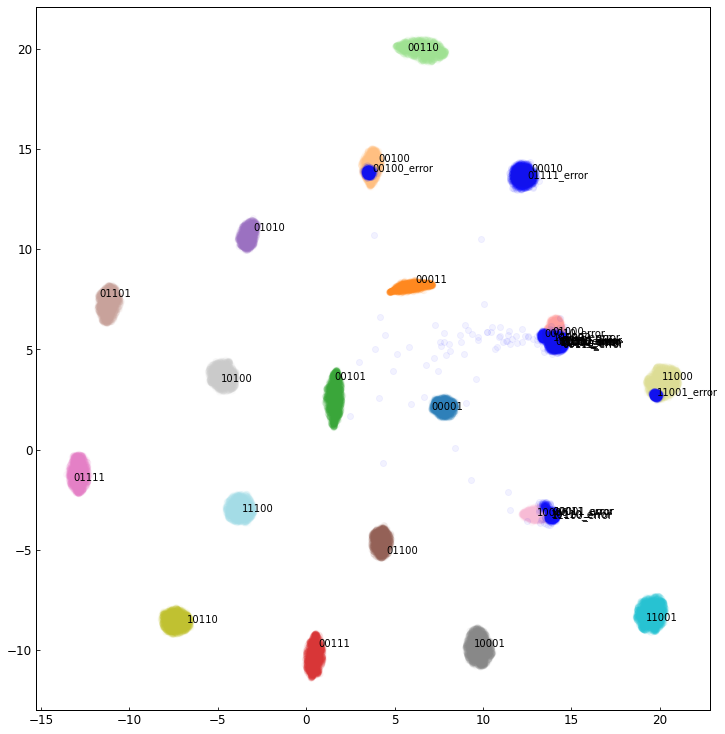

In [27]:
fig, ax = ip.general_plot(dims=(10,10))
ax.scatter(u_ref[:,0], u_ref[:,1], c=ref_idx, alpha=0.05, cmap='tab20')
for bc in barcodes:
    bool_bc = training_data[:,60] == bc
    idx = np.where(bool_bc)[0][0]
    ax.text(u_ref[idx,0], u_ref[idx,1], bc)
ax.scatter(u_neg[:,0], u_neg[:,1], alpha=0.05, color='b')
for bc in np.unique(training_data_neg[:,60]):
    bool_bc = training_data_neg[:,60] == bc
    idx = np.where(bool_bc)[0][0]
    ax.text(u_neg[idx,0], u_neg[idx,1], bc)
plt.show()
plt.close()

Train laser-present classifier

In [28]:
training_data_full = np.vstack([training_data, training_data_neg])
scaler_full = preprocessing.StandardScaler().fit(training_data_full[:,0:57])
training_data_full_scaled = scaler_full.transform(training_data_full[:,0:57])

In [ ]:
spec_dims = (10,5)

for c in np.unique(training_data_full[:,60]):
    print('Cluster:', c)
    bool_c = training_data_full[:,60] == c
    spec_sub = training_data_full_scaled[bool_c,:]

    fig, ax = ip.general_plot(dims=spec_dims)
    try:
        color = dict_bc_col[c]
    except:
        color = (0.5,0.5,0.5)
    # color = dict_clust_col[c]
    fsi.plot_cell_spectra(ax, spec_sub, {'lw':1,'alpha':0.2,'color':color})
    # ax.set_ylim(0,12500)
    # ax.set_ylim(0,2**16)
    plt.plot()
    plt.show()

In [30]:
nlasers = 3
clf = [svm.SVC(C = 10, gamma = 1) for i in range(nlasers)]
clf[0].fit(training_data_full_scaled[:,0:23], training_data_full[:,57])
clf[1].fit(training_data_full_scaled[:,23:43], training_data_full[:,58])
clf[2].fit(training_data_full_scaled[:,43:57], training_data_full[:,59])
# clf[3].fit(training_data_full_scaled[:,57:63], training_data_full.c4.values)



SVC(C=10, gamma=1)

Train SVM umap transform classifier

In [256]:
clf_umap = svm.SVC(C = 10, gamma = 1, probability = True)
clf_umap.fit(umap_transform.embedding_, training_data[:,60])

SVC(C=10, gamma=1, probability=True)

### Classify data
Get laserpresent columns on data

In [268]:
scaler_specs = preprocessing.StandardScaler().fit(specs_meansub)
specs_meansub_scale = scaler_full.transform(specs_meansub)

In [271]:
specs_meansub_laspresent = specs_meansub.copy()
ci = params['channel_indices']
for i, clf_ in enumerate(clf):
    laspresent = clf_.predict(specs_meansub_scale[:,ci[i]:ci[i+1]])[:,None]
    specs_meansub_laspresent = np.hstack([specs_meansub_laspresent,laspresent])
specs_meansub_laspresent.shape

(50374, 60)

UMAP Transform on data

In [272]:
specs_meansub_transform = umap_transform.transform(specs_meansub_laspresent)

In [301]:
u_specs = specs_meansub_transform

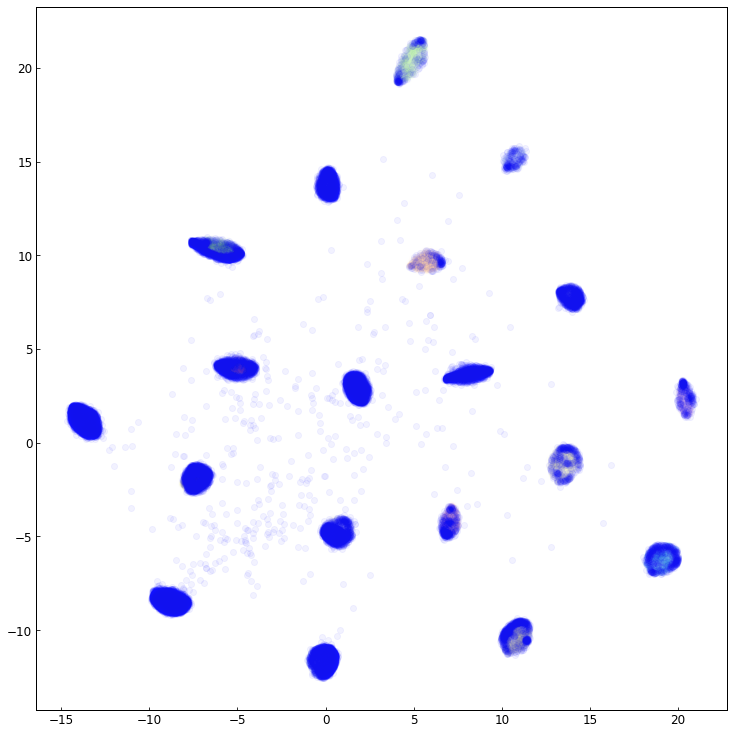

In [275]:


fig, ax = ip.general_plot(dims=(10,10))
ax.scatter(u_ref[:,0], u_ref[:,1], c=ref_idx, alpha=0.01, cmap='tab20')
ax.scatter(u_specs[:,0], u_specs[:,1], alpha=0.05, color='b')

plt.show()
plt.close()

Run SVM umap transform classifier on data

In [297]:
classif_svc = clf_umap.predict(u_specs)
print(classif_svc.shape)
print(classif_svc[:10])

(50374,)
['10110' '00111' '01100' '00101' '01111' '01111' '00101' '01101' '00111'
 '10110']


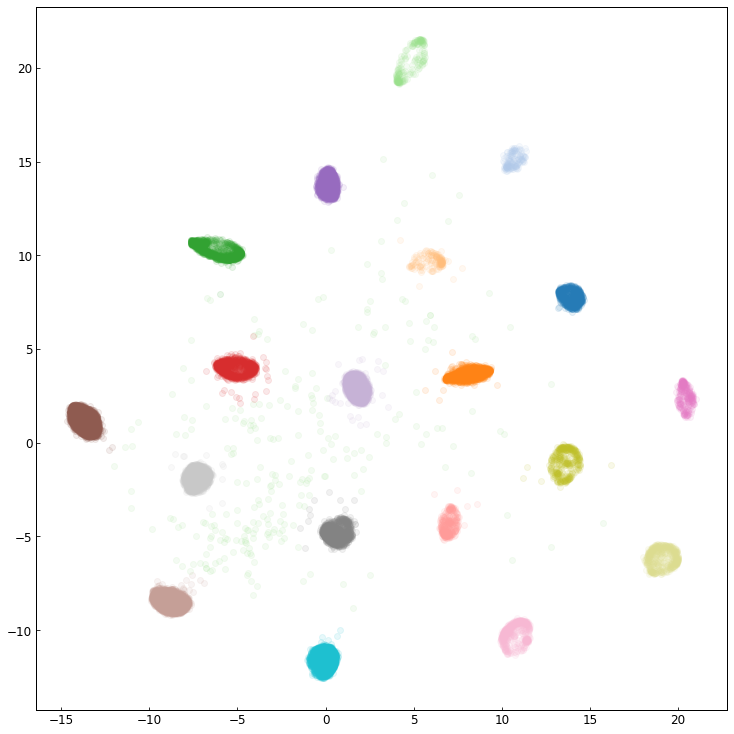

In [300]:
fig, ax = ip.general_plot(dims=(10,10))
for bc in barcodes:
    color = dict_bc_col[bc]
    bool_bc = classif_svc == bc
    u_sub = u_specs[bool_bc,:]
    ax.scatter(u_sub[:,0], u_sub[:,1], color=color, alpha=0.1)

plt.show()
plt.close()

Filter distant spectra

In [ ]:
nbrs = nb.NearestNeighbors(n_neighbors=1, algorithm='kd_tree').fit(u_ref)
nn_dists, nn_indices = nbrs.kneighbors(u_specs)

50374
[49995]


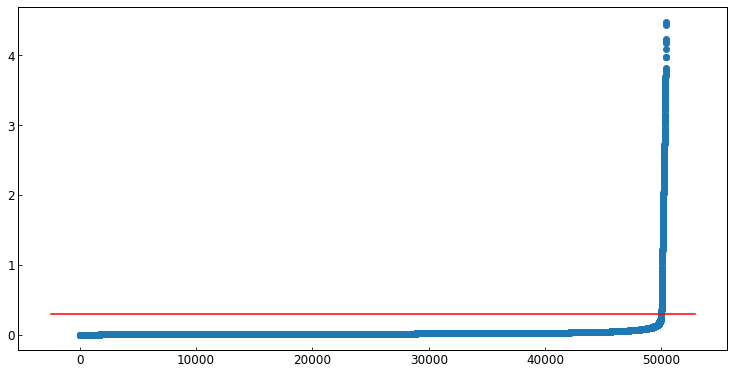

In [334]:
thresh_dist=0.3

nn_dists_sort = np.sort(nn_dists.squeeze())

fig, ax = ip.general_plot(dims=(10,5))
ax.scatter(np.arange(len(nn_dists_sort)), nn_dists_sort)
xl = ax.get_xlim()
ax.plot(xl, [thresh_dist]*2, 'r')

print(len(nn_dists))
print(sum(nn_dists < thresh_dist))

In [335]:
bool_dist = nn_dists.squeeze() > thresh_dist

In [336]:
classif_svc_filt = classif_svc.copy()
classif_svc_filt[bool_dist] = 'unclassified'

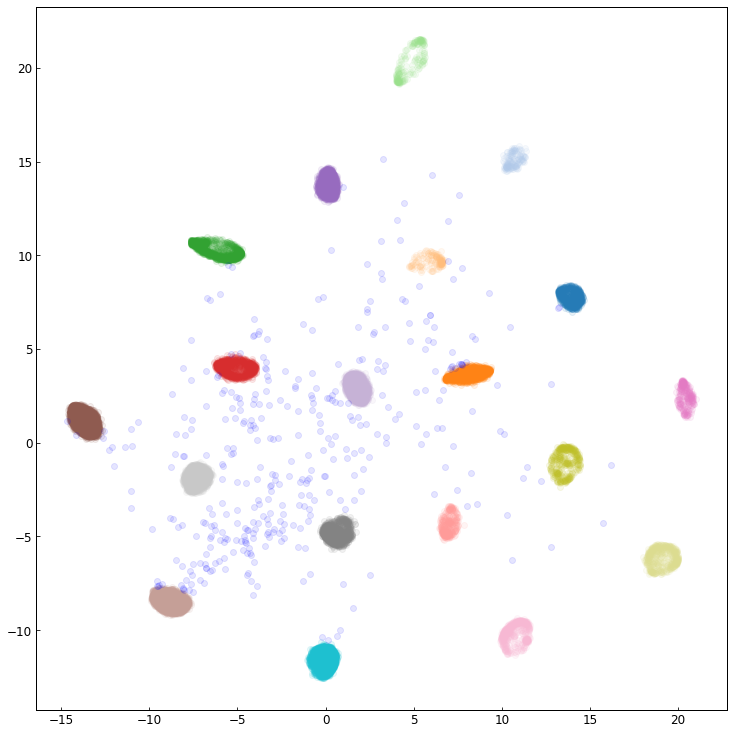

In [340]:
dict_bc_col['unclassified'] = (0,0,1)
barcodes_unc = barcodes + ['unclassified']

fig, ax = ip.general_plot(dims=(10,10))
for bc in barcodes_unc:
    color = dict_bc_col[bc]
    bool_bc = classif_svc_filt == bc
    u_sub = u_specs[bool_bc,:]
    ax.scatter(u_sub[:,0], u_sub[:,1], color=color, alpha=0.1)

plt.show()
plt.close()

Save the classification

In [353]:
k, v = {'a':[1,2,3],'b':[4,5,6]}.items()
print(k)
print(v)

('a', [1, 2, 3])
('b', [4, 5, 6])


In [354]:
dict_sn_m_lab_cl = defaultdict(dict)
for sn, dict_mil in dict_sn_m_idx_lab.items():
    for m, dict_il in dict_mil.items():
        idx = list(dict_il.keys())
        labels = list(dict_il.values())
        classif_svc_sn = classif_svc[idx]
        dict_sn_m_lab_cl[sn][m] = dict(zip(labels,classif_svc_sn))

In [ ]:
spec_dims = (10,5)


for c in barcodes_unc:
    try:
        sciname = dict_bc_sciname[c]
    except:
        sciname = c
    print('Classification:', sciname)
    bool_c = classif_svc_filt == c
    spec_sub = specs_arr[bool_c,:]

    spec_sub_meansub = spec_sub - specs_mean
    spec_sub_meansub[spec_sub_meansub < 0] = 0

    fig, ax = ip.general_plot(dims=spec_dims)
    color = dict_bc_col[c]
    fsi.plot_cell_spectra(ax, spec_sub_meansub, {'lw':1,'alpha':0.2,'color':color})
    # ax.set_ylim(0,12500)
    # ax.set_ylim(0,2**16)
    plt.plot()
    plt.show()

In [356]:
classif_dir = config['output_dir'] + '/classif_svc'
if not os.path.exists(classif_dir):
    os.makedirs(classif_dir)
    print('Created dir:', classif_dir)
classif_fn = classif_dir + '/dict_sn_m_label_classif.yaml'
with open(classif_fn, 'w') as f:
    yaml.dump(dict_sn_m_lab_cl, f)
print('Wrote:', classif_fn) 

Created dir: ../../../outputs/bmg_plasmids_imaging/2023_11_22_newplasmid/agglomerative_cluster/classif_svc
Wrote: ../../../outputs/bmg_plasmids_imaging/2023_11_22_newplasmid/agglomerative_cluster/classif_svc/dict_sn_m_label_classif.yaml


### View classif on image


In [346]:
sn='2023_11_22_newplasmid_sample_bmg_fov_03'
m='3'

classif_svc_sn = classif_svc[list(dict_sn_m_idx_lab[sn][m].keys())]
labels_sn = np.array(list(dict_sn_m_idx_lab[sn][m].values()))
dict_lab_clust = dict(zip(labels_sn, classif_svc_sn))

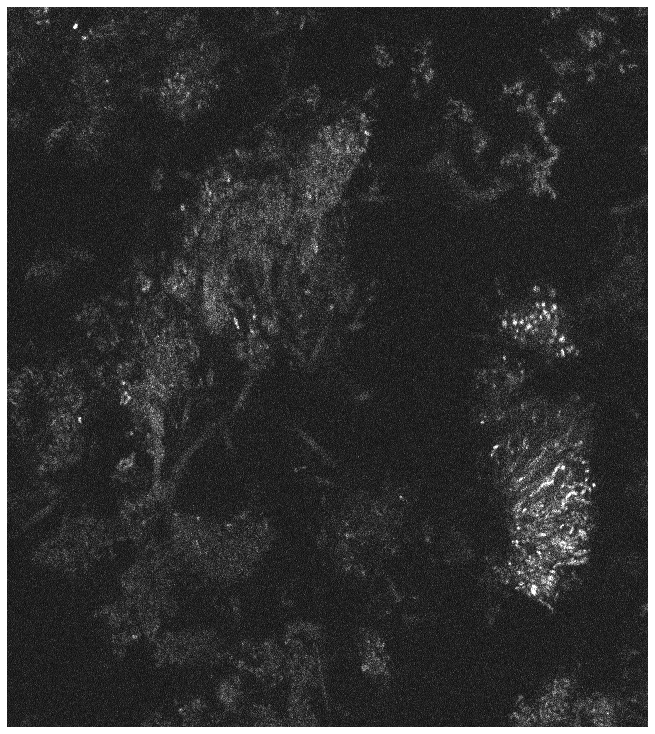

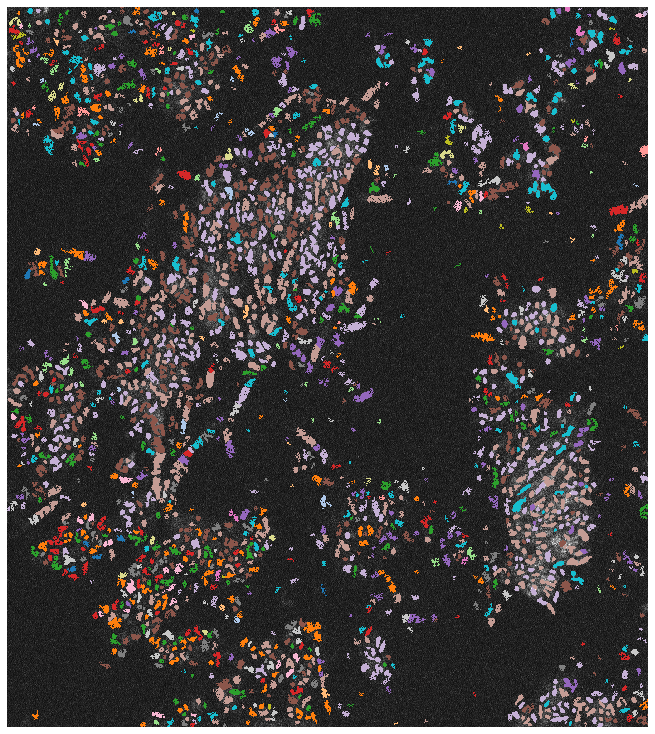

In [348]:
mx = np.max(stack_sum)*0.5
# mx = 60000
mn = np.min(stack_sum)
im_norm = np.clip(stack_sum,mn,mx)
im_norm = (im_norm - mn) / (mx - mn)
im_rgb = im_norm[:,:,None] * np.array([1,1,1])[None,:]
im_rgb = np.dstack([im_rgb, np.ones(im_rgb.shape[:2])])
fig, ax, _ = ip.plot_image(im_rgb, im_inches=10)
plt.show()
plt.close()


for i, row in props.iterrows():
    l = row.label
    if l in labels_sn:
        b = row.bbox
        b = eval(b) if isinstance(b, str) else b
        rgb_sub = im_rgb[b[0]:b[2],b[1]:b[3]]
        seg_sub = seg[b[0]:b[2],b[1]:b[3]] == l
        im_sub = im_norm[b[0]:b[2],b[1]:b[3]]
        cl = dict_lab_clust[l]
        color = np.array(dict_bc_col[cl] + (1,))
        # rgb_noncell =  rgb_sub * np.dstack([~seg_sub]*3 + np.ones_like(seg_sub))
        rgb_noncell =  rgb_sub * np.dstack([~seg_sub]*4)
        # rgb_cell = (im_sub * seg_sub)[:,:,None] * color[None,:]
        rgb_cell = seg_sub[:,:,None] * color[None,:]
        im_rgb[b[0]:b[2],b[1]:b[3],:] = rgb_noncell + rgb_cell

fig, ax, cbar = ip.plot_image(im_rgb, im_inches=10)

### Save all classif projections

Pick black white limit

In [368]:
bn = '{}_M_{}'
sum_vals = []
for sn in tqdm(dict_group_czifns.keys()):
    ms = Ms[sn]
    for m in ms:
        # Get filenames
        bn_ = bn.format(sn,m)
        stack_fn = [fn for fn in stack_fns[sn] if bn_ in fn][0]


        # Load files
        stack = np.load(stack_fn)
        # with open(spec_fn, 'r') as f:
        #     dict_lab_spec = yaml.unsafe_load(f)  

        # Grayscale image
        sum_vals += np.sum(stack, axis=2).ravel().tolist()

100%|██████████| 6/6 [03:34<00:00, 35.69s/it]


In [371]:
sum_vals[:10]

[5120.0,
 7060.0,
 5929.0,
 6031.0,
 4908.0,
 4623.0,
 6506.0,
 6374.0,
 9042.0,
 5575.0]

In [ ]:
sum_vals_sub = np.random.choice(sum_vals, size=choice_size, replace=False)
sum_vals_sub_sort = np.sort(sum_vals_sub)

(0.0, 100000.0)

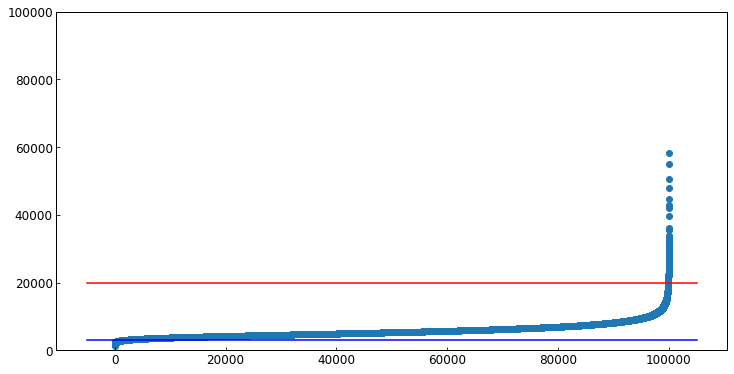

In [398]:
clims = (3000,20000)

choice_size = int(1e5)

fig, ax = ip.general_plot(dims=(10,5))
ax.scatter(np.arange(len(sum_vals_sub_sort)), sum_vals_sub_sort)
xl = ax.get_xlim()
ax.plot(xl, [clims[0]]*2, 'b')
ax.plot(xl, [clims[1]]*2, 'r')
ax.set_ylim(0,1e5)

In [ ]:
czifn = dict_group_czifns[sn][0]
czi = aplc.CziFile(czifn)
for n in czi.meta.iter():
    if 'Scaling' in n.tag:
        if 'X' in n.tag:
            resolution = float(n.text)
res_pixum = resolution * 1e6
print(resolution)
print(res_pixum)

5.990374007588672e-08
0.05990374007588672


In [ ]:

bn = '{}_M_{}'
for sn in dict_group_czifns.keys():
    ms = Ms[sn]
    for m in ms:
        # Get filenames
        bn_ = bn.format(sn,m)
        stack_fn = [fn for fn in stack_fns[sn] if bn_ in fn][0]
        props_fn = [fn for fn in props_fns[sn] if bn_ in fn][0]
        seg_fn = [fn for fn in seg_fns[sn] if bn_ in fn][0]
        spec_fn = [fn for fn in spec_fns[sn] if bn_ in fn][0]

        # Load files
        stack = np.load(stack_fn)
        # props = pd.read_csv(props_fn)
        # seg = np.load(seg_fn)
        # with open(spec_fn, 'r') as f:
        #     dict_lab_spec = yaml.unsafe_load(f)  

        # Grayscale image
        stack_sum = np.sum(stack, axis=2)
        # stack_max = np.max(stack, axis=2)
        # mx = np.max(stack_sum)*gray_scaler[1]  # Adjust upper limit on grayscale
        # mn = np.min(stack_sum)*gray_scaler[0]  # Adjust lower limit on grayscel
        mn, mx = clims
        # im_norm = np.clip(stack_max,mn,mx)
        im_norm = np.clip(stack_sum,mn,mx)
        im_norm = (im_norm - mn) / (mx - mn)
        im_rgb = im_norm[:,:,None] * np.array([1,1,1])[None,:]
        im_rgb = np.dstack([im_rgb, np.ones(im_rgb.shape[:2])])
        fig, ax, _ = ip.plot_image(im_rgb, im_inches=10, scalebar_resolution=res_pixum)
        # fig, ax, _ = ip.plot_image(im_norm, im_inches=10, cmap='gray')
        out_sn_dir = classif_dir + '/' + sn        
        if not os.path.exists(out_sn_dir):
            os.makedirs(out_sn_dir)
            print('Created dir:', out_sn_dir)
        out_bn = out_sn_dir + '/' + bn.format(sn,m) + '_sum_grayscale'
        ip.save_png_pdf(out_bn)
        plt.show()
        plt.close()    





In [ ]:
bn = '{}_M_{}'
for sn in dict_group_czifns.keys():
    ms = Ms[sn]
    for m in ms:
        # Get filenames
        bn_ = bn.format(sn,m)
        stack_fn = [fn for fn in stack_fns[sn] if bn_ in fn][0]
        props_fn = [fn for fn in props_fns[sn] if bn_ in fn][0]
        seg_fn = [fn for fn in seg_fns[sn] if bn_ in fn][0]
        spec_fn = [fn for fn in spec_fns[sn] if bn_ in fn][0]

        # Load files
        stack = np.load(stack_fn)
        props = pd.read_csv(props_fn)
        seg = np.load(seg_fn)
        # with open(spec_fn, 'r') as f:
        #     dict_lab_spec = yaml.unsafe_load(f)  

        # Grayscale image
        stack_sum = np.sum(stack, axis=2)
        # stack_max = np.max(stack, axis=2)
        # mx = np.max(stack_sum)*gray_scaler[1]  # Adjust upper limit on grayscale
        # mn = np.min(stack_sum)*gray_scaler[0]  # Adjust lower limit on grayscel
        mn, mx = clims
        # im_norm = np.clip(stack_max,mn,mx)
        im_norm = np.clip(stack_sum,mn,mx)
        im_norm = (im_norm - mn) / (mx - mn)
        im_rgb = im_norm[:,:,None] * np.array([1,1,1])[None,:]
        im_rgb = np.dstack([im_rgb, np.ones(im_rgb.shape[:2])])

        # Get classif dict
        classif_svc_sn = classif_svc[list(dict_sn_m_idx_lab[sn][m].keys())]
        labels_sn = np.array(list(dict_sn_m_idx_lab[sn][m].values()))
        dict_lab_clust = dict(zip(labels_sn, classif_svc_sn))

        # recolor seg
        for i, row in props.iterrows():
            l = row.label
            if l in labels_sn:
                b = row.bbox
                b = eval(b) if isinstance(b, str) else b
                rgb_sub = im_rgb[b[0]:b[2],b[1]:b[3]]
                seg_sub = seg[b[0]:b[2],b[1]:b[3]] == l
                im_sub = im_norm[b[0]:b[2],b[1]:b[3]]
                cl = dict_lab_clust[l]
                color = np.array(dict_bc_col[cl] + (1,))
                # rgb_noncell =  rgb_sub * np.dstack([~seg_sub]*3 + np.ones_like(seg_sub))
                rgb_noncell =  rgb_sub * np.dstack([~seg_sub]*4)
                # rgb_cell = (im_sub * seg_sub)[:,:,None] * color[None,:]
                rgb_cell = seg_sub[:,:,None] * color[None,:]
                im_rgb[b[0]:b[2],b[1]:b[3],:] = rgb_noncell + rgb_cell
        
        # Save
        fig, ax, cbar = ip.plot_image(im_rgb, im_inches=10, scalebar_resolution=res_pixum)
        out_sn_dir = classif_dir + '/' + sn        
        if not os.path.exists(out_sn_dir):
            os.makedirs(out_sn_dir)
            print('Created dir:', out_sn_dir)
        out_bn = out_sn_dir + '/' + bn.format(sn,m) + '_classif_svc'
        ip.save_png_pdf(out_bn)
        plt.show()
        plt.close()




## Use laspresent classifier to help clustering
Get spectra from specific image

In [121]:
sn = '2023_11_22_newplasmid_sample_bmg_fov_05'
m_h = 0


In [122]:
spec_fn = spec_fns[sn][m_h]
print(spec_fn)
with open(spec_fn, 'r') as f:
    dict_lab_spec = yaml.unsafe_load(f)

../../../outputs/bmg_plasmids_imaging/2023_11_22_newplasmid/agglomerative_cluster/2023_11_22_newplasmid_sample_bmg_fov_05/spectra/2023_11_22_newplasmid_sample_bmg_fov_05_M_0_spec.yaml


In [123]:
specs_sn_arr = np.array([s for s in dict_lab_spec.values()])
specs_sn_arr.shape

(2147, 57)

Get laserpresent columns on data

In [124]:
scaler_specs_sn = preprocessing.StandardScaler().fit(specs_sn_arr)
specs_sn_scaled = scaler_specs_sn.transform(specs_sn_arr)

In [125]:
specs_sn_laspresent = specs_sn_arr.copy()
ci = params['channel_indices']
for i, clf_ in enumerate(clf):
    laspresent = clf_.predict(specs_sn_scaled[:,ci[i]:ci[i+1]])[:,None]
    specs_sn_laspresent = np.hstack([specs_sn_laspresent,laspresent])
specs_sn_laspresent = specs_sn_laspresent.astype(np.float64) 
specs_sn_laspresent.shape

(2147, 60)

In [127]:
laspresent_arr = specs_sn_laspresent[:,57:].copy()
laspresent_arr_adj = np.max(specs_sn_arr, axis=1)[:,None] * laspresent_arr
specs_sn_laspresent_adj = np.hstack([specs_sn_arr, laspresent_arr_adj])
specs_sn_laspresent_adj[0]

array([112.28504673, 107.01401869, 120.47663551, 106.74766355,
       157.4953271 , 158.15420561, 174.91588785, 129.85514019,
       100.22429907, 150.94859813, 120.26168224, 106.36448598,
       100.8364486 , 100.17757009, 110.06074766, 101.65420561,
       106.86448598,  96.41121495,  62.04672897, 118.6588785 ,
       113.46261682, 112.1682243 ,  99.40186916,  96.25233645,
       111.94392523, 136.3411215 , 155.81308411, 180.97196262,
       197.42056075, 188.43925234, 170.44392523, 177.61682243,
       212.62149533, 120.28504673, 136.5       , 134.92056075,
       144.24766355, 141.81775701,  91.05607477, 119.12149533,
       115.02336449, 103.73831776, 100.38785047,  75.65420561,
        92.91121495,  81.72897196,  87.        ,  70.93925234,
       136.68224299,  89.59813084, 105.13084112, 115.8411215 ,
        84.39252336, 100.6728972 ,  99.88317757, 114.21962617,
        88.88785047, 212.62149533, 212.62149533,   0.        ])

Get distances on new array

In [128]:
dist_mat_cond = pdist(specs_sn_laspresent_adj, fhc.channel_cosine_intensity_5b_v2)


In [129]:
dist_mat = squareform(dist_mat_cond)

In [130]:
linkage = hierarchy.linkage(dist_mat_cond, method='complete')

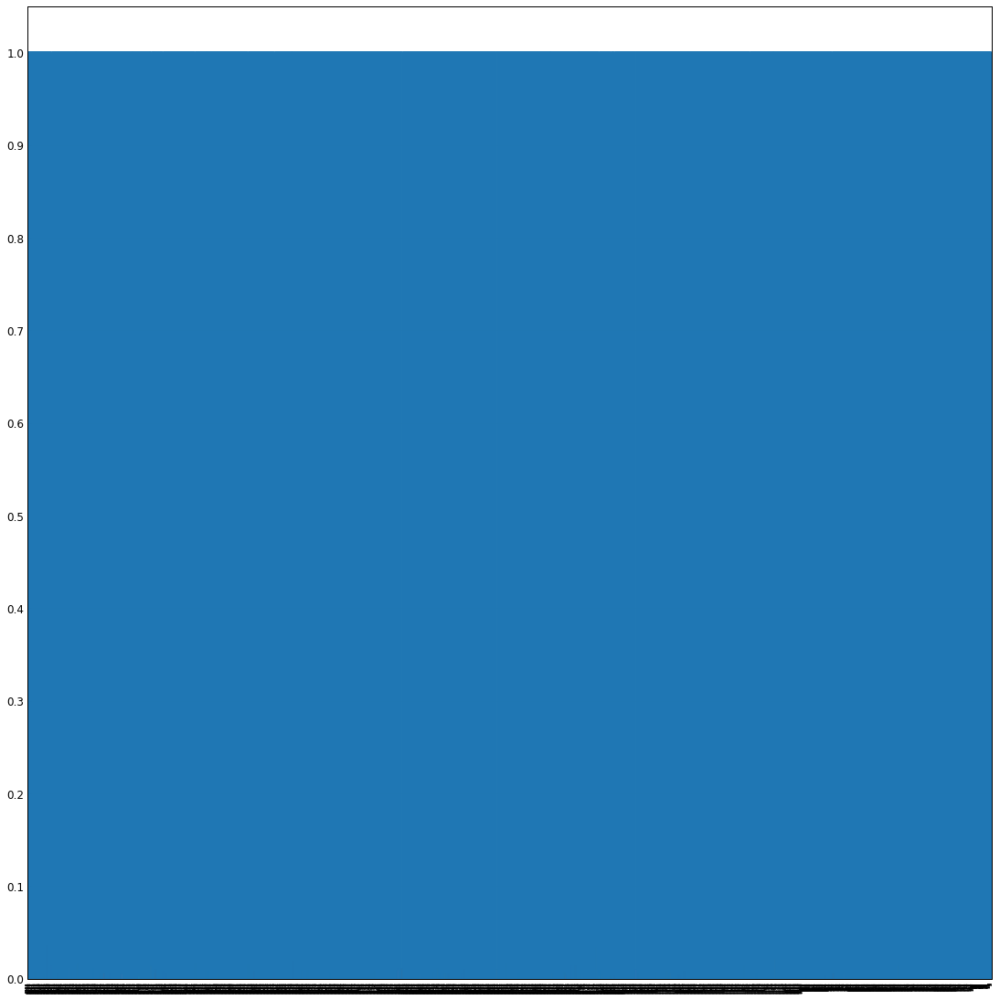

In [93]:
labels = list(dict_lab_spec.keys())

fig, ax = ip.general_plot(dims=(15,15))
dn = hierarchy.dendrogram(linkage, labels=labels, truncate_mode=None)
# dn = hierarchy.dendrogram(linkage, labels=inds, truncate_mode='lastp')
# ax.axhline(t[i])
ylims = [round(l,2) for l in ax.get_ylim()]
ax.set_yticks(np.arange(ylims[0],ylims[1],0.1))
ax.grid(axis='y')
plt.show()
plt.close()

/home/bmg224/miniconda3/envs/hiprfish_imaging_py38/lib/python3.8/site-packages/umap/umap_.py:1780: UserWarning: using precomputed metric; inverse_transform will be unavailable
  warn("using precomputed metric; inverse_transform will be unavailable")


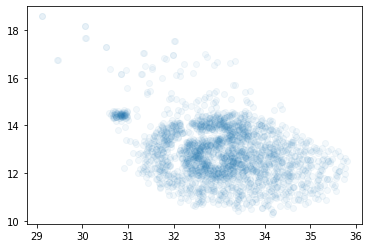

In [131]:
fit = umap.UMAP(metric='precomputed', n_neighbors=100, min_dist=0.1).fit(dist_mat)
u = fit.embedding_
plt.scatter(u[:,0], u[:,1], alpha=0.05)
plt.show()
plt.close()

Cluster

In [132]:
# dist_thr=0.1
# agg = AgglomerativeClustering(
#     n_clusters=None, 
#     distance_threshold=dist_thr,
#     affinity='precomputed', 
#     linkage='complete'
#     )
n_clust = 6
agg = AgglomerativeClustering(n_clusters=n_clust, affinity='precomputed', linkage='complete')

agg.fit(dist_mat)

clust_agg = agg.labels_

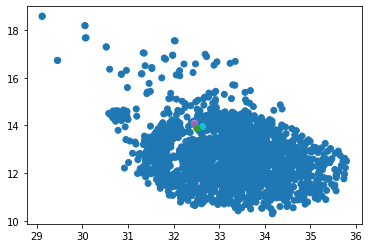

In [133]:
plt.scatter(u[:,0], u[:,1], c=clust_agg, alpha=1, cmap='tab10')
plt.show()
plt.close()

In [134]:
n_clust = np.max(clust_agg) + 1
colors = plt.get_cmap('tab10')(np.linspace(0,1,n_clust))
dict_clust_col = dict(zip(np.arange(n_clust), colors))

Cluster: 0


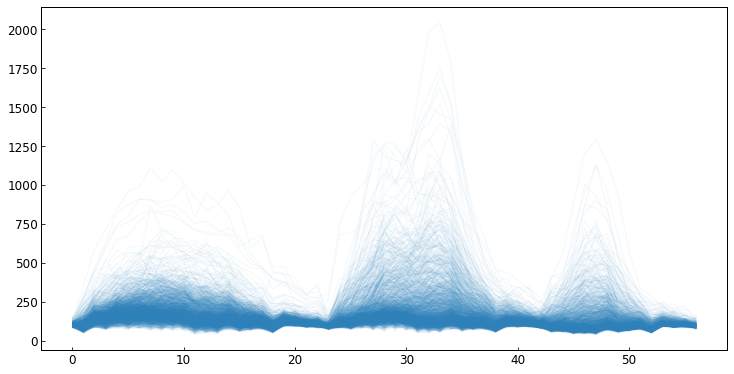

Cluster: 1


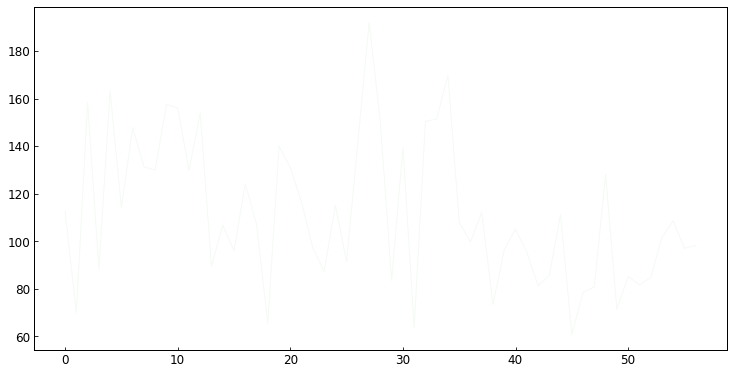

Cluster: 2


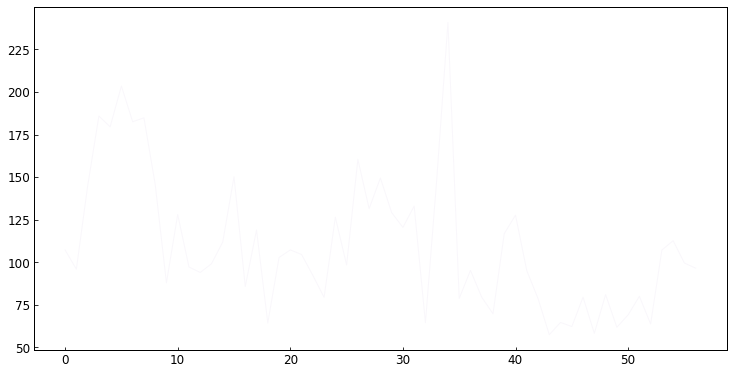

Cluster: 3


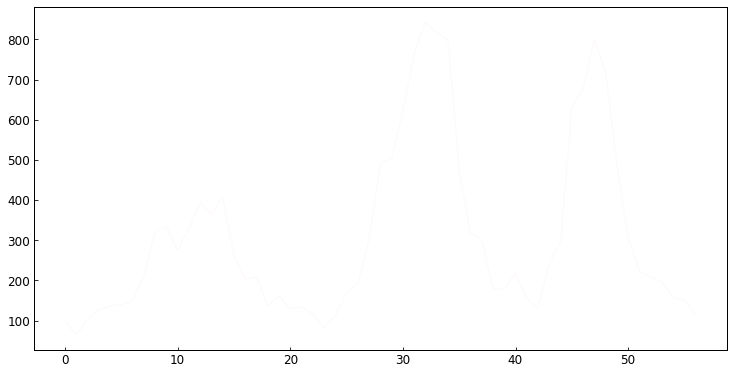

Cluster: 4


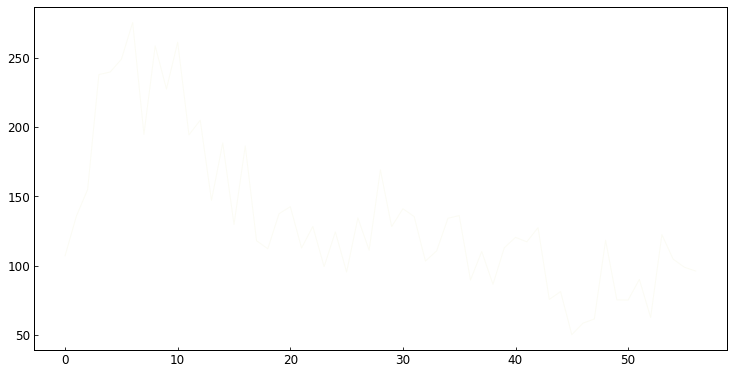

Cluster: 5


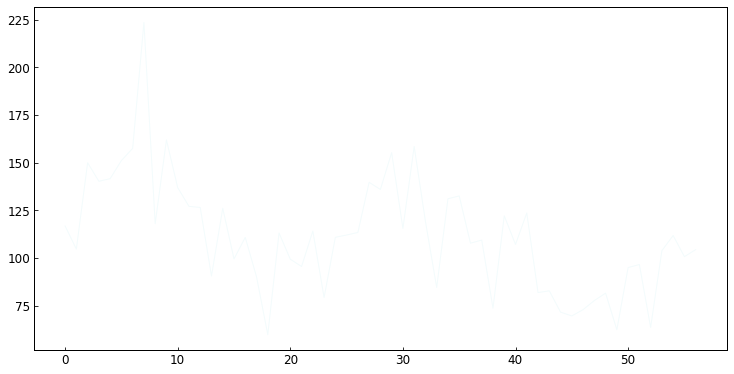

In [135]:
spec_dims = (10,5)


for c in np.unique(clust_agg):
    print('Cluster:', c)
    bool_c = clust_agg == c
    spec_sub = specs_sn_arr[bool_c,:]

    # spec_sub_meansub = spec_sub - specs_med
    # spec_sub_meansub[spec_sub_meansub < 0] = 0

    fig, ax = ip.general_plot(dims=spec_dims)
    color = dict_clust_col[c]
    fsi.plot_cell_spectra(ax, spec_sub, {'lw':1,'alpha':0.05,'color':color})
    # ax.set_ylim(0,12500)
    # ax.set_ylim(0,2**16)
    plt.plot()
    plt.show()

## Compare to clustering without laspresent

Get spectra from specific image

In [255]:
sn = "2024_01_10_bmgshort_slide_bmg_fov_01"
m_h = 2

In [256]:
spec_fn = spec_fns[sn][m_h]
print(spec_fn)
with open(spec_fn, 'r') as f:
    dict_lab_spec = yaml.unsafe_load(f)

../../../outputs/bmg_plasmids_imaging/2024_01_10_bmgshort/2024_01_10_bmgshort_slide_bmg_fov_01/spectra/2024_01_10_bmgshort_slide_bmg_fov_01_M_2_spec.yaml


In [257]:
specs_sn_arr = np.array([s for s in dict_lab_spec.values()])
specs_sn_arr.shape

(6339, 57)

Get distances

In [258]:
dist_mat_cond = pdist(specs_sn_arr, fhc.channel_cosine_intensity_allonev2)


In [259]:
dist_mat = squareform(dist_mat_cond)

In [174]:
linkage = hierarchy.linkage(dist_mat_cond, method='complete')

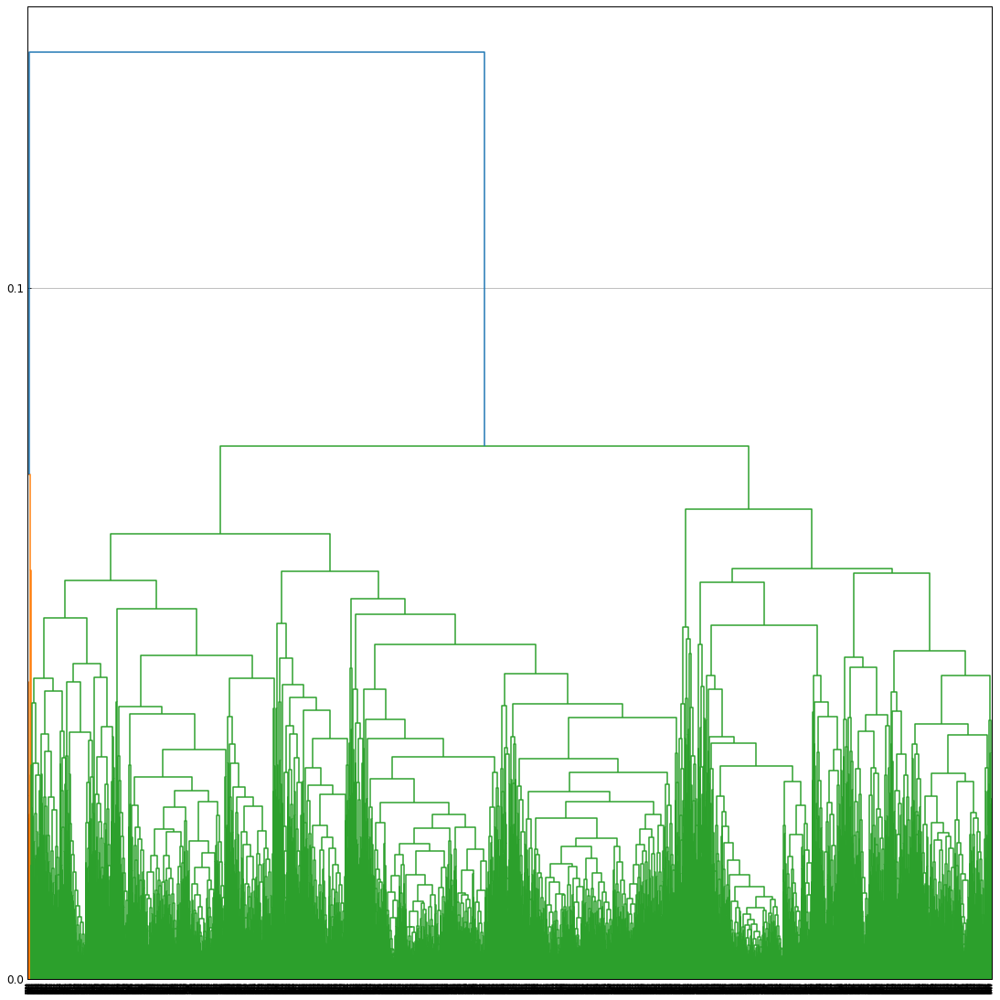

In [569]:
labels = list(dict_lab_spec.keys())

fig, ax = ip.general_plot(dims=(15,15))
dn = hierarchy.dendrogram(linkage, labels=labels, truncate_mode=None)
# dn = hierarchy.dendrogram(linkage, labels=inds, truncate_mode='lastp')
# ax.axhline(t[i])
ylims = [round(l,2) for l in ax.get_ylim()]
ax.set_yticks(np.arange(ylims[0],ylims[1],0.1))
ax.grid(axis='y')
plt.show()
plt.close()

/home/bmg224/miniconda3/envs/hiprfish_imaging_py38/lib/python3.8/site-packages/umap/umap_.py:1780: UserWarning: using precomputed metric; inverse_transform will be unavailable
  warn("using precomputed metric; inverse_transform will be unavailable")


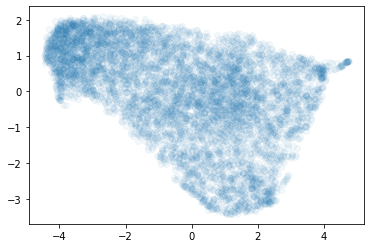

In [260]:
fit = umap.UMAP(metric='precomputed', n_neighbors=100, min_dist=0.1).fit(dist_mat)
u = fit.embedding_
plt.scatter(u[:,0], u[:,1], alpha=0.05)
plt.show()
plt.close()

Cluster

In [261]:
# dist_thr=0.1
# agg = AgglomerativeClustering(
#     n_clusters=None, 
#     distance_threshold=dist_thr,
#     affinity='precomputed', 
#     linkage='complete'
#     )

n_clust = 20
agg = AgglomerativeClustering(n_clusters=n_clust, affinity='precomputed', linkage='complete')

agg.fit(dist_mat)

clust_agg = agg.labels_

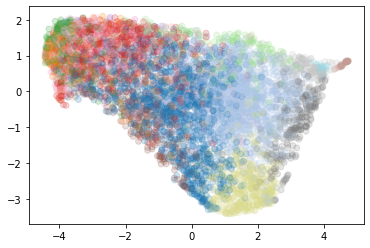

In [262]:
plt.scatter(u[:,0], u[:,1], c=clust_agg, alpha=0.2, cmap='tab20')
plt.show()
plt.close()

In [263]:
# n_clust = np.max(clust_agg) + 1
colors = plt.get_cmap('tab20')(np.linspace(0,1,n_clust))
dict_clust_col = dict(zip(np.arange(n_clust), colors))

Cluster: 0


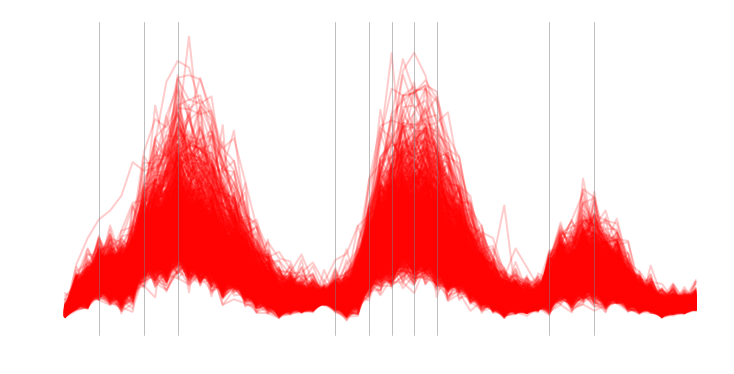

Cluster: 1


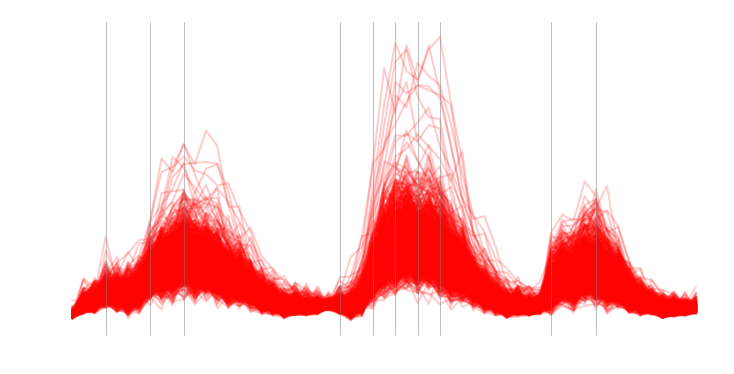

Cluster: 2


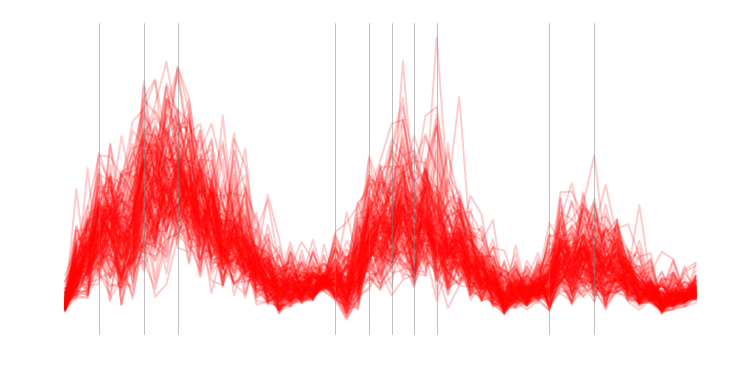

Cluster: 3


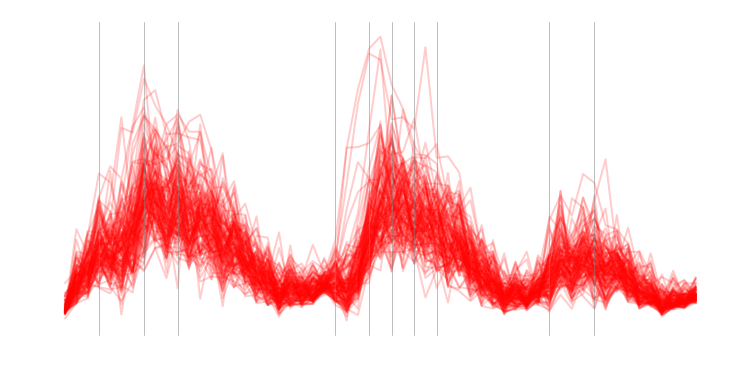

Cluster: 4


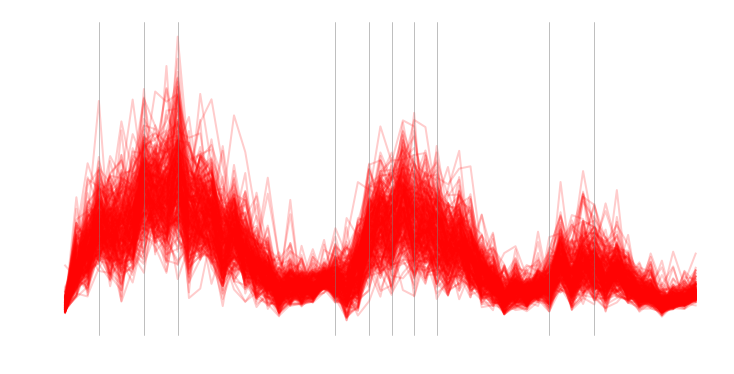

Cluster: 5


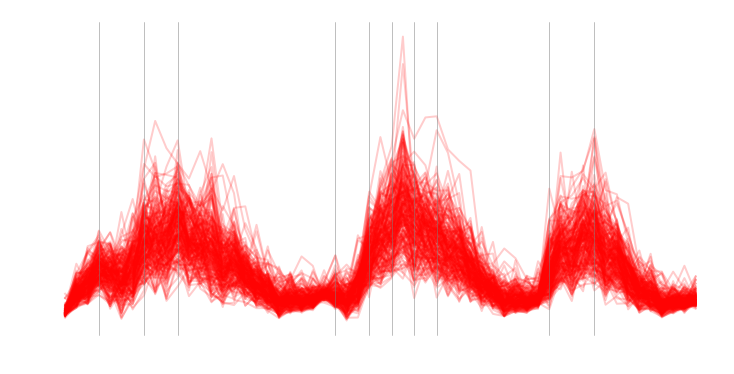

Cluster: 6


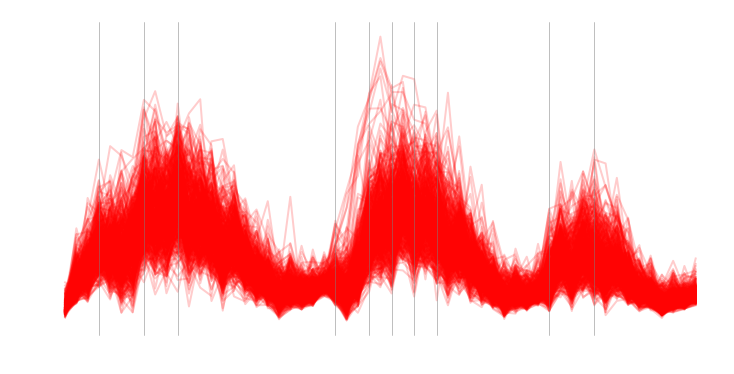

Cluster: 7


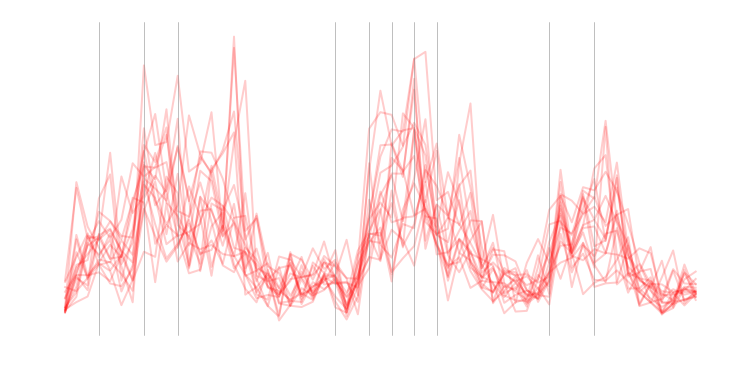

Cluster: 8


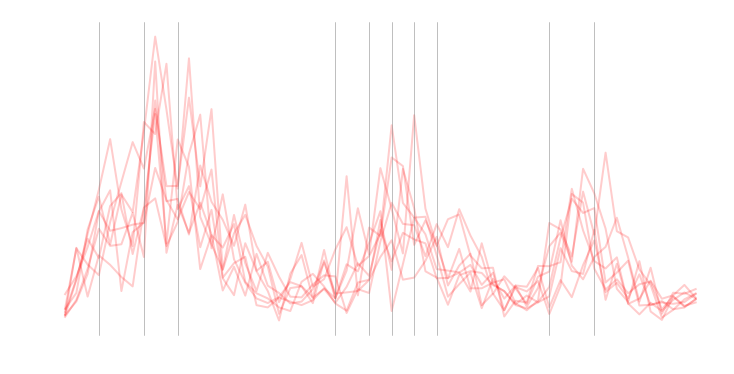

Cluster: 9


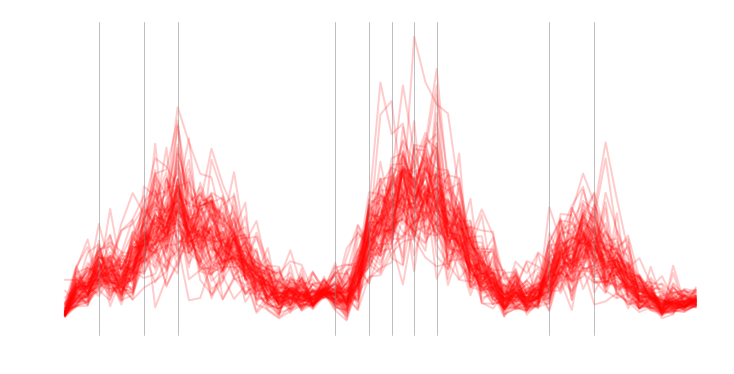

Cluster: 10


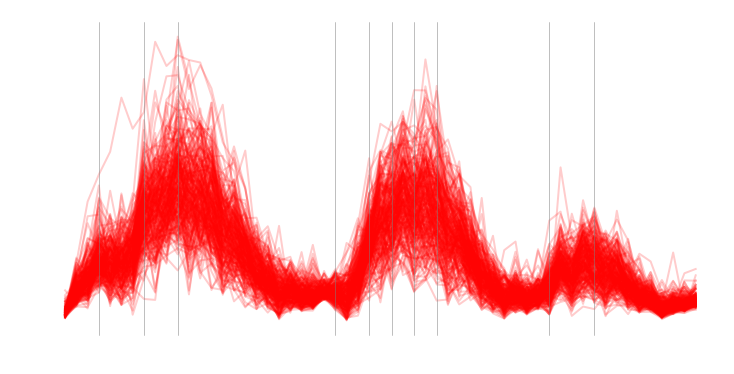

Cluster: 11


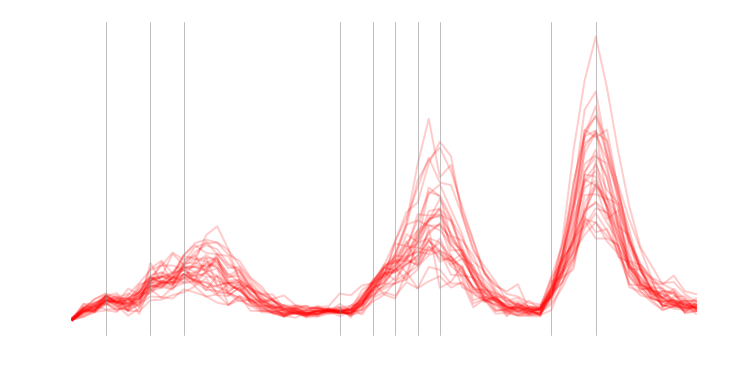

Cluster: 12


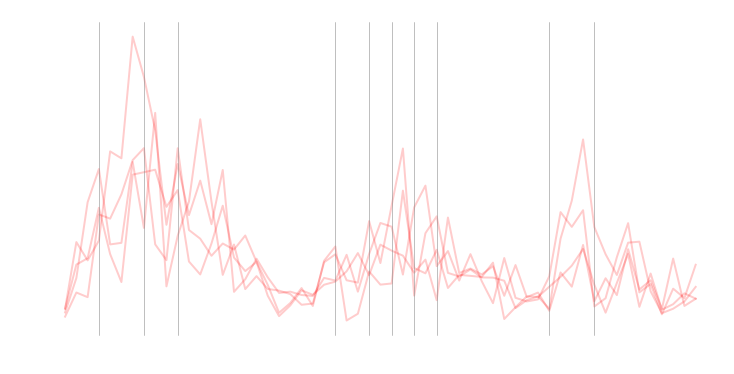

Cluster: 13


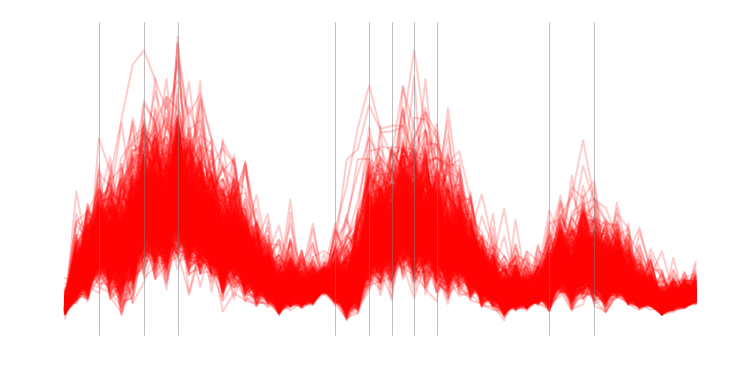

Cluster: 14


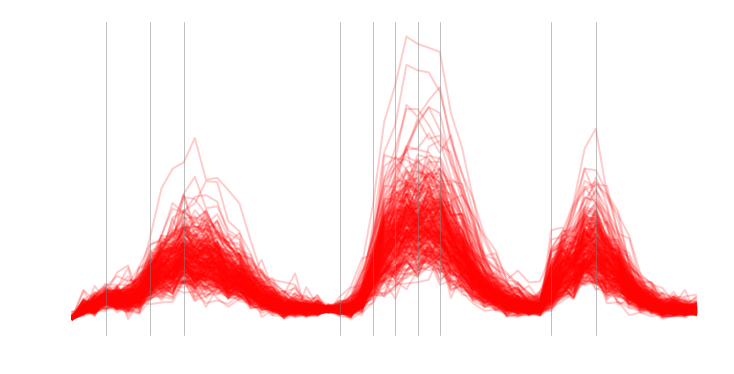

Cluster: 15


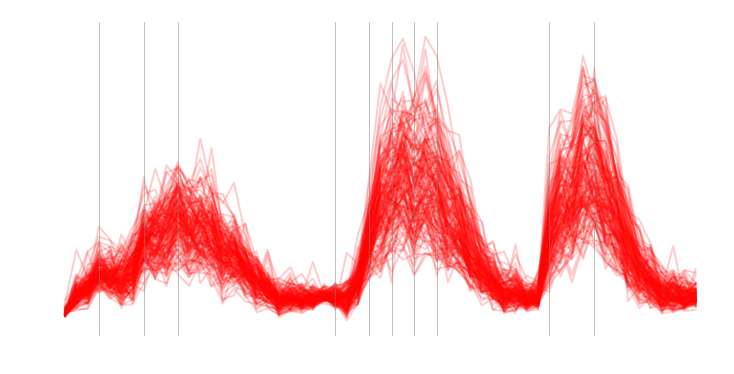

Cluster: 16


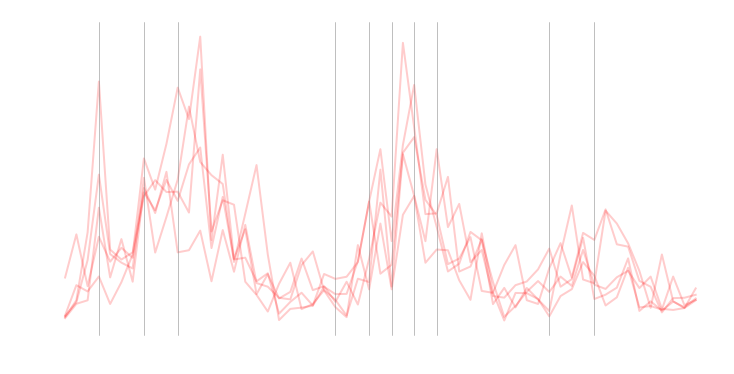

Cluster: 17


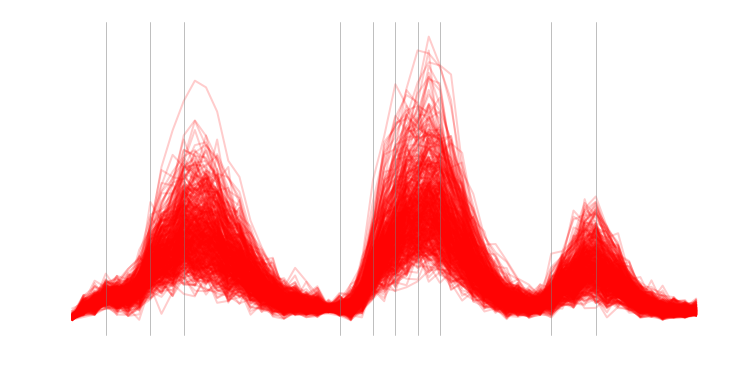

Cluster: 18


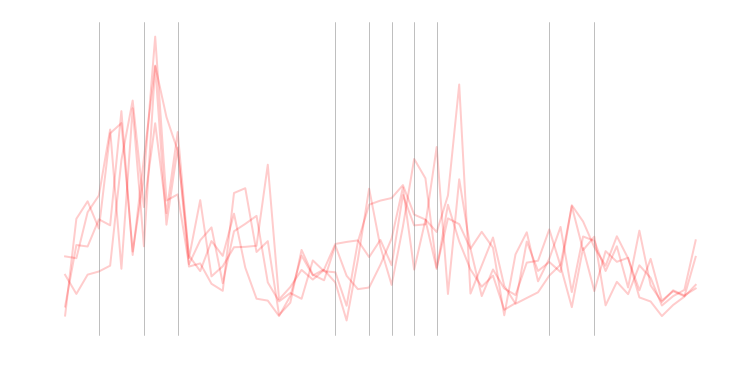

Cluster: 19


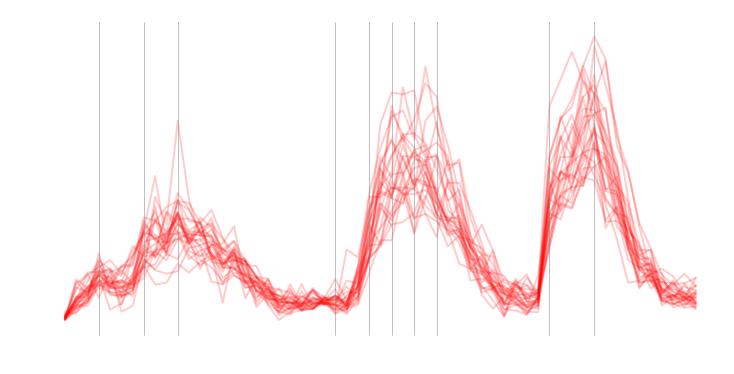

In [271]:
spec_dims = (10,5)


for c in np.unique(clust_agg):
    print('Cluster:', c)
    bool_c = clust_agg == c
    spec_sub = specs_sn_arr[bool_c,:]

    # spec_sub_meansub = spec_sub - specs_med
    # spec_sub_meansub[spec_sub_meansub < 0] = 0

    fig, ax = ip.general_plot(dims=spec_dims, col='w')
    # color = dict_clust_col[c]
    fsi.plot_cell_spectra(ax, spec_sub, {'lw':2,'alpha':0.2,'color':'r'})
    # fsi.plot_cell_spectra(ax, spec_sub, {'lw':2,'alpha':0.2,'color':color})

    ylim = ax.get_ylim()

    xs = [3, 7, 10, 24, 27, 29, 31, 33, 43, 47]
    for x in xs:
        ax.plot([x,x], ylim, color=(0.5,0.5,0.5), lw=0.5)

    # ax.set_ylim(0,1000)
    # ax.set_ylim(0,2**16)
    plt.plot()
    plt.show()
    plt.close()

In [282]:
labels = list(dict_lab_spec.keys())
dict_lab_clust = dict(zip(labels, clust_agg))
len(clust_agg)

6339

### Merge clusters

In [329]:
dict_clust_lab = defaultdict(list)
for lab, cl in dict_lab_clust.items():
    dict_clust_lab[cl].append(lab)

In [330]:
# clusters_tomerge = [[8,11,13,14,15], [2,0,9,3,1,6,12],[10,4,17], [7]]  # fov_05 tile 0
# clusters_tomerge = [[0,1,4,8,11,13], [2,3,12,19], [5,17], [6,7,18], [9,10,14,15,16]]  # fov_05 tile_01
# clusters_tomerge = [[1,7,16,17], [9,0], [18,2,6,8,12,14,19], [3,4,5,11], [13,15]]  # fov_05 tile_03
# clusters_tomerge = [
#     [3, 5, 6, 18],
#     [2, 4, 7, 8, 9, 12, 16],
#     [0, 17, 14]
# ]  # fov_01 tile_02
clusters_tomerge = [
    [0, 14, 17],
    [2, 4, 5, 7, 8, 9, 10, 13, 16],
    [3, 6, 12, 18],
    [15, 19]
] # 2024_01_10_bmgshort_slide_7_fov_01 tile 2

# [5,2,15],
# clusters_tomerge = [
#     [5, 19, 10],
#     [18, 0, 15],
#     [0, 1, 2, 6, 7, 8, 9, 12, 15, 17, 18],
#     [13, 14],
#     [3, 4],
# ]  # 2024_01_07_newplasmidredo2reimage_slide_7_fov_02 tile 1
# clusters_tomerge = [
#     [5, 10, 0, 8]
# ]  # 2024_01_07_newplasmidredo2reimage_slide_7_fov_03 tile 3
# clusters_tomerge = [
#     [6, 12],
#     [9, 4, 0],
# ]  # 2024_01_07_newplasmidredo2reimage_slide_7_fov_03 tile 0
# clusters_tomerge = [
#     [13, 15],
#     [2,16,1]
# ]  # 2024_01_07_newplasmidredo2reimage_slide_7_fov_03 tile 2
dict_lab_clust_new = dict_lab_clust.copy()
for clusts in clusters_tomerge:
    clnew = np.max(list(dict_lab_clust_new.values())) + 1
    dict_clnew_merge[clnew] = clusts
    for cl in clusts:
        for l in dict_clust_lab[cl]:
            dict_lab_clust_new[l] = clnew

Remove clusters

In [331]:
clusters_toremove = []

for cl in clusters_toremove:
    for l in dict_clust_lab[cl]:
        del dict_lab_clust_new[l]

Plot spectra

In [332]:
dict_cl_spec_new = defaultdict(list)
dict_cl_spec_new = defaultdict(list)
for l, cl in dict_lab_clust_new.items():
    spec = dict_lab_spec[l]
    dict_cl_spec_new[cl].append(spec)

In [333]:
clusters_unq_new = list(dict_cl_spec_new.keys())

In [334]:
dict_bc_col_new = dict(zip(clusters_unq_new, plt.get_cmap('tab20').colors))

Cluster: 1


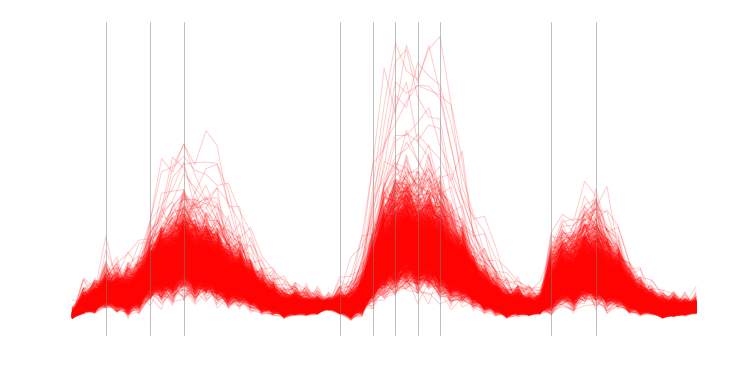

Cluster: 21


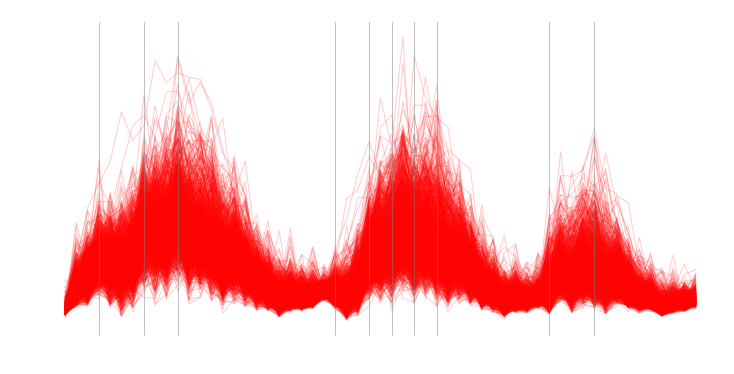

Cluster: 20


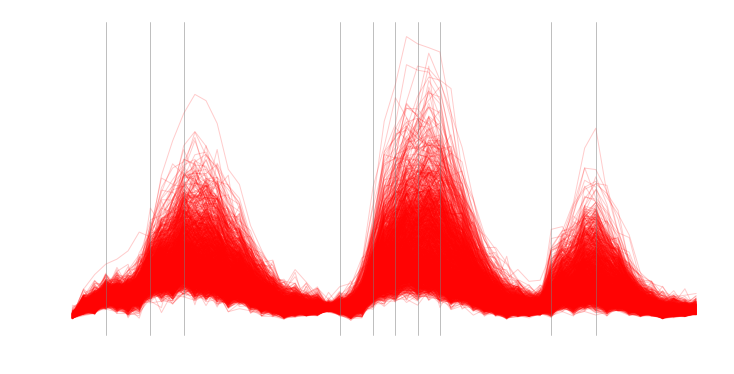

Cluster: 22


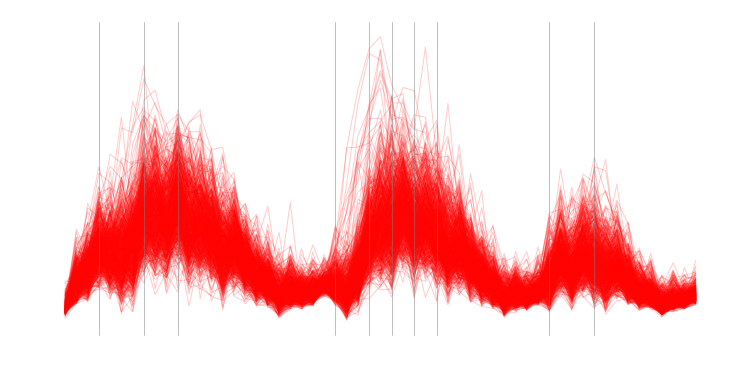

Cluster: 23


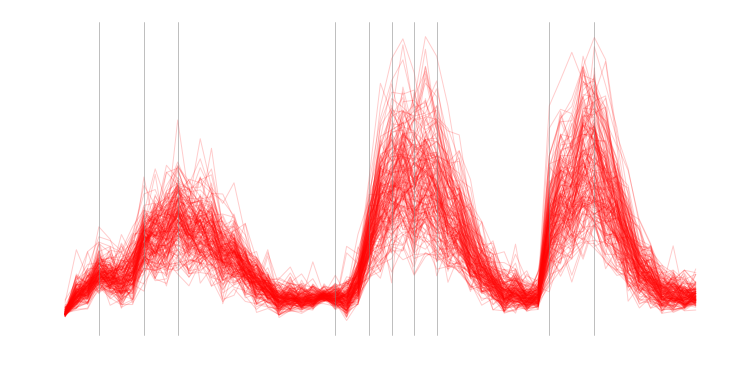

Cluster: 11


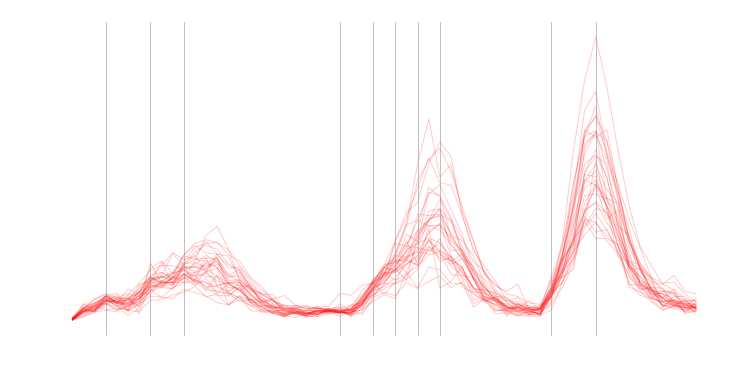

In [335]:
for cl in list(dict_cl_spec_new.keys()):
    print('Cluster:',cl)
    specs_arr = np.array(dict_cl_spec_new[cl])

    fig, ax = ip.general_plot(dims=spec_dims, col='w')
    fsi.plot_cell_spectra(ax, specs_arr, {'lw':1,'alpha':0.2,'color':'r'})
    # fsi.plot_cell_spectra(ax, specs_arr, {'lw':1,'alpha':0.2,'color':dict_bc_col_new[cl]})

    # ax.set_ylim(0,2000)
    ylim = ax.get_ylim()

    xs = [3, 7, 10, 24, 27, 29, 31, 33, 43, 47]
    for x in xs:
        ax.plot([x,x], ylim, color=(0.5,0.5,0.5), lw=0.5)

    plt.show()
    plt.close()

Subcluster

In [227]:
def cluster_spectra(spectra, n_clust=2):
    dist_mat_cond = pdist(spectra, fhc.channel_cosine_intensity_allonev2)
    dist_mat = squareform(dist_mat_cond)
    agg = AgglomerativeClustering(
        n_clusters=n_clust, affinity="precomputed", linkage="complete"
    )
    agg.fit(dist_mat)
    return agg.labels_

In [209]:
dict_clust_lab_new = defaultdict(list)
for l, cl in dict_lab_clust_new.items():
    dict_clust_lab_new[cl].append(l)

In [242]:
target = 23
n_subcl = 4

spec_subcl = dict_cl_spec_new[target]
agg = cluster_spectra(np.array(spec_subcl), n_subcl)
lab_subcl = dict_clust_lab_new[target]
agg_new = agg + np.max(clusters_unq_new) + 1
dict_lab_clust_subcl = dict_lab_clust_new.copy()
del dict_lab_clust_subcl[target]
for l, cl in zip(lab_subcl, agg_new):
    dict_lab_clust_subcl[l] = cl

Plot spectra

In [243]:
dict_cl_spec_subcl = defaultdict(list)
dict_cl_spec_subcl = defaultdict(list)
for l, cl in dict_lab_clust_subcl.items():
    spec = dict_lab_spec[l]
    dict_cl_spec_subcl[cl].append(spec)

In [244]:
clusters_unq_subcl = list(dict_cl_spec_subcl.keys())
clusters_unq_subcl

[22, 24, 16, 20, 11, 25, 28, 27, 26]

In [245]:
# dict_bc_col_subcl = dict(zip(clusters_unq_subcl, plt.get_cmap('tab20').colors))

Cluster: 22


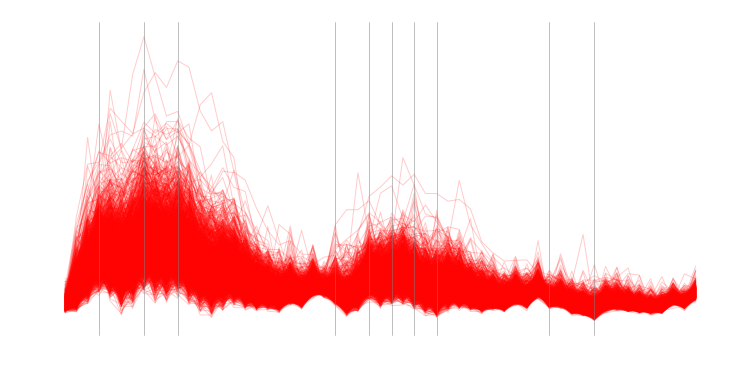

Cluster: 24


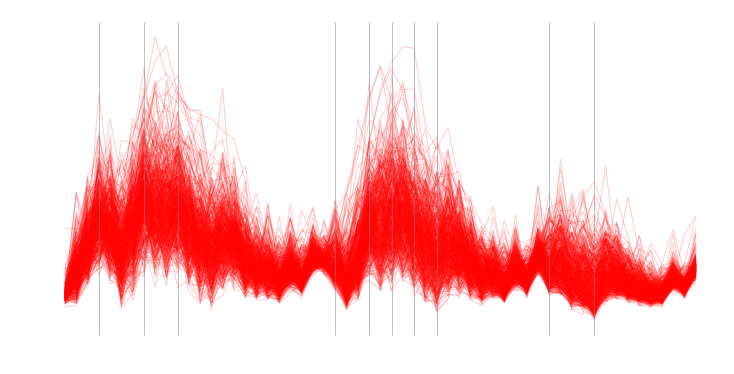

Cluster: 16


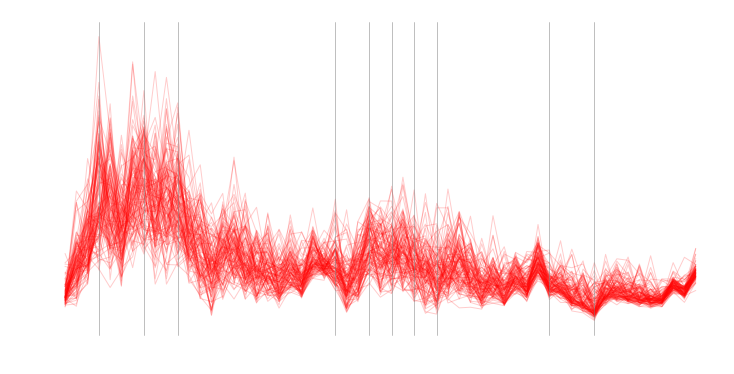

Cluster: 20


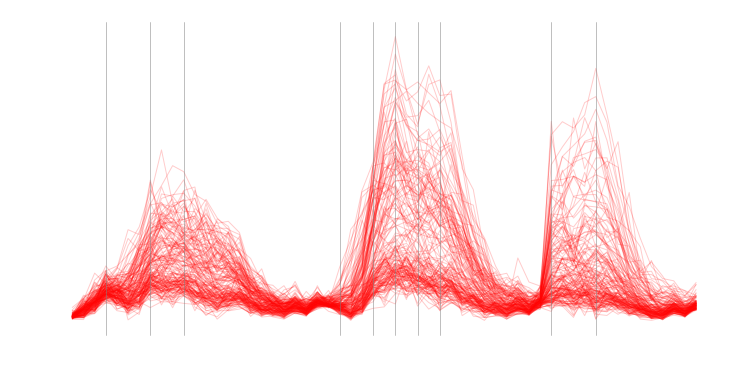

Cluster: 11


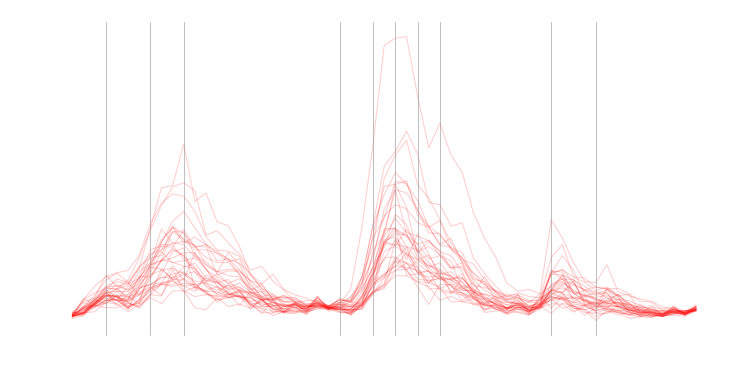

Cluster: 25


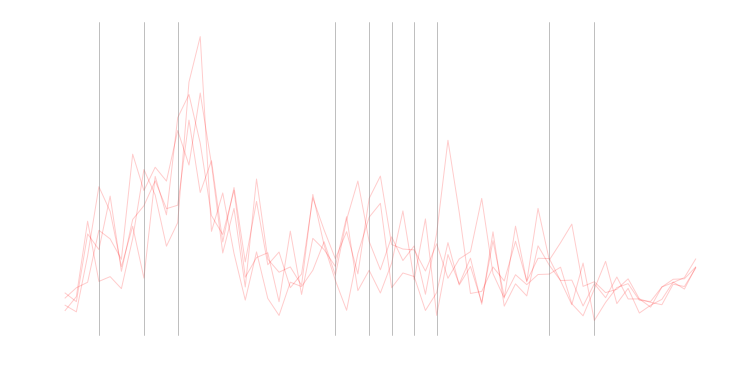

Cluster: 28


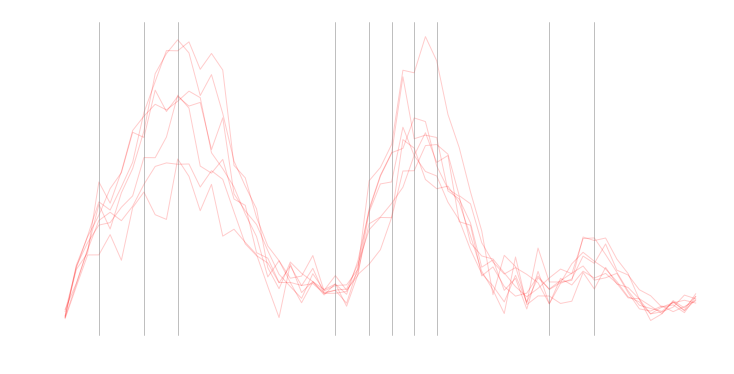

Cluster: 27


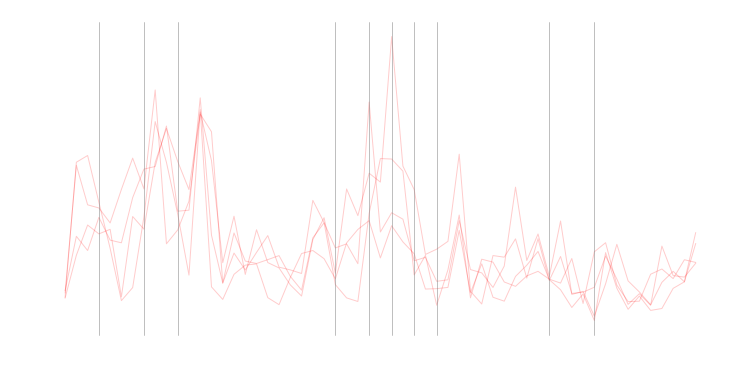

Cluster: 26


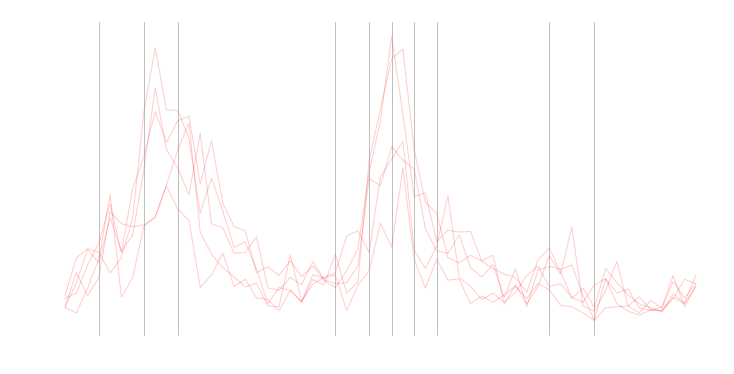

In [246]:
for cl in list(dict_cl_spec_subcl.keys()):
    print('Cluster:',cl)
    specs_arr = np.array(dict_cl_spec_subcl[cl])

    fig, ax = ip.general_plot(dims=spec_dims, col='w')
    fsi.plot_cell_spectra(ax, specs_arr, {'lw':1,'alpha':0.2,'color':'r'})
    # fsi.plot_cell_spectra(ax, specs_arr, {'lw':1,'alpha':0.2,'color':dict_bc_col_new[cl]})

    # ax.set_ylim(0,2000)
    ylim = ax.get_ylim()

    xs = [3, 7, 10, 24, 27, 29, 31, 33, 43, 47]
    for x in xs:
        ax.plot([x,x], ylim, color=(0.5,0.5,0.5), lw=0.5)

    plt.show()
    plt.close()

Cluster: 22


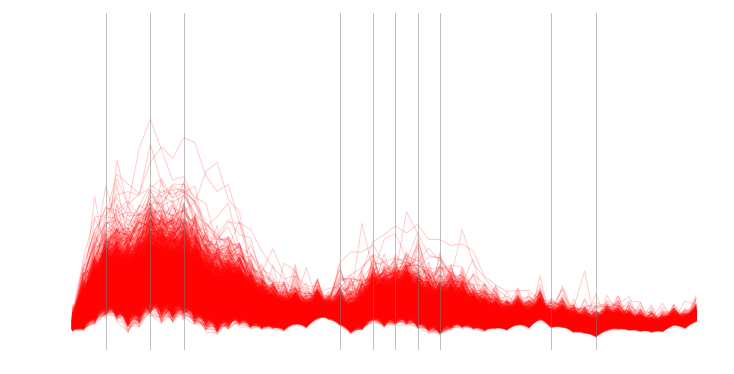

Cluster: 24


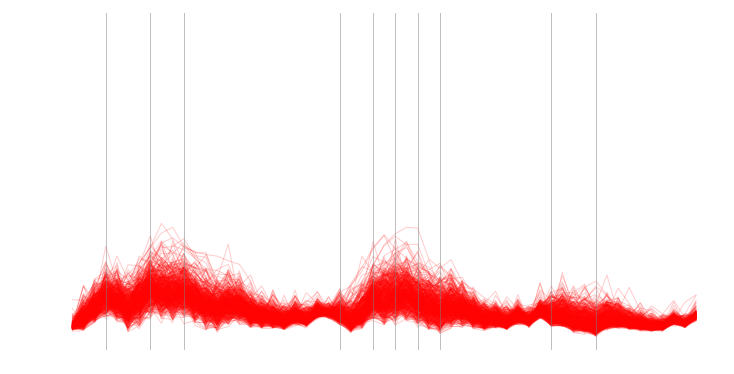

Cluster: 16


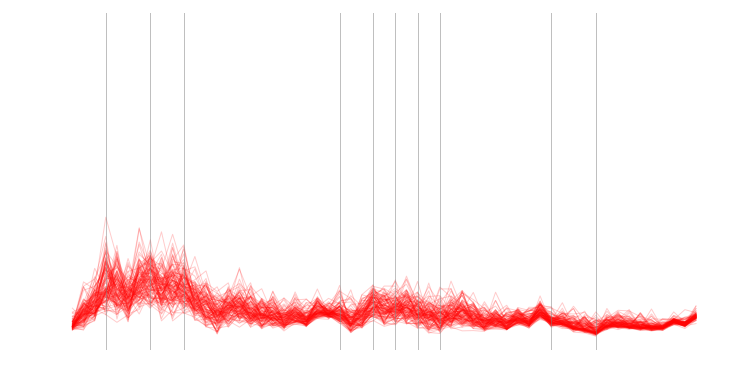

Cluster: 20


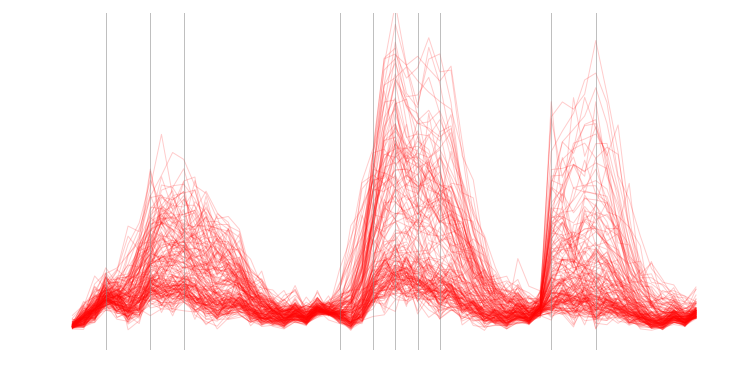

Cluster: 11


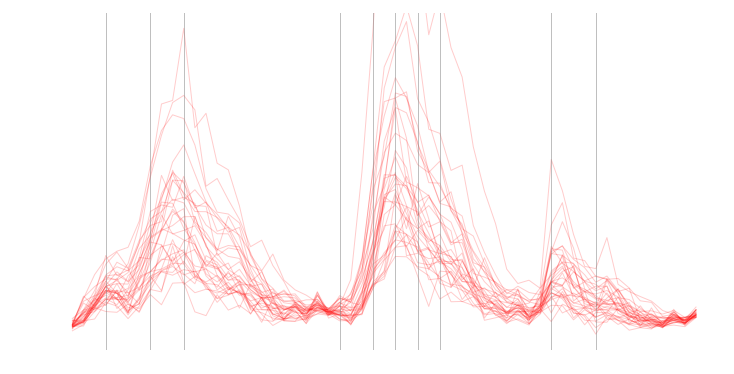

Cluster: 25


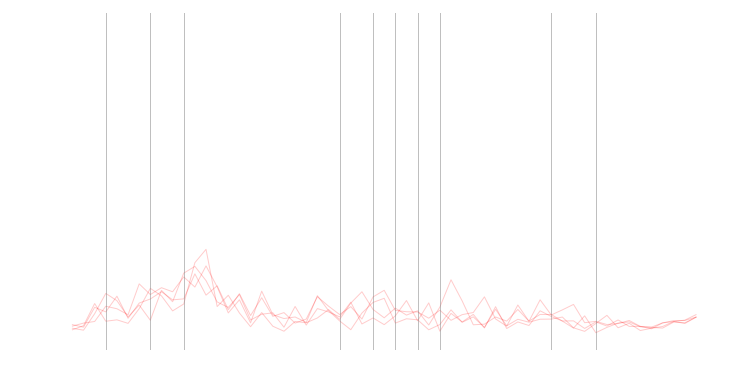

Cluster: 28


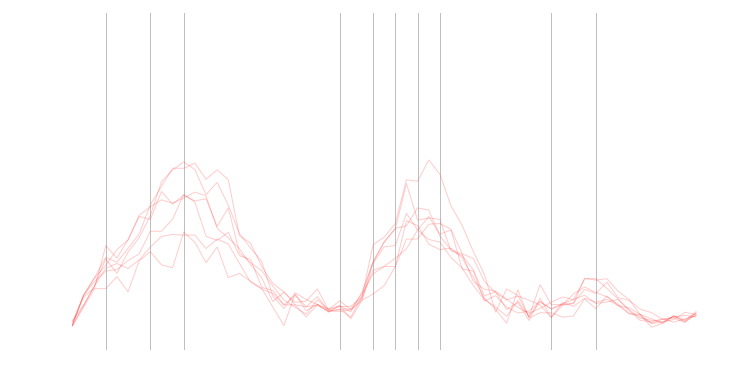

Cluster: 27


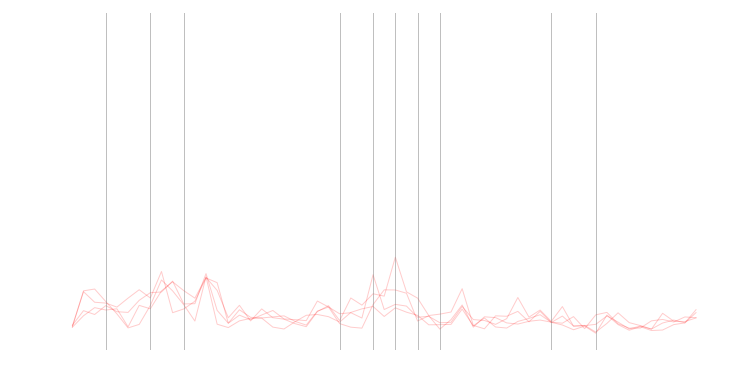

Cluster: 26


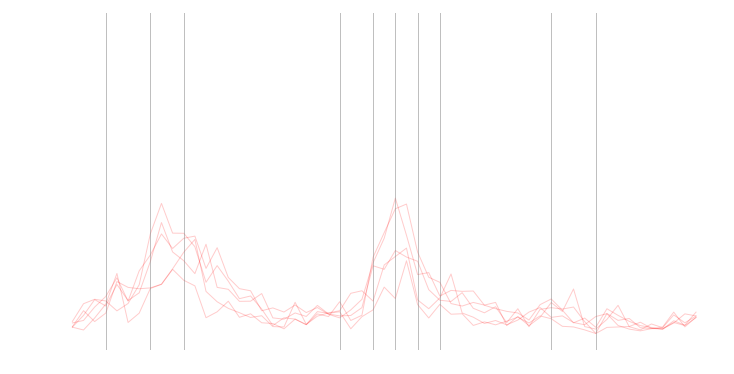

In [247]:
for cl in list(dict_cl_spec_subcl.keys()):
    print('Cluster:',cl)
    specs_arr = np.array(dict_cl_spec_subcl[cl])

    fig, ax = ip.general_plot(dims=spec_dims, col='w')
    fsi.plot_cell_spectra(ax, specs_arr, {'lw':1,'alpha':0.2,'color':'r'})
    # fsi.plot_cell_spectra(ax, specs_arr, {'lw':1,'alpha':0.2,'color':dict_bc_col_new[cl]})

    ax.set_ylim(0,1000)
    ylim = ax.get_ylim()

    xs = [3, 7, 10, 24, 27, 29, 31, 33, 43, 47]
    for x in xs:
        ax.plot([x,x], ylim, color=(0.5,0.5,0.5), lw=0.5)

    plt.show()
    plt.close()

Save Spectra

In [336]:
dict_lab_clust_fin = dict_lab_clust_new

In [337]:
print(len(dict_lab_clust_fin))
print(np.unique(list(dict_lab_clust_fin.values())))

6339
[ 1 11 20 21 22 23]


In [338]:
output_dir = config['output_dir'] + '/' + sn
clust_dir = output_dir + '/clust'

clust_dir_hires = clust_dir + '/merge'
if not os.path.exists(clust_dir_hires):
    os.makedirs(clust_dir_hires)
    print('Made dir:', clust_dir_hires)

In [339]:
# for cl in list(dict_cl_spec_new.keys()):
#     print('Cluster:',cl)
#     specs_arr = np.array(dict_cl_spec_new[cl])

#     fig, ax = ip.general_plot(dims=spec_dims, col='w')
#     fsi.plot_cell_spectra(ax, specs_arr, {'lw':1,'alpha':0.2,'color':dict_bc_col_new[cl]})

#     # ax.set_ylim(0,2000)
#     ylim = ax.get_ylim()

#     xs = [3, 7, 10, 24, 27, 29, 31, 33, 43, 47]
#     for x in xs:
#         ax.plot([x,x], ylim, color=(0.5,0.5,0.5), lw=0.5)

#     plt.show()
#     plt.close()

Save clustering

In [340]:
clust_sn_fn = clust_dir_hires + '/' + sn + '_M_' + str(m_h) + '_clust_merge.yaml'
with open(clust_sn_fn, 'w') as f:
    yaml.dump(dict_lab_clust_fin, f, default_flow_style=False)
print('Wrote:', clust_sn_fn)

Wrote: ../../../outputs/bmg_plasmids_imaging/2024_01_10_bmgshort/2024_01_10_bmgshort_slide_bmg_fov_01/clust/merge/2024_01_10_bmgshort_slide_bmg_fov_01_M_2_clust_merge.yaml


# Pool all spectra

In [ ]:
sns = [
    "2024_01_07_newplasmidredo2reimage_slide_7_fov_01",
    "2024_01_07_newplasmidredo2reimage_slide_7_fov_02",
    "2024_01_07_newplasmidredo2reimage_slide_7_fov_03",
    "2024_01_07_newplasmidredo2reimage_slide_7_fov_04",
    "2024_01_07_newplasmidredo2reimage_slide_bmg_fov_01",
    "2024_01_07_newplasmidredo2reimage_slide_bmg_fov_02",
    "2024_01_07_newplasmidredo2reimage_slide_bmg_fov_03",
]
specs = []
for sn in sns:
    dict_m_fn = spec_fns[sn]
    for m, fn in dict_m_fn.items():
        dict_lab_spec = yaml.unsafe_load(fn)
        specs += [s for s in dict_lab_spec.values()]

specs_sn_arr = np.array(specs)
specs_sn_arr.shape

In [ ]:
a = 1

: 

# Scratch paper zen tile scan 

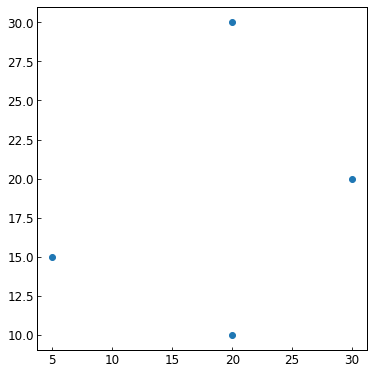

In [18]:

coordinates = np.array([(15, 5), (10, 20), (20, 30), (30, 20)])  # Example coordinates
fig, ax = ip.general_plot(dims=(5,5))
ax.scatter(coordinates[:,1], coordinates[:,0])

In [17]:
mn = np.min(coordinates, axis=0)
mx = np.max(coordinates, axis=0)
mn, mx

(array([10, 10]), array([30, 30]))

In [23]:
def bresenham_line(x0, y0, x1, y1):
    """
    Bresenham's line algorithm
    Returns the indices of the pixels on the line between (x0, y0) and (x1, y1)
    """
    dx = abs(x1 - x0)
    dy = abs(y1 - y0)
    sx = 1 if x0 < x1 else -1
    sy = 1 if y0 < y1 else -1
    err = dx - dy

    line_indices = []

    while (x0, y0) != (x1, y1):
        line_indices.append((x0, y0))
        e2 = 2 * err
        if e2 > -dy:
            err -= dy
            x0 += sx
        if e2 < dx:
            err += dx
            y0 += sy

    line_indices.append((x1, y1))  # Include the end point

    return line_indices


def line_indices_between_points(point1, point2):
    """
    Returns the indices of the pixels on the line between two points in a numpy array
    """
    x0, y0 = point1
    x1, y1 = point2
    line_indices = bresenham_line(x0, y0, x1, y1)
    return np.array(line_indices)


# Example usage:
point1 = (1, 1)
point2 = (6, 4)
line_indices = line_indices_between_points(point1, point2)
line_indices = np.array(line_indices)
print(line_indices)

[[1 1]
 [2 2]
 [3 2]
 [4 3]
 [5 3]
 [6 4]]


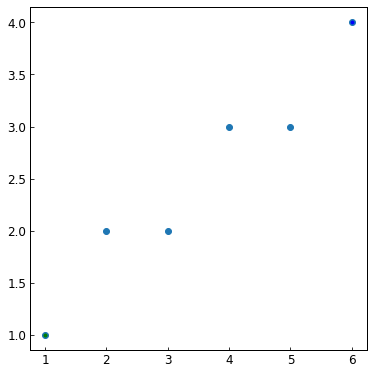

In [25]:
fig, ax = ip.general_plot(dims=(5,5))
ax.plot(point1[0], point1[1], '.g')
ax.plot(point2[0], point2[1], '.b')
ax.scatter(line_indices[:,0], line_indices[:,1])

In [26]:
points = np.array([point1, point2])
mn = np.min(points, axis=0)
mx = np.max(points, axis=0)
mn, mx

(array([1, 1]), array([6, 4]))

In [47]:
arr = np.zeros(mx-mn + 1)
li_adj = line_indices - mn
arr[li_adj[:,0], li_adj[:,1]] = 1
arr

array([[1., 0., 0., 0.],
       [0., 1., 0., 0.],
       [0., 1., 0., 0.],
       [0., 0., 1., 0.],
       [0., 0., 1., 0.],
       [0., 0., 0., 1.]])

In [74]:
tile_dist = 200

coordinates = [
    (1500, 500),
    (1000, 2000),
    (2000, 4000),
    (3000, 2000),
]  # Example coordinates
c_arr = np.array(coordinates)

mn = np.min(c_arr, axis=0)
c_zeroed = c_arr - mn

c_tile = np.ceil(c_zeroed / tile_dist).astype(int)
mx_tile = np.max(c_tile, axis=0)

arr = np.zeros(mx_tile + 1)
ln = c_tile.shape[0]

for i in range(ln):
    p0 = c_tile[i, :]
    i1 = i + 1 if i < ln - 1 else 0
    p1 = c_tile[i1, :]
    li = line_indices_between_points(p0, p1)
    arr[li[:,0], li[:,1]] = 1

arr


array([[0., 0., 0., 0., 0., 0., 0., 1., 1., 1., 0., 0., 0., 0., 0., 0.,
        0., 0., 0.],
       [0., 0., 0., 0., 0., 1., 1., 0., 0., 0., 1., 1., 0., 0., 0., 0.,
        0., 0., 0.],
       [0., 0., 1., 1., 1., 0., 0., 0., 0., 0., 0., 0., 1., 1., 0., 0.,
        0., 0., 0.],
       [1., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 1.,
        0., 0., 0.],
       [0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        1., 1., 0.],
       [0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 1., 1.],
       [0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1.,
        1., 0., 0.],
       [0., 0., 0., 0., 1., 1., 0., 0., 0., 0., 0., 0., 0., 1., 1., 0.,
        0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 1., 1., 0., 0., 0.,
        0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 1., 0., 1., 1., 0., 0., 0., 0., 0.,
        0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0.

(<Figure size 360x208.421 with 1 Axes>,
 <Axes:>,
 [<Figure size 360x36 with 2 Axes>,
  <matplotlib.colorbar.Colorbar at 0x7f22927f8790>])

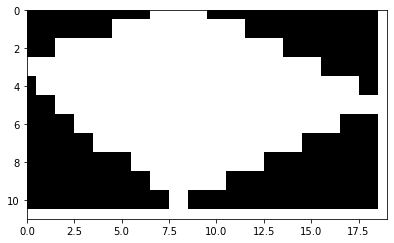

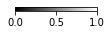

In [75]:
from scipy.ndimage.morphology import binary_fill_holes

arr_fill = binary_fill_holes(arr)
ip.plot_image(arr_fill, cmap='gray', axes_off=False)

In [76]:
coords_tile

array([[1000, 1900],
       [1000, 2100],
       [1000, 2300],
       ...,
       [3000, 4700],
       [3000, 4900],
       [3000, 5100]])

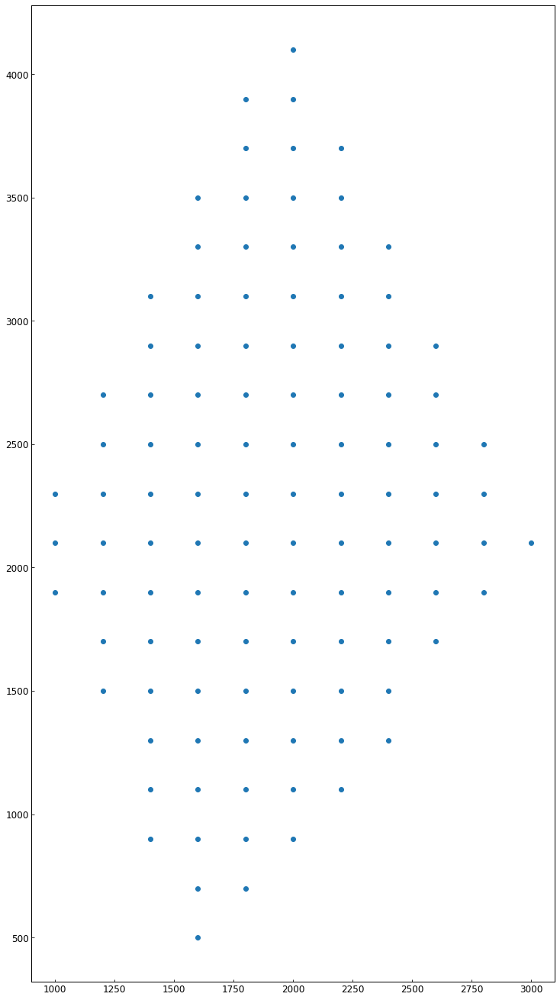

In [79]:
ind = np.where(arr_fill)
ind = np.hstack([ind[0][:,None], ind[1][:,None]])
coords_tile = (ind * tile_dist) + mn
fig, ax = ip.general_plot(dims=(10,18))
ax.scatter(coords_tile[:,0], coords_tile[:,1])

In [80]:
from scipy.ndimage.morphology import binary_fill_holes


def bresenham_line(x0, y0, x1, y1):
    """
    Bresenham's line algorithm
    Returns the indices of the pixels on the line between (x0, y0) and (x1, y1)
    """
    dx = abs(x1 - x0)
    dy = abs(y1 - y0)
    sx = 1 if x0 < x1 else -1
    sy = 1 if y0 < y1 else -1
    err = dx - dy

    line_indices = []

    while (x0, y0) != (x1, y1):
        line_indices.append((x0, y0))
        e2 = 2 * err
        if e2 > -dy:
            err -= dy
            x0 += sx
        if e2 < dx:
            err += dx
            y0 += sy

    line_indices.append((x1, y1))  # Include the end point

    return line_indices


def line_indices_between_points(point1, point2):
    """
    Returns the indices of the pixels on the line between two points in a numpy array
    """
    x0, y0 = point1
    x1, y1 = point2
    line_indices = bresenham_line(x0, y0, x1, y1)
    return np.array(line_indices)


def get_convex_hull(coordinates, tile_dist):
    # Convert coordinates to matrix indices
    c_arr = np.array(coordinates)
    mn = np.min(c_arr, axis=0)
    c_zeroed = c_arr - mn
    c_tile = np.ceil(c_zeroed / tile_dist).astype(int)

    # Get a matrix
    mx_tile = np.max(c_tile, axis=0)
    arr = np.zeros(mx_tile + 1)

    # Get lines between matrix indices and add to matrix
    ln = c_tile.shape[0]
    for i in range(ln):
        p0 = c_tile[i, :]
        i1 = i + 1 if i < ln - 1 else 0
        p1 = c_tile[i1, :]
        li = line_indices_between_points(p0, p1)
        arr[li[:, 0], li[:, 1]] = 1

    # Fill within the edges
    arr_fill = binary_fill_holes(arr)

    # Convert back to real coordinates
    ind = np.where(arr_fill)
    ind = np.hstack([ind[0][:,None], ind[1][:,None]])
    coords_tile = (ind * tile_dist) + mn

    return coords_tile




In [91]:
f = open("positionlist_relative.pos", "rb")
lines = f.readlines()
for l in lines:
    print(l)

b'Carl Zeiss LSM 510 - Position list file - Version = 1.000\r\n'
b'BEGIN PositionList Version = 10001\r\n'
b'\tBEGIN  10001\r\n'
b'\t\tRelativePositions = 1\r\n'
b'\t\tReferenceX = -0.000 \xb5m\r\n'
b'\t\tReferenceY = -0.000 \xb5m\r\n'
b'\t\tReferenceZ = -0.000 \xb5m\r\n'
b'\tEND\r\n'
b'\tNumberPositions = 84\r\n'
b'\tBEGIN Position1 Version = 10001\r\n'
b'\t\tX = -6650.935 \xb5m\r\n'
b'\t\tY = 1911.653 \xb5m\r\n'
b'\t\tZ = -364.336 \xb5m\r\n'
b'\tEND\r\n'
b'\tBEGIN Position2 Version = 10001\r\n'
b'\t\tX = -6438.387 \xb5m\r\n'
b'\t\tY = 1911.653 \xb5m\r\n'
b'\t\tZ = -364.336 \xb5m\r\n'
b'\tEND\r\n'
b'\tBEGIN Position3 Version = 10001\r\n'
b'\t\tX = -6438.387 \xb5m\r\n'
b'\t\tY = 2124.201 \xb5m\r\n'
b'\t\tZ = -364.336 \xb5m\r\n'
b'\tEND\r\n'
b'\tBEGIN Position4 Version = 10001\r\n'
b'\t\tX = -6650.935 \xb5m\r\n'
b'\t\tY = 2124.201 \xb5m\r\n'
b'\t\tZ = -364.336 \xb5m\r\n'
b'\tEND\r\n'
b'\tBEGIN Position5 Version = 10001\r\n'
b'\t\tX = -5820.965 \xb5m\r\n'
b'\t\tY = 1859.517 \xb5m\r\n'
b'

In [133]:
def parse_convex_hull_relative_pos_list_xy(fn):
    f = open(fn, "rb")
    lines = f.readlines()
    coordinates = []
    i = 0
    c = [0, 0]
    for l in lines:
        val = re.findall(b"(?<=[XY]\s\=\s)[\-0-9\.]+", l)
        if b"X =" in l:
            c[0] = float(val[0])
            i += 1
        elif b"Y =" in l:
            c[1] = float(val[0])
            i += 1
        if i == 2:
            coordinates.append(c)
            i = 0
            c = [0, 0]
    return coordinates[1:]


fn = "positionlist_relative.pos"
pos_list_convexhull = parse_convex_hull_relative_pos_list_xy(fn)
pos_list_convexhull

[[-6650.935, 1911.653],
 [-6438.387, 1911.653],
 [-6438.387, 2124.201],
 [-6650.935, 2124.201],
 [-5820.965, 1859.517],
 [-5608.417, 1859.517],
 [-5608.417, 2072.065],
 [-5820.965, 2072.065],
 [-5409.279, 1542.155],
 [-5196.731, 1542.155],
 [-5196.731, 1754.703],
 [-5409.279, 1754.703],
 [-4965.072, 686.284],
 [-4752.524, 686.284],
 [-4752.524, 898.832],
 [-4965.072, 898.832],
 [-4967.031, 209.808],
 [-4754.483, 209.808],
 [-4754.483, 422.356],
 [-4967.031, 422.356],
 [-5098.601, 46.017],
 [-4886.053, 46.017],
 [-4886.053, 258.565],
 [-5098.601, 258.565],
 [-5204.837, -131.707],
 [-4992.289, -131.707],
 [-4992.289, 80.841],
 [-5204.837, 80.841],
 [-5371.821, -382.488],
 [-5159.273, -382.488],
 [-5159.273, -169.94],
 [-5371.821, -169.94],
 [-5584.976, -561.945],
 [-5372.428, -561.945],
 [-5372.428, -349.397],
 [-5584.976, -349.397],
 [-5839.789, -561.945],
 [-5627.241, -561.945],
 [-5627.241, -349.397],
 [-5839.789, -349.397],
 [-6188.231, -561.94],
 [-5975.683, -561.94],
 [-5975.683, -

In [119]:
def parse_relative_pos_list_xyz(fn):
    f = open(fn, "rb")
    lines = f.readlines()
    coordinates = []
    i = 0
    c = [0, 0, 0]
    for l in lines:
        val = re.findall(b"(?<=[XYZ]\s\=\s)[\-0-9\.]+", l)
        if b"X =" in l:
            c[0] = float(val[0])
            i += 1
        elif b"Y =" in l:
            c[1] = float(val[0])
            i += 1
        elif b"Z =" in l:
            # print(l)
            c[2] = float(val[0])
            i += 1
        if i == 3:
            coordinates.append(c)
            i = 0
            c = [0, 0, 0]
    return coordinates[1:]


fn = "inputposition_test_relative2_relative.pos"
support_points = parse_relative_pos_list_xyz(fn)
support_points

[[-6571.535, 1541.759, 0.0], [-6522.936, 1687.297, 3.0]]

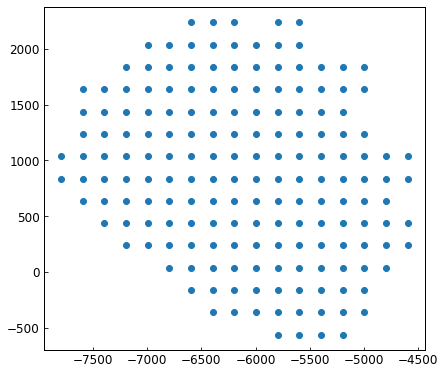

In [134]:
tile_dist = 200

convex_hull_coords = get_convex_hull(pos_list_convexhull, tile_dist)

mn = (np.min(np.array(convex_hull_coords), axis=0))
mx = (np.max(np.array(convex_hull_coords), axis=0))

dims = ((mx - mn) // 500).tolist()

fig, ax = ip.general_plot(dims=dims)
ax.scatter(np.array(convex_hull_coords)[:,0], np.array(convex_hull_coords)[:,1])

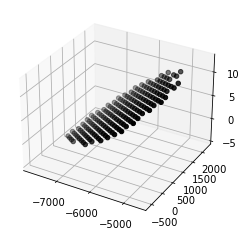

In [137]:
# define plane from 3 coordinates with z
def get_xyz_convexhull(support_points, convex_hull_coords):
    # calculate normal vector
    sp = [np.array(s) for s in support_points]
    v1 = sp[1] - sp[0]
    v2 = sp[2] - sp[0]
    nv = np.cross(v1, v2, axisa=-1, axisb=-1, axisc=-1, axis=None)

    # return z for given x,y
    coords = []
    for X, Y in convex_hull_coords:
        Z = (
            nv[0] * sp[0][0]
            + nv[1] * sp[0][1]
            + nv[2] * sp[0][2]
            - nv[0] * X
            - nv[1] * Y
        ) / nv[2]
        coords.append([X, Y, Z])

    return coords


support_points = [
    [-7071.535, 1541.759, 0.0],
    [-6522.936, 1687.297, 3.0],
    [-6022.936, 1000.297, 5.0],
]

xyz = get_xyz_convexhull(support_points, convex_hull_coords)
xyz = np.array(xyz)

fig = plt.figure()
ax = fig.add_subplot(projection="3d")
ax.scatter(xyz[:,0], xyz[:,1], xyz[:,2], color='k')



In [153]:
def get_pos_file_lines(xyz):
    lines = [
        b"Carl Zeiss LSM 510 - Position list file - Version = 1.000\r\n",
        b"BEGIN PositionList Version = 10001\r\n",
        b"\tBEGIN  10001\r\n",
        b"\t\tRelativePositions = 1\r\n",
        b"\t\tReferenceX = -0.000 \xb5m\r\n",
        b"\t\tReferenceY = -0.000 \xb5m\r\n",
        b"\t\tReferenceZ = -0.000 \xb5m\r\n",
        b"\tEND\r\n",
        b"\tNumberPositions = " + bytes(str(len(xyz)), "utf-8") + b"\r\n"
    ]
    for i, c in enumerate(xyz):
        lines += [
            b"\tBEGIN Position" + bytes(str(i), "utf-8") + b" Version = 10001\r\n",
            b"\t\tX = " + bytes(str(c[0]), "utf-8") + b" \xb5m\r\n",
            b"\t\tY = " + bytes(str(c[1]), "utf-8") + b" \xb5m\r\n",
            b"\t\tZ = " + bytes(str(c[2]), "utf-8") + b" \xb5m\r\n",
            b"\tEND\r\n"
        ]
    return lines

    

[b'Carl Zeiss LSM 510 - Position list file - Version = 1.000\r\n',
 b'BEGIN PositionList Version = 10001\r\n',
 b'\tBEGIN  10001\r\n',
 b'\t\tRelativePositions = 1\r\n',
 b'\t\tReferenceX = -0.000 \xb5m\r\n',
 b'\t\tReferenceY = -0.000 \xb5m\r\n',
 b'\t\tReferenceZ = -0.000 \xb5m\r\n',
 b'\tEND\r\n',
 b'\tNumberPositions = 176\r\n',
 b'\tBEGIN Position0 Version = 10001\r\n',
 b'\t\tX = -7797.244 \xb5m\r\n',
 b'\t\tY = 838.055 \xb5m\r\n',
 b'\t\tZ = -4.426436719914698 \xb5m\r\n',
 b'\tEND\r\n',
 b'\tBEGIN Position1 Version = 10001\r\n',
 b'\t\tX = -7797.244 \xb5m\r\n',
 b'\t\tY = 1038.0549999999998 \xb5m\r\n',
 b'\t\tZ = -4.2472768552826485 \xb5m\r\n',
 b'\tEND\r\n',
 b'\tBEGIN Position2 Version = 10001\r\n',
 b'\t\tX = -7597.244 \xb5m\r\n',
 b'\t\tY = 638.055 \xb5m\r\n',
 b'\t\tZ = -3.5594309305423133 \xb5m\r\n',
 b'\tEND\r\n',
 b'\tBEGIN Position3 Version = 10001\r\n',
 b'\t\tX = -7597.244 \xb5m\r\n',
 b'\t\tY = 838.055 \xb5m\r\n',
 b'\t\tZ = -3.380271065910263 \xb5m\r\n',
 b'\tEND\r\